In [1]:
import numpy as np
import pandas as pd
import time
# plots
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

C:\Users\anshi\AppData\Local\Temp\ipykernel_15728\3560436066.py:2: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [2]:
data_path= 'C:/Users/anshi/Downloads/depression/data/'

In [3]:
score= pd.read_csv(data_path + 'scores.csv')

contains the following columns; number (patient identifier), days (number of days of measurements), gender (1 or 2 for female or male), age (age in age groups), afftype (1: bipolar II, 2: unipolar depressive, 3: bipolar I), melanch (1: melancholia, 2: no melancholia), inpatient (1: inpatient, 2: outpatient), edu (education grouped in years), marriage (1: married or cohabiting, 2: single), work (1: working or studying, 2: unemployed/sick leave/pension), madrs1 (MADRS score when measurement started), madrs2 (MADRS when measurement stopped).


In [4]:
score

,number,days,gender,age,afftype,melanch,inpatient,edu,marriage,work,madrs1,madrs2
0,condition_1,11,2,35-39,2.0,2.0,2.0,6-10,1.0,2.0,19.0,19.0
1,condition_2,18,2,40-44,1.0,2.0,2.0,6-10,2.0,2.0,24.0,11.0
2,condition_3,13,1,45-49,2.0,2.0,2.0,6-10,2.0,2.0,24.0,25.0
3,condition_4,13,2,25-29,2.0,2.0,2.0,11-15,1.0,1.0,20.0,16.0
4,condition_5,13,2,50-54,2.0,2.0,2.0,11-15,2.0,2.0,26.0,26.0
5,condition_6,7,1,35-39,2.0,2.0,2.0,6-10,1.0,2.0,18.0,15.0
6,condition_7,11,1,20-24,1.0,NaN,2.0,11-15,2.0,1.0,24.0,25.0
7,condition_8,5,2,25-29,2.0,NaN,2.0,11-15,1.0,2.0,20.0,16.0
8,condition_9,13,2,45-49,1.0,NaN,2.0,6-10,1.0,2.0,26.0,26.0
9,condition_10,9,2,45-49,2.0,2.0,2.0,6-10,1.0,2.0,28.0,21.0


CLEANING of scores.csv

data is replete with both NaN values + empty cells. Moreover, need to identify and remove any non-sensical values across columns. control rows have empty columns except for id, days, gender and age. therefore its apt to split the score df between condition and control.


In [5]:
score = score.replace(' ', np.nan)
score.replace('NaN', np.nan, inplace=True)


In [6]:
score.drop(['melanch', 'afftype'], axis=1)

,number,days,gender,age,inpatient,edu,marriage,work,madrs1,madrs2
0,condition_1,11,2,35-39,2.0,6-10,1.0,2.0,19.0,19.0
1,condition_2,18,2,40-44,2.0,6-10,2.0,2.0,24.0,11.0
2,condition_3,13,1,45-49,2.0,6-10,2.0,2.0,24.0,25.0
3,condition_4,13,2,25-29,2.0,11-15,1.0,1.0,20.0,16.0
4,condition_5,13,2,50-54,2.0,11-15,2.0,2.0,26.0,26.0
5,condition_6,7,1,35-39,2.0,6-10,1.0,2.0,18.0,15.0
6,condition_7,11,1,20-24,2.0,11-15,2.0,1.0,24.0,25.0
7,condition_8,5,2,25-29,2.0,11-15,1.0,2.0,20.0,16.0
8,condition_9,13,2,45-49,2.0,6-10,1.0,2.0,26.0,26.0
9,condition_10,9,2,45-49,2.0,6-10,1.0,2.0,28.0,21.0


In [8]:
score[['start_age', 'end_age']]=score['age'].str.extract(r'(\d+)-(\d+)').astype(int)
score[['start_edu', 'end_edu']]=score['edu'].str.extract(r'(\d+)-(\d+)').astype('Int64')


In [9]:
score['avg_age']=score[['start_age', 'end_age']].mean(axis=1)
score['avg_age']=score['avg_age'].astype(int)

In [10]:
score['avg_edu']=score[['start_edu', 'end_edu']].mean(axis=1)
score['avg_edu']=score['avg_edu'].astype('Int64')

In [11]:
score['avg_madrs'] = score[['madrs1', 'madrs2']].mean(axis=1)

In [12]:
score['delta_madrs'] = score['madrs2'] - score['madrs1']

In [13]:
score_condition = score[score.number.str.contains('condition')].copy()
score_control = score[score.number.str.contains('control')].copy()

In [128]:
score_control

,number,days,gender,age,afftype,melanch,inpatient,edu,marriage,work,madrs1,madrs2,start_age,end_age,avg_age,start_edu,end_edu,avg_edu,avg_madrs,delta_madrs
23,control_1,8,2,25-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25,29,27,<NA>,<NA>,<NA>,NaN,NaN
24,control_2,20,1,30-34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30,34,32,<NA>,<NA>,<NA>,NaN,NaN
25,control_3,12,2,30-34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30,34,32,<NA>,<NA>,<NA>,NaN,NaN
26,control_4,13,1,25-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25,29,27,<NA>,<NA>,<NA>,NaN,NaN
27,control_5,13,1,30-34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30,34,32,<NA>,<NA>,<NA>,NaN,NaN
28,control_6,13,1,25-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25,29,27,<NA>,<NA>,<NA>,NaN,NaN
29,control_7,13,1,20-24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20,24,22,<NA>,<NA>,<NA>,NaN,NaN
30,control_8,13,2,40-44,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40,44,42,<NA>,<NA>,<NA>,NaN,NaN
31,control_9,13,2,30-34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30,34,32,<NA>,<NA>,<NA>,NaN,NaN
32,control_10,8,1,30-34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30,34,32,<NA>,<NA>,<NA>,NaN,NaN


gender,avg_edu,  afftype, melanch, inpatient, marriage, work considered categorical. 
avg_age, avg_madrs, delta_madrs, madrs1 and madrs2 considered continuous 

**I noticed a small issue: there was a difference between the number of days in the "score.csv" file and the actual days recorded in the "control" and "condition" files. The latter files had more reported days than indicated in the "days" column of the "scores.csv" file. Upon reviewing the original paper, I discovered that the authors selected only the first n days as specified in the "days" column, but they didn't explain why. Therefore, I decided to exclude days based on my own reasoning, which I have detailed below.

In [14]:
score_condition.melanch = score_condition.melanch.astype('category')
score_condition.gender = score_condition.gender.astype('category')
score_condition.afftype = score_condition.afftype.astype('category')
score_condition.inpatient = score_condition.inpatient.astype('category')
score_condition.marriage = score_condition.marriage.astype('category')
score_condition.work = score_condition.work.astype('category')
score_condition.avg_edu = score_condition.avg_edu.astype('category')


In [15]:
feature_cont = ['avg_age', 'madrs1', 'madrs2', 'avg_madrs',
                'delta_madrs']

feature_cat = ['gender', 'afftype','avg_edu', 'melanch', 'inpatient', 'marriage', 'work']

In [16]:
score_condition[feature_cont].describe()

,avg_age,madrs1,madrs2,avg_madrs,delta_madrs
count,23.000000,23.000000,23.000000,23.000000,23.000000
mean,43.086957,22.739130,20.000000,21.369565,-2.739130
std,11.277141,4.797892,4.729021,4.330697,3.968253
min,22.000000,13.000000,11.000000,15.000000,-13.000000
25%,37.000000,18.500000,16.000000,17.000000,-5.000000
50%,42.000000,24.000000,21.000000,23.500000,-3.000000
75%,49.500000,26.000000,24.500000,24.500000,0.000000
max,67.000000,29.000000,28.000000,28.500000,4.000000


In [22]:
score_condition[feature_cat].describe()

,gender,afftype,avg_edu,melanch,inpatient,marriage,work
count,23,23.0,22,20.0,23.0,23.0,23.0
unique,2,3.0,3,2.0,2.0,2.0,2.0
top,2,2.0,8,2.0,2.0,2.0,2.0
freq,13,15.0,12,19.0,18.0,12.0,20.0


In [17]:
score_control[feature_cont].describe()

,avg_age,madrs1,madrs2,avg_madrs,delta_madrs
count,32.000000,0.0,0.0,0.0,0.0
mean,38.406250,NaN,NaN,NaN,NaN
std,12.714887,NaN,NaN,NaN,NaN
min,22.000000,NaN,NaN,NaN,NaN
25%,27.000000,NaN,NaN,NaN,NaN
50%,37.000000,NaN,NaN,NaN,NaN
75%,48.250000,NaN,NaN,NaN,NaN
max,67.000000,NaN,NaN,NaN,NaN


In [21]:
score_control[feature_cat].describe()

,gender,afftype,avg_edu,melanch,inpatient,marriage,work
count,32.000000,0.0,0.0,0.0,0.0,0.0,0.0
mean,1.375000,NaN,<NA>,NaN,NaN,NaN,NaN
std,0.491869,NaN,<NA>,NaN,NaN,NaN,NaN
min,1.000000,NaN,<NA>,NaN,NaN,NaN,NaN
25%,1.000000,NaN,<NA>,NaN,NaN,NaN,NaN
50%,1.000000,NaN,<NA>,NaN,NaN,NaN,NaN
75%,2.000000,NaN,<NA>,NaN,NaN,NaN,NaN
max,2.000000,NaN,<NA>,NaN,NaN,NaN,NaN


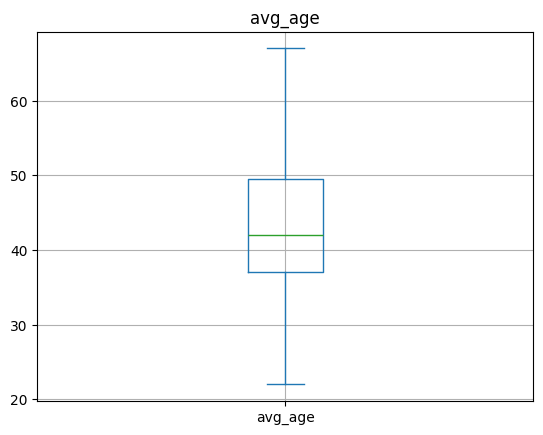

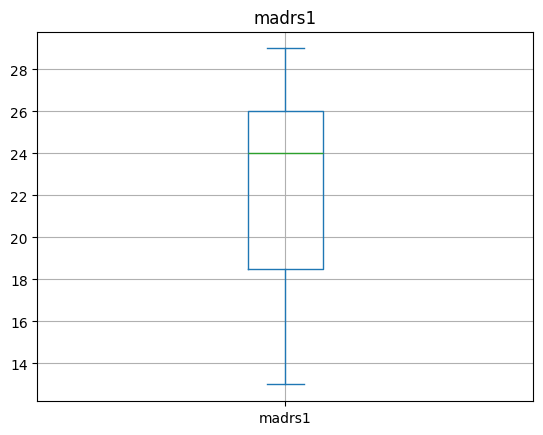

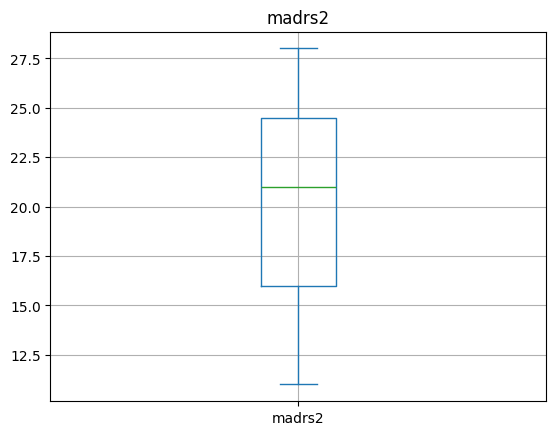

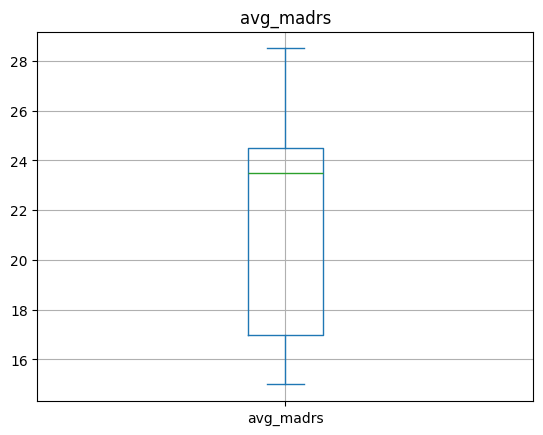

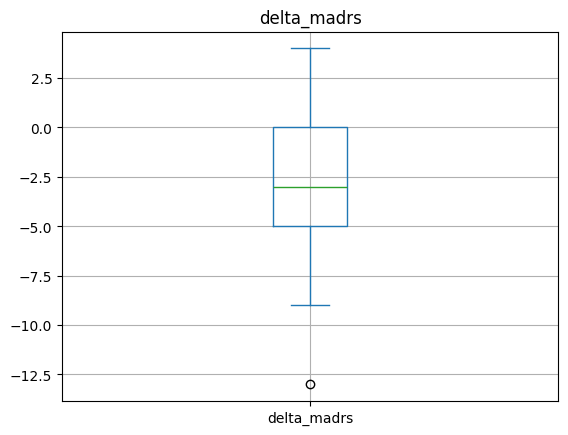

In [308]:
for f in feature_cont:
    score_condition[f].plot(kind='box')
    plt.title(f)
    plt.grid()
    plt.show()


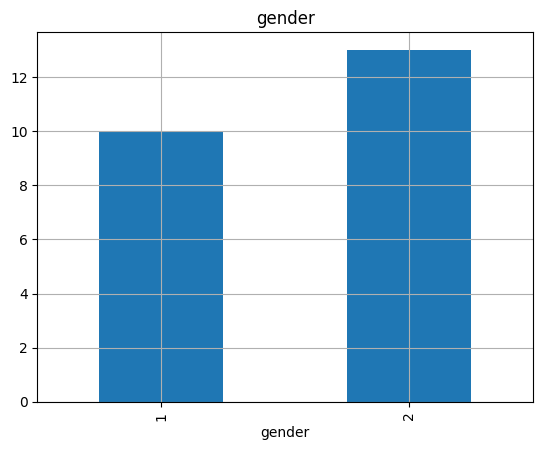

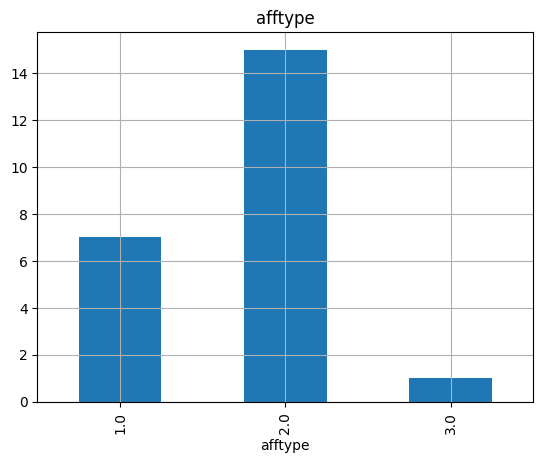

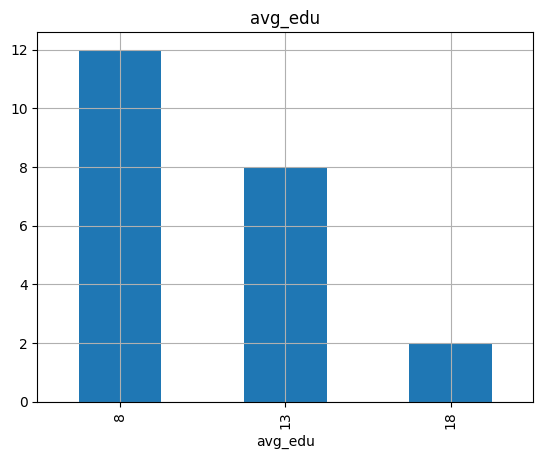

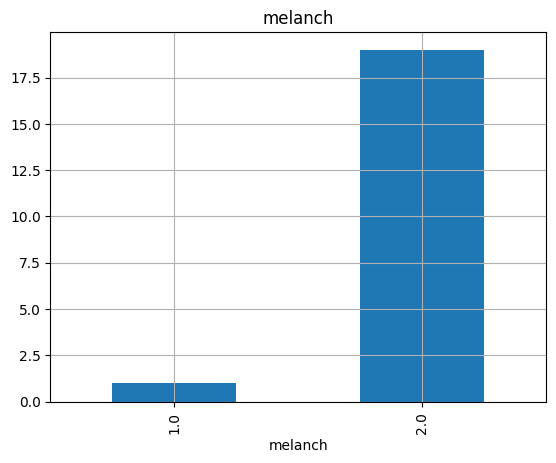

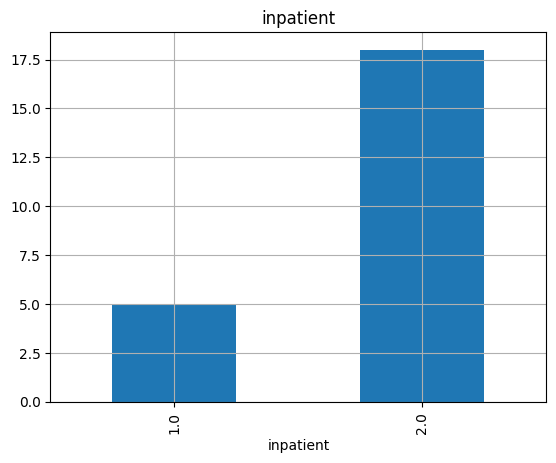

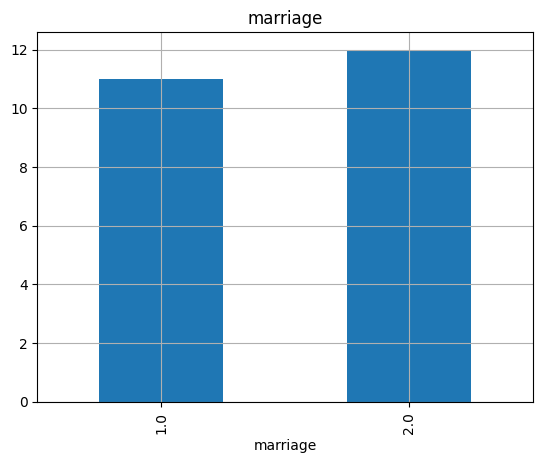

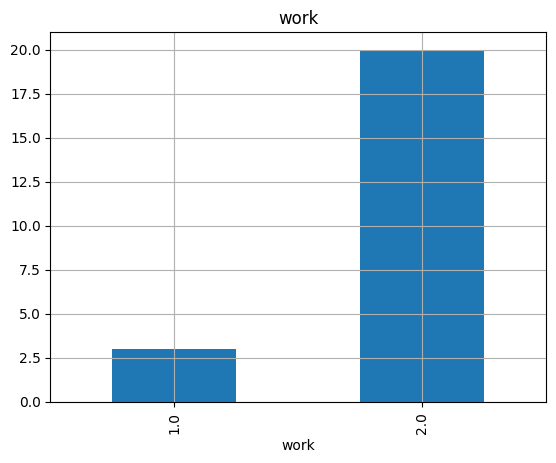

In [109]:
for f in feature_cat:
    score_condition[f].value_counts().sort_index().plot(kind='bar')
    plt.title(f)
    plt.grid()
    plt.show()


for control
categorical: gender
continuous: days, avg_age

In [116]:
score_control[feature_cont].describe()

,days,avg_age
count,32.000000,32.000000
mean,12.562500,38.406250
std,2.313181,12.714887
min,8.000000,22.000000
25%,13.000000,27.000000
50%,13.000000,37.000000
75%,13.000000,48.250000
max,20.000000,67.000000


In [304]:
feature_cont=[ 'avg_age']

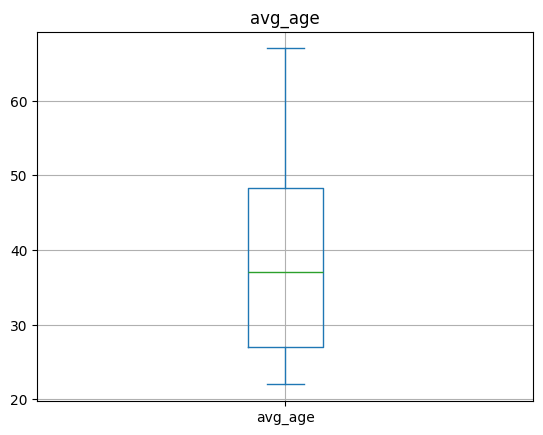

In [305]:
for f in feature_cont:
    score_control[f].plot(kind='box')
    plt.title(f)
    plt.grid()
    plt.show()


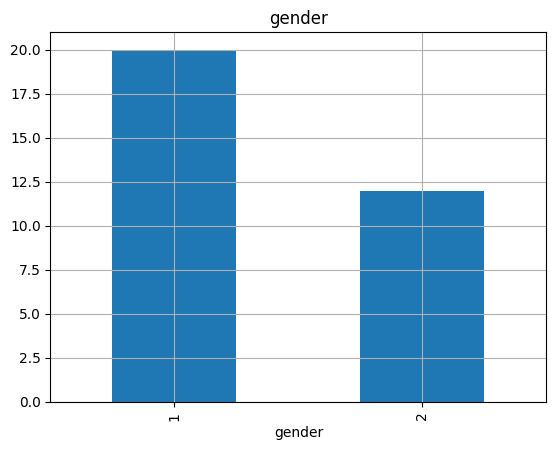

In [117]:
score_control['gender'].value_counts().sort_index().plot(kind='bar')
plt.title('gender')
plt.grid()
plt.show()

We don't observe any non-sensical values, i.e., data seems reasonable according to domain knowledge. However, even though on avergae we have around ~13 days recorded per individual across both groups, the min and max days differ between the two groups, i.e., lowest and highest days recorded for an inidivdual in depression group were 5 and 18, compared to control's 8 and 20. Moreover, we have more data for control (32 individuals) compared to condition (23 individuals). Lastly, we have more males in condition and more females in control.

We shall now visually inspect the actigraph measurements across time in conditions and groups. 

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


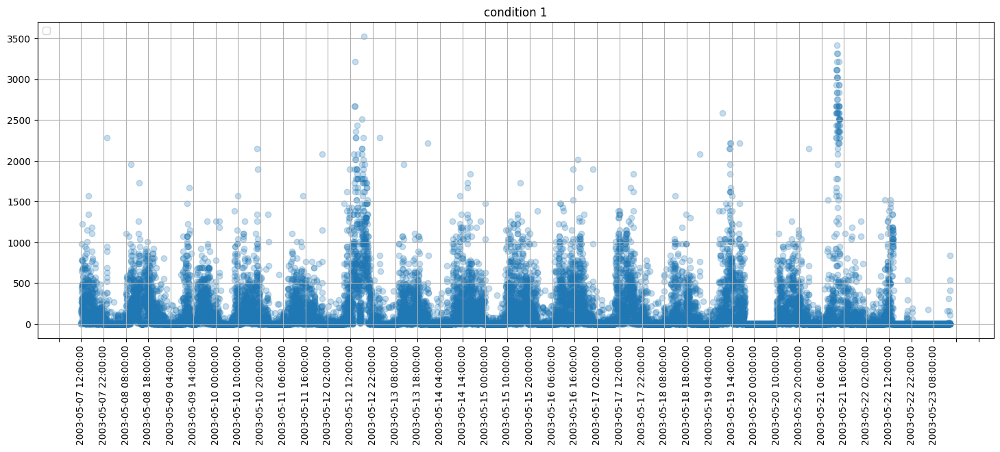

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


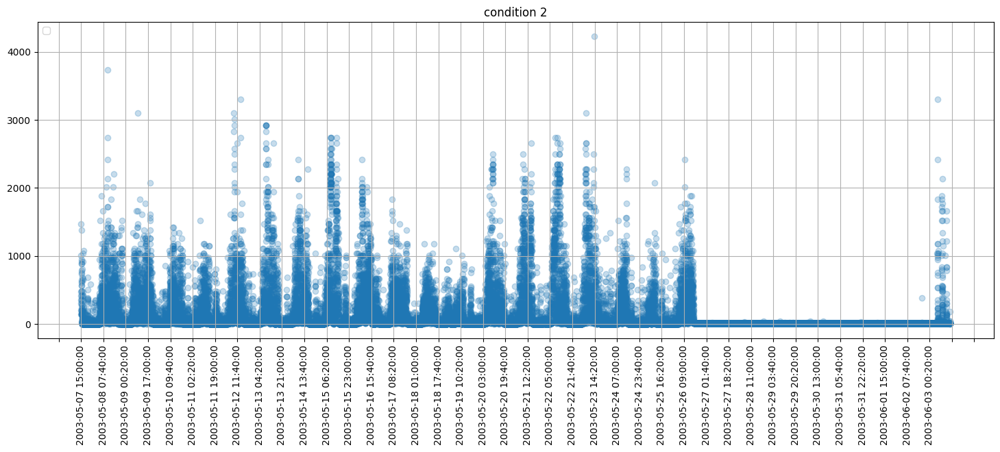

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


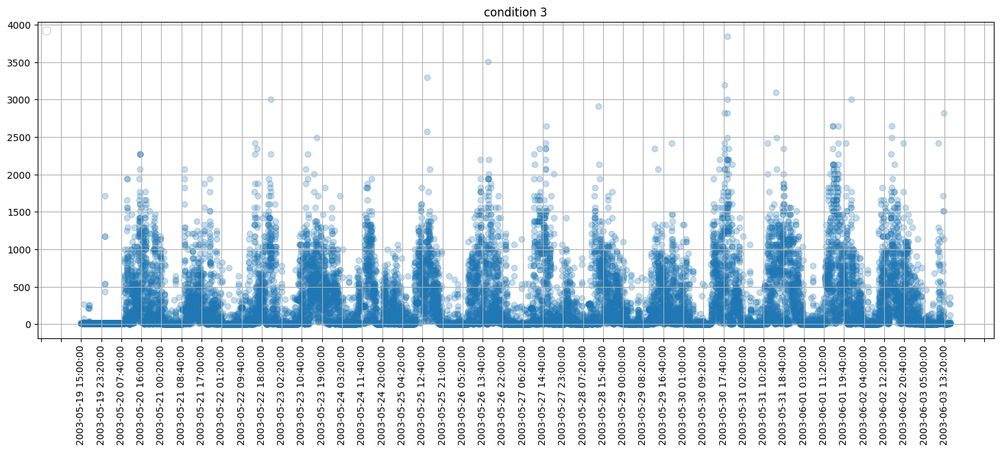

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


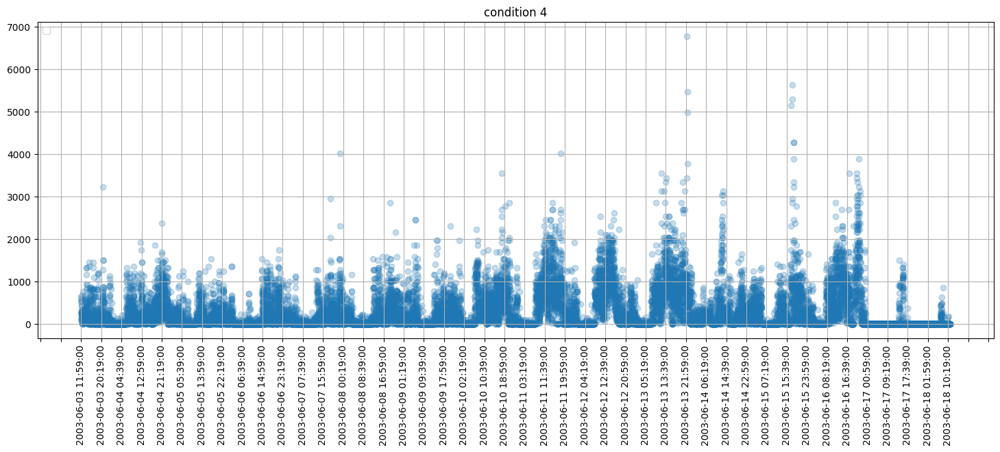

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


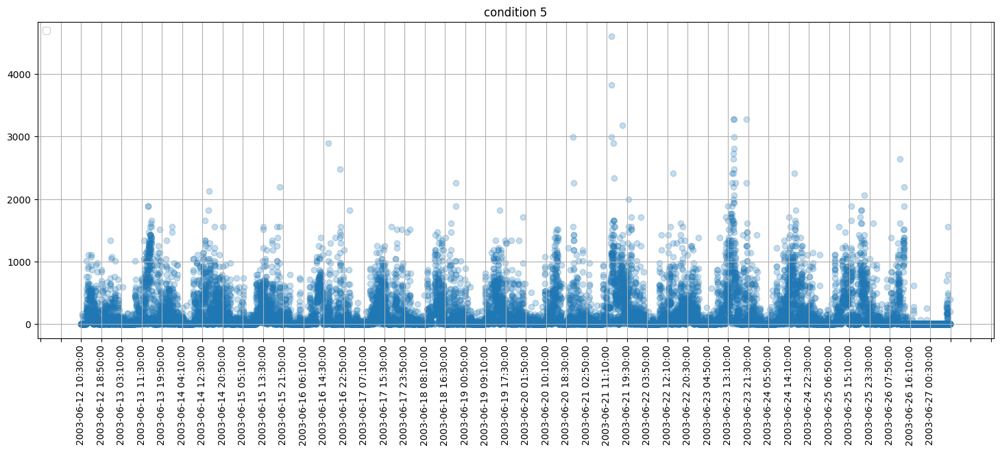

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


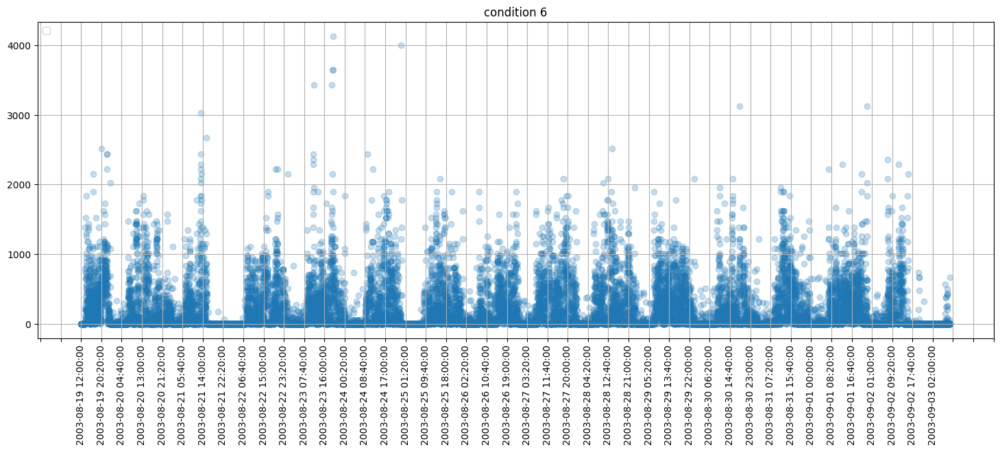

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


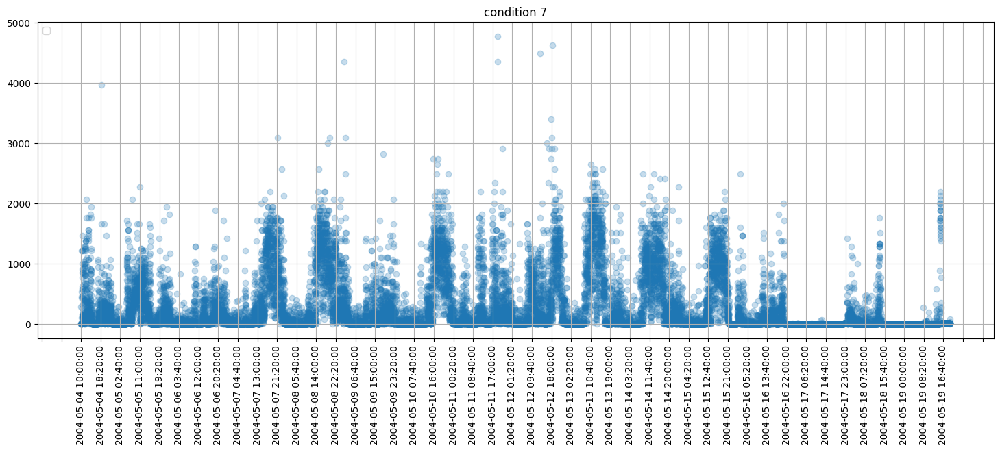

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


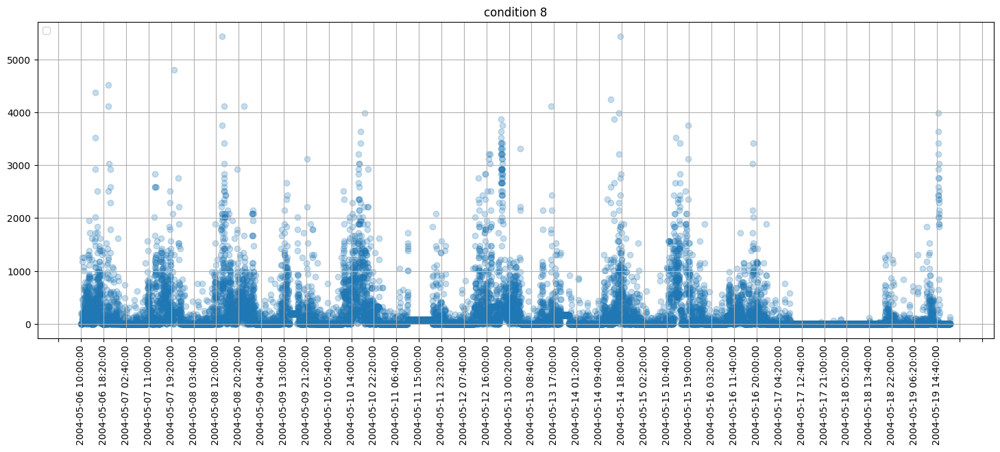

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


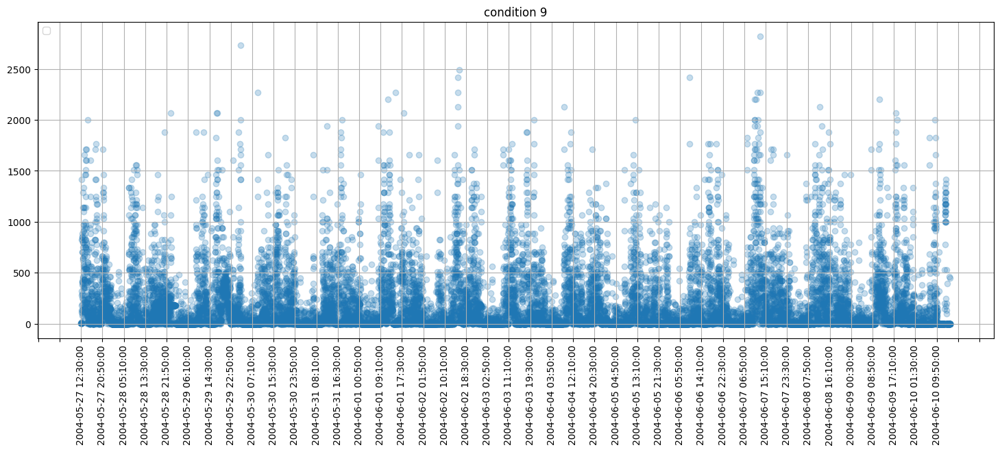

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


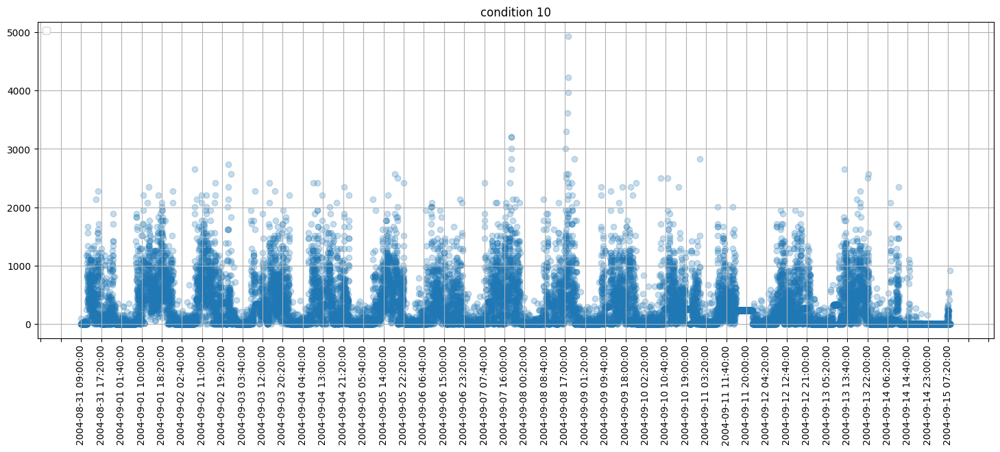

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


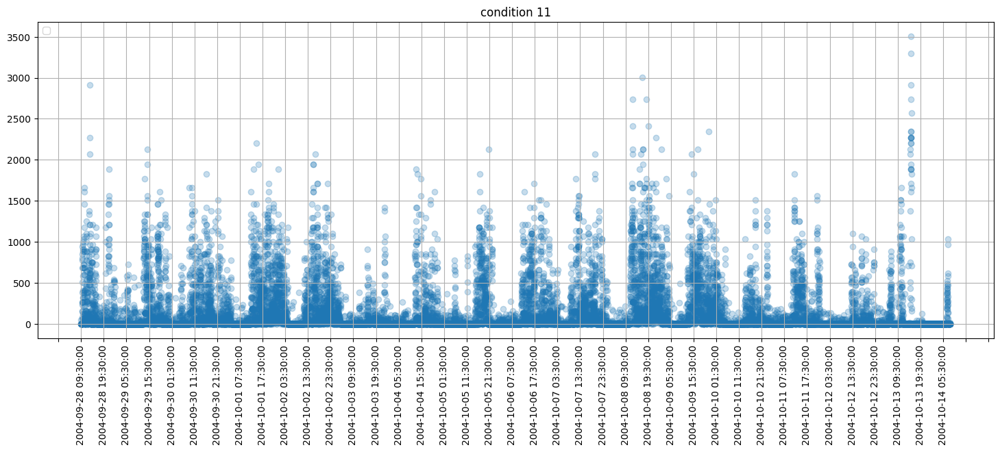

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


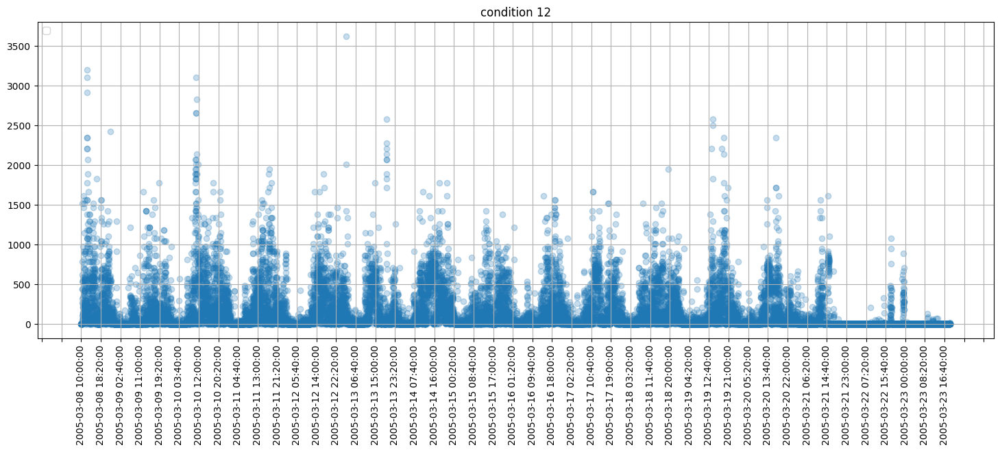

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


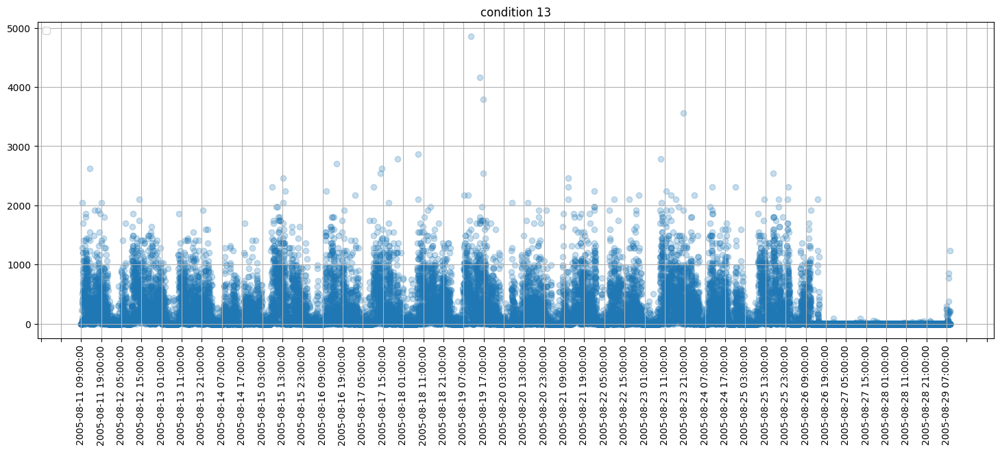

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


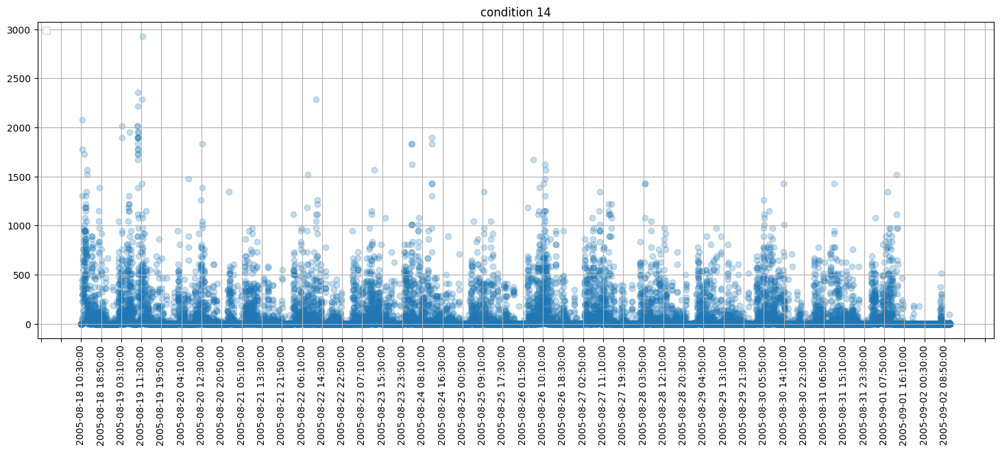

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


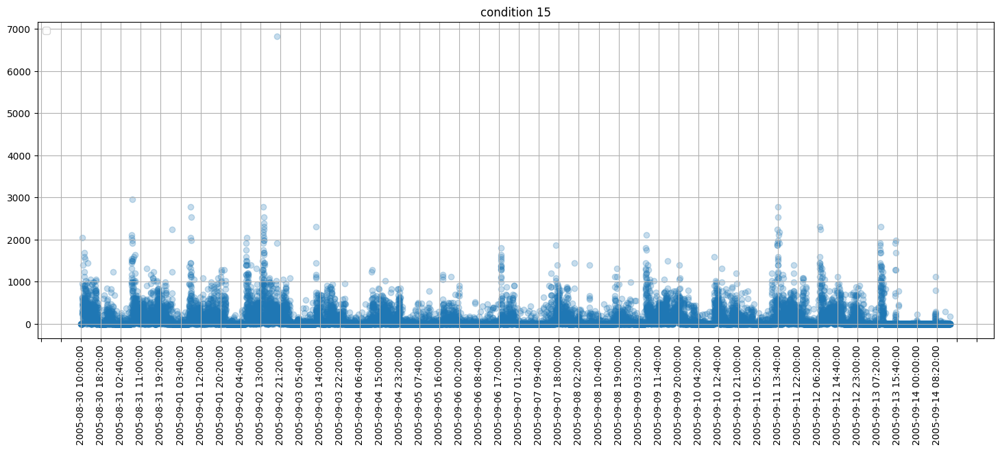

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


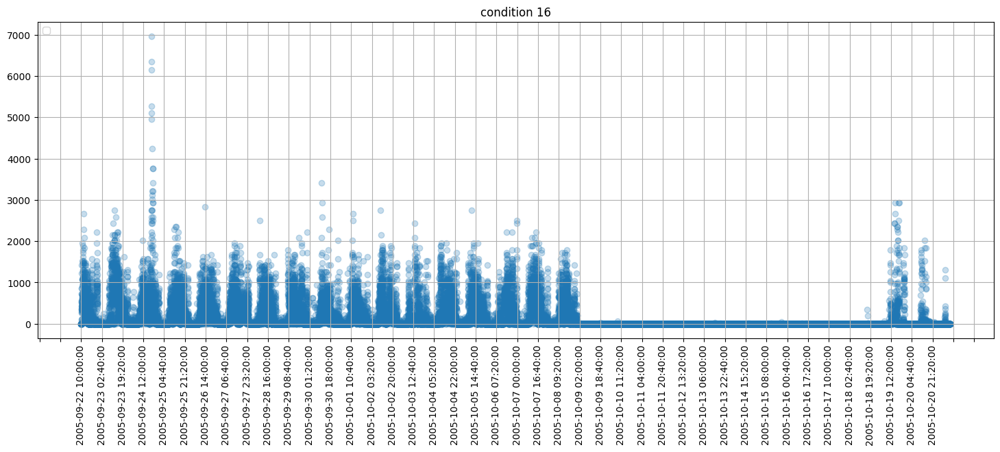

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


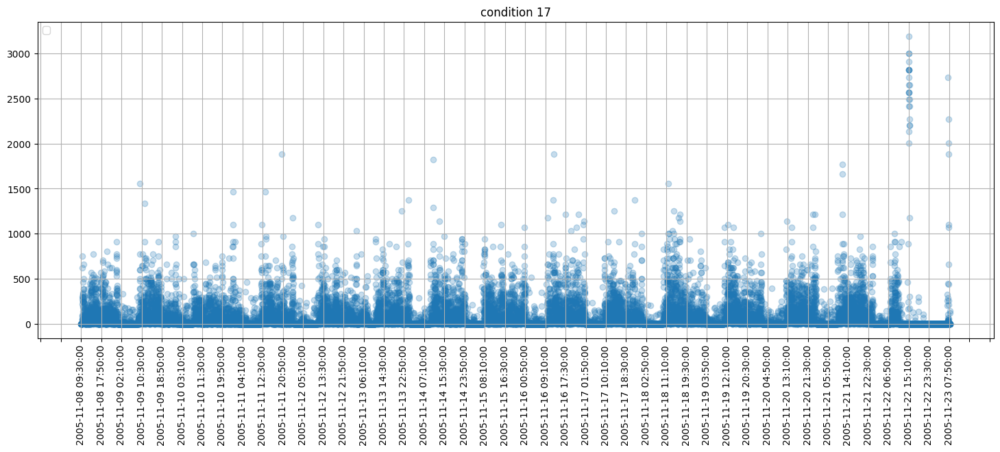

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


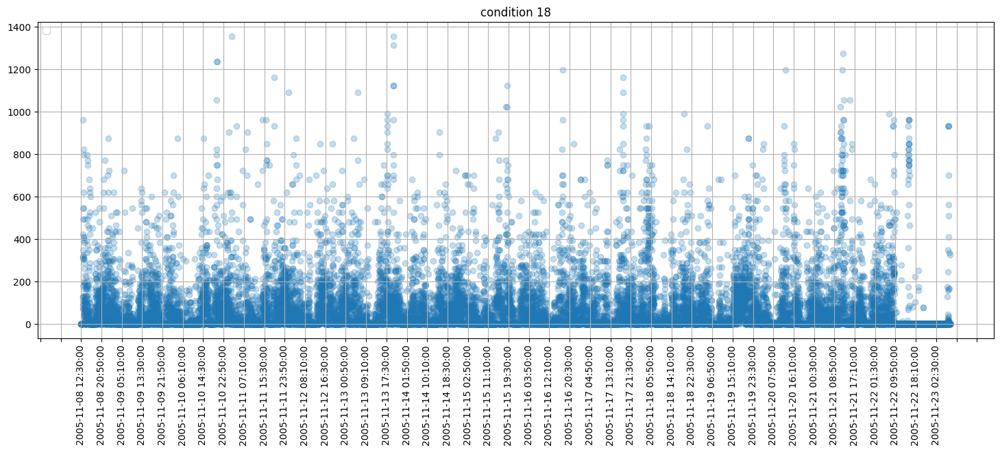

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


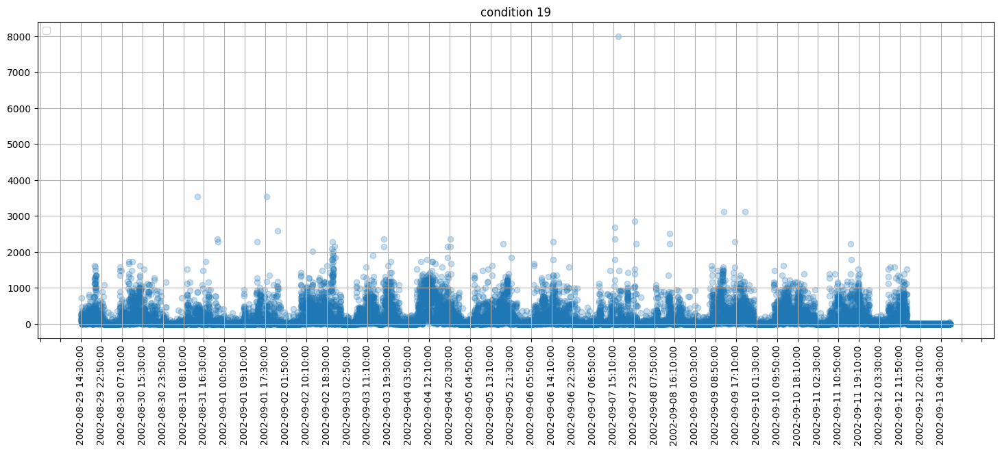

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


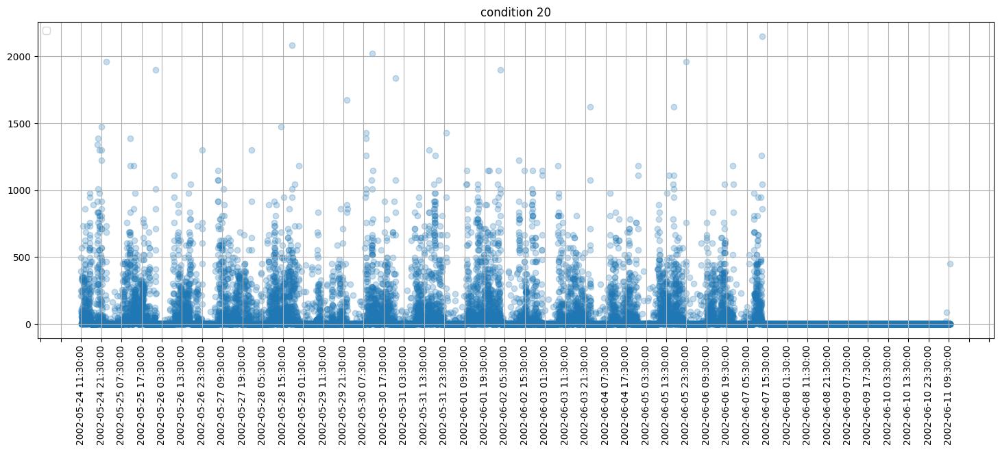

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


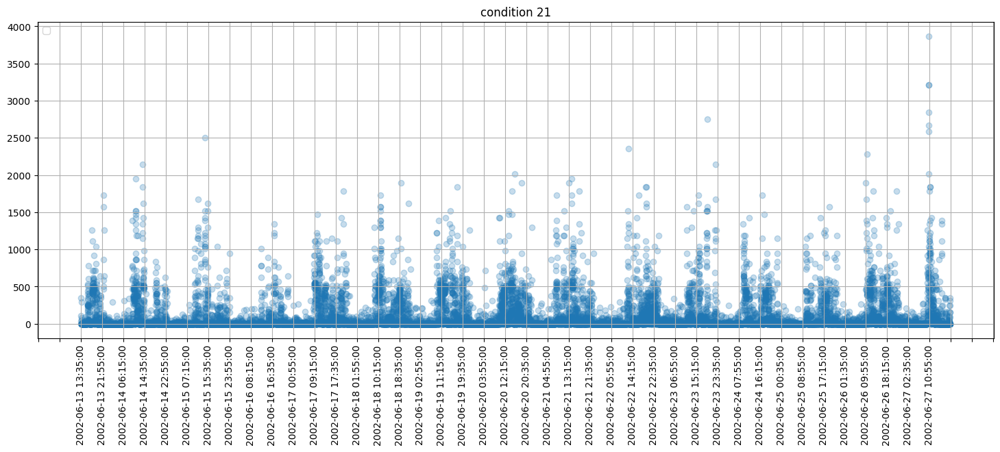

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


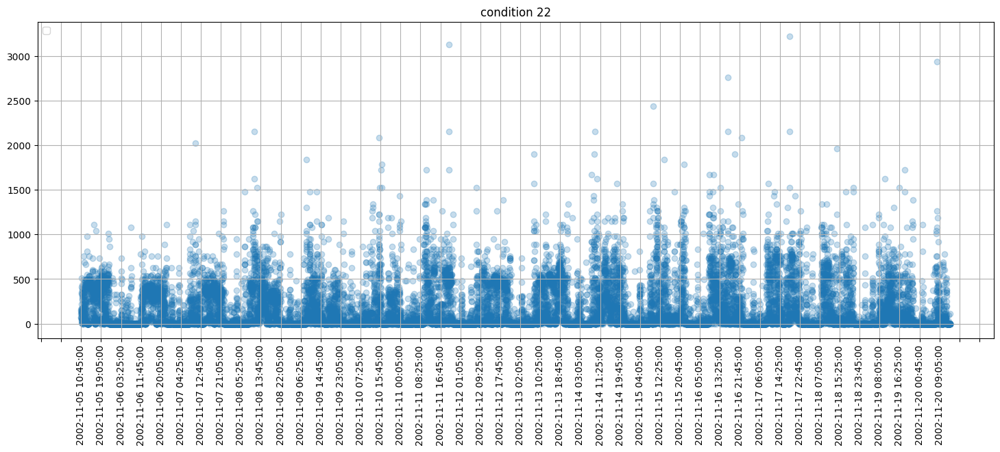

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


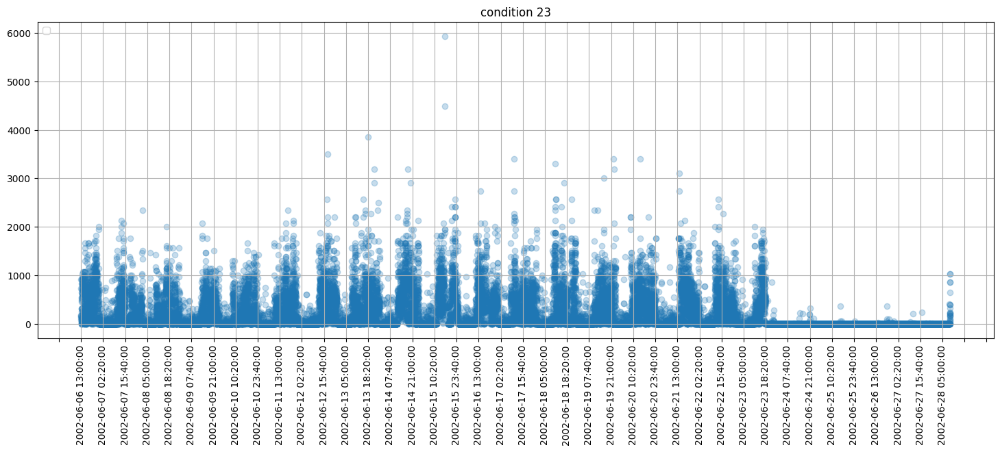

In [126]:
for i in range(1,24):
    condition= pd.read_csv(data_path + f'condition/condition_{i}.csv')
    my_alpha=0.25
    fig, ax = plt.subplots(figsize=(18,6))
    ax.scatter(condition.timestamp, condition.activity , alpha=my_alpha)
    ax.xaxis.set_major_locator(plt.MaxNLocator(50)) 
    plt.title(f'condition {i}')
    plt.xticks(rotation=90)
    plt.grid()
    ax.legend(loc='upper left')
    plt.show()


In [129]:
score_control

,number,days,gender,age,afftype,melanch,inpatient,edu,marriage,work,madrs1,madrs2,start_age,end_age,avg_age,start_edu,end_edu,avg_edu,avg_madrs,delta_madrs
23,control_1,8,2,25-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25,29,27,<NA>,<NA>,<NA>,NaN,NaN
24,control_2,20,1,30-34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30,34,32,<NA>,<NA>,<NA>,NaN,NaN
25,control_3,12,2,30-34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30,34,32,<NA>,<NA>,<NA>,NaN,NaN
26,control_4,13,1,25-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25,29,27,<NA>,<NA>,<NA>,NaN,NaN
27,control_5,13,1,30-34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30,34,32,<NA>,<NA>,<NA>,NaN,NaN
28,control_6,13,1,25-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25,29,27,<NA>,<NA>,<NA>,NaN,NaN
29,control_7,13,1,20-24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20,24,22,<NA>,<NA>,<NA>,NaN,NaN
30,control_8,13,2,40-44,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40,44,42,<NA>,<NA>,<NA>,NaN,NaN
31,control_9,13,2,30-34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30,34,32,<NA>,<NA>,<NA>,NaN,NaN
32,control_10,8,1,30-34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30,34,32,<NA>,<NA>,<NA>,NaN,NaN


From the original paper: The here presented dataset was originally collected for the study of motor activity in schizophrenia and major depression. Motor activity was monitored with an actigraph watch worn at the right wrist (Actiwatch, Cambridge Neurotechnology Ltd, England, model AW4). The actigraph watch measures activity by using a piezoelectric accelerometer that is programmed to record the integration of intensity, amount and duration of movement in all directions. The sampling frequency is 32Hz and movements over 0.05 g are recorded. A corresponding voltage is produced and is stored as an activity count in the memory unit of the actigraph watch. The number of counts is proportional to the intensity of the movement. The right wrist was chosen to make the procedure more convenient for the participants, since most of them have their watches around the left wrist, and it is cumbersome to have two devices on the same arm. Total activity counts were continuously recorded in one minute intervals.

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


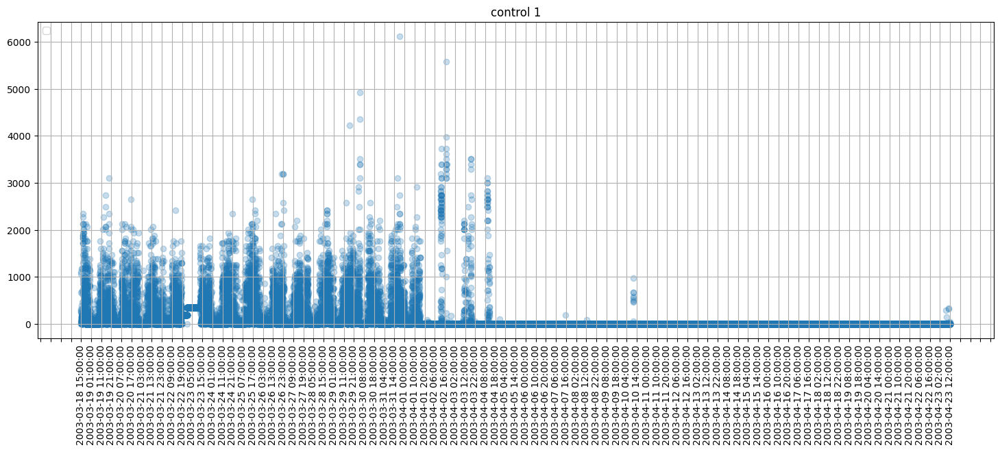

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


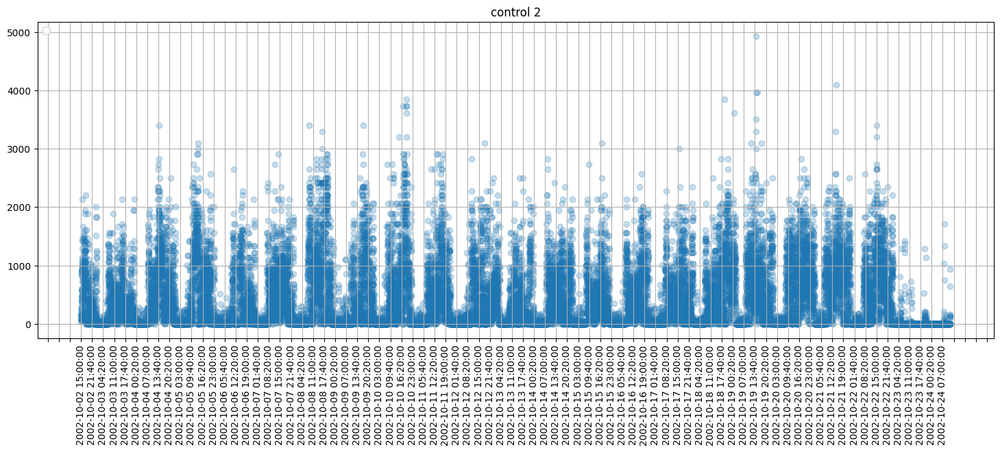

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


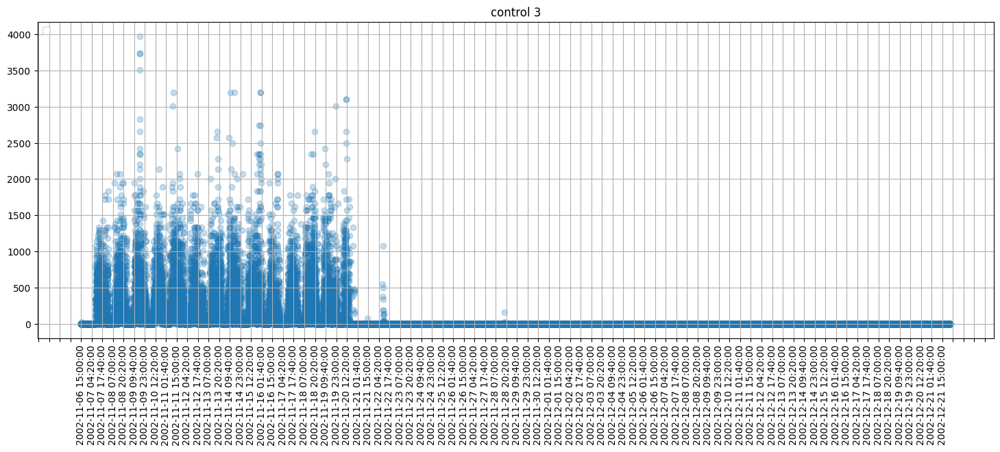

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


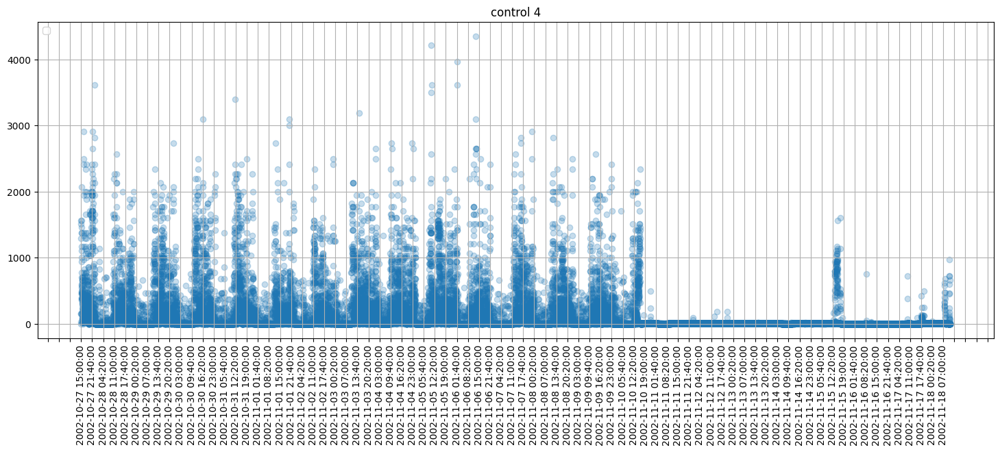

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


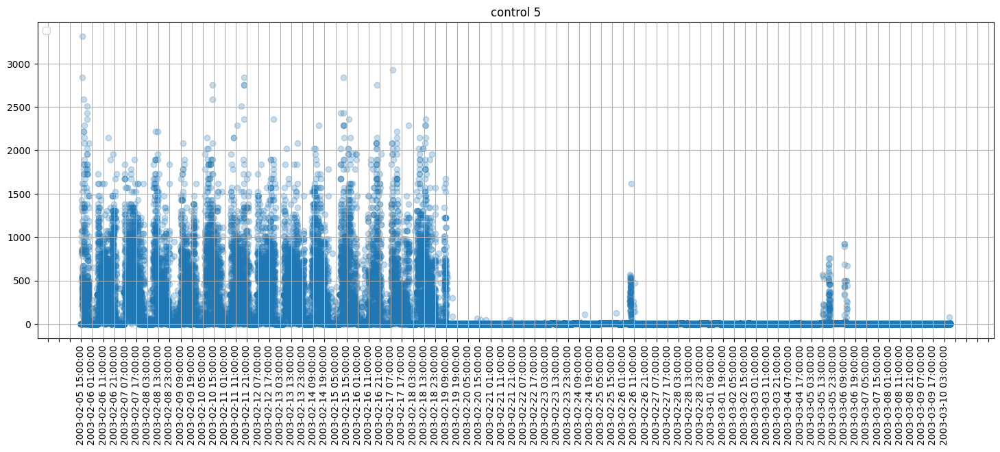

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


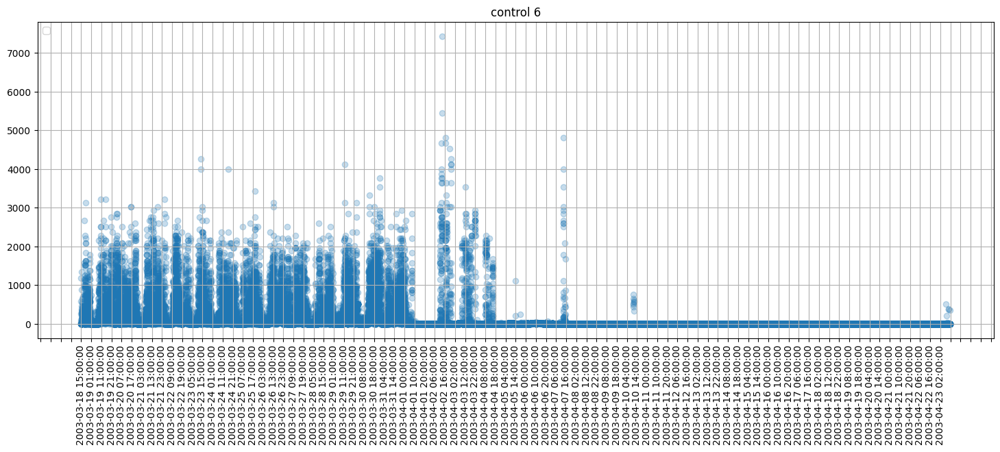

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


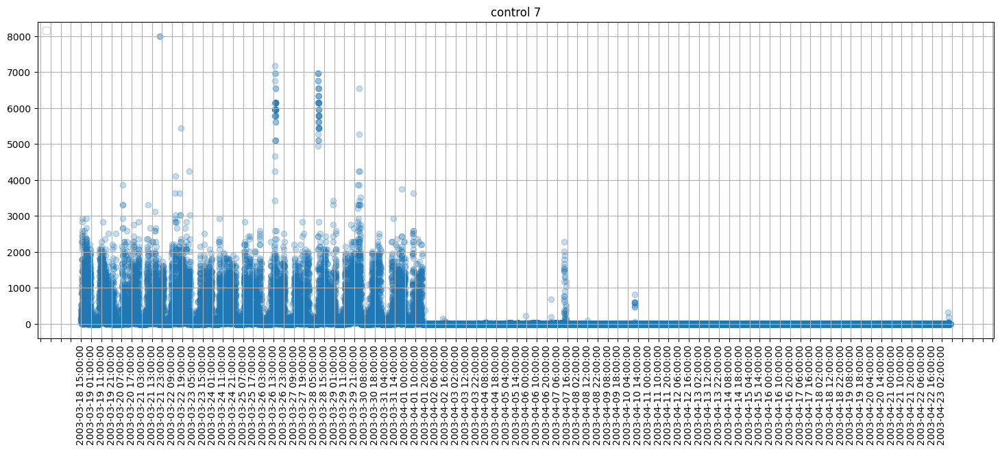

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


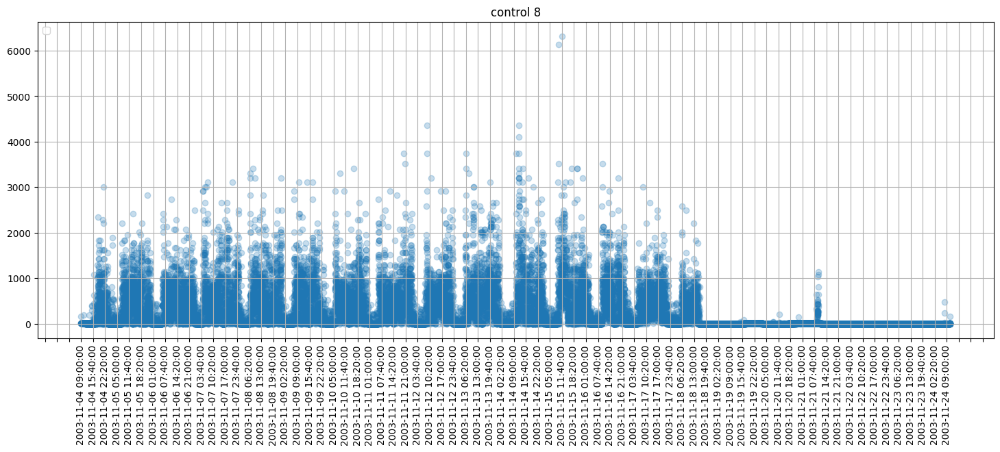

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


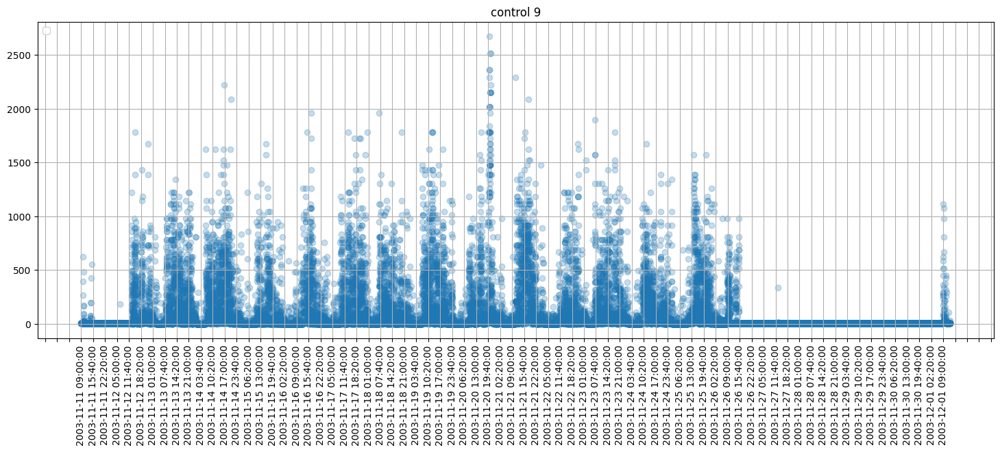

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


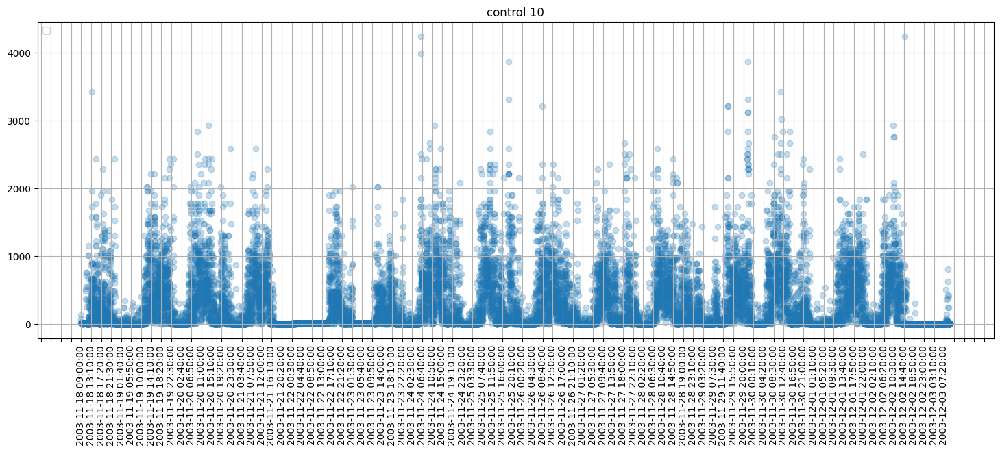

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


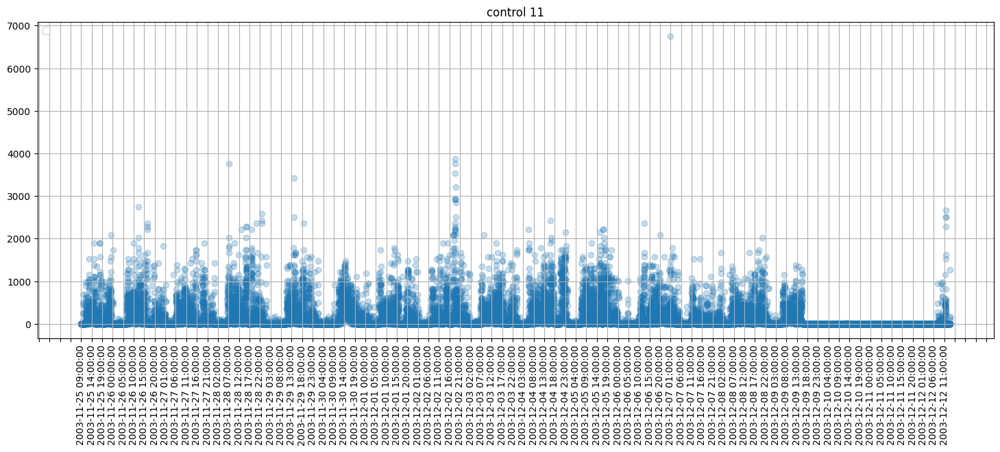

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


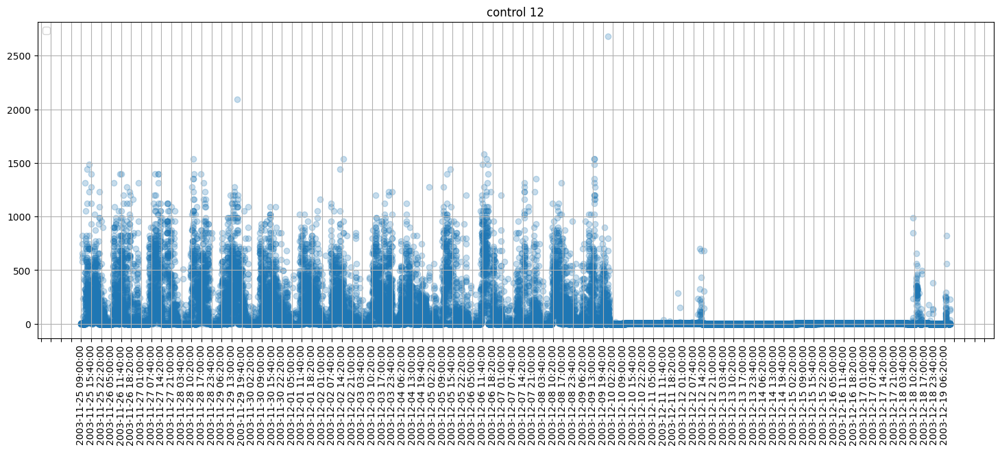

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


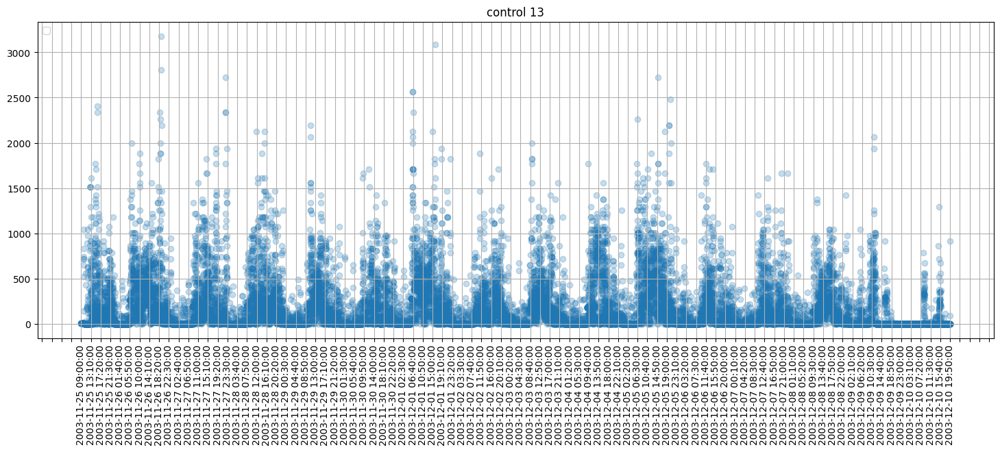

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


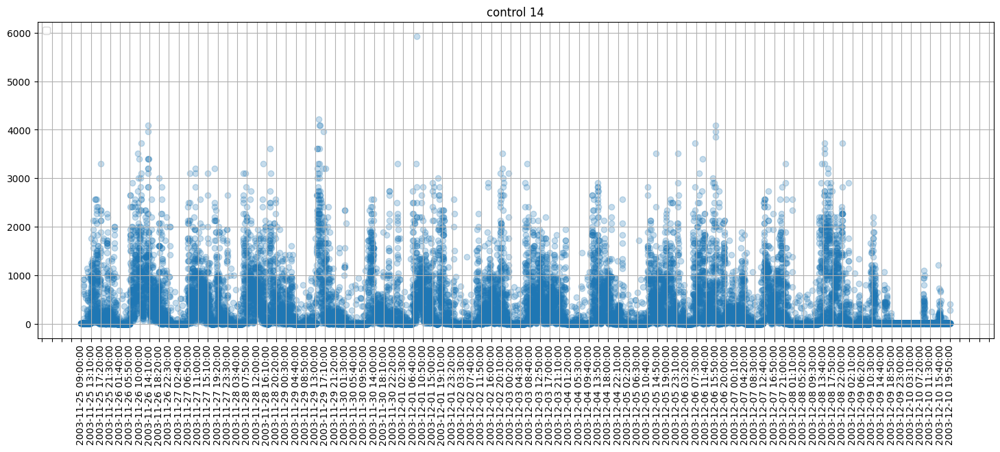

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


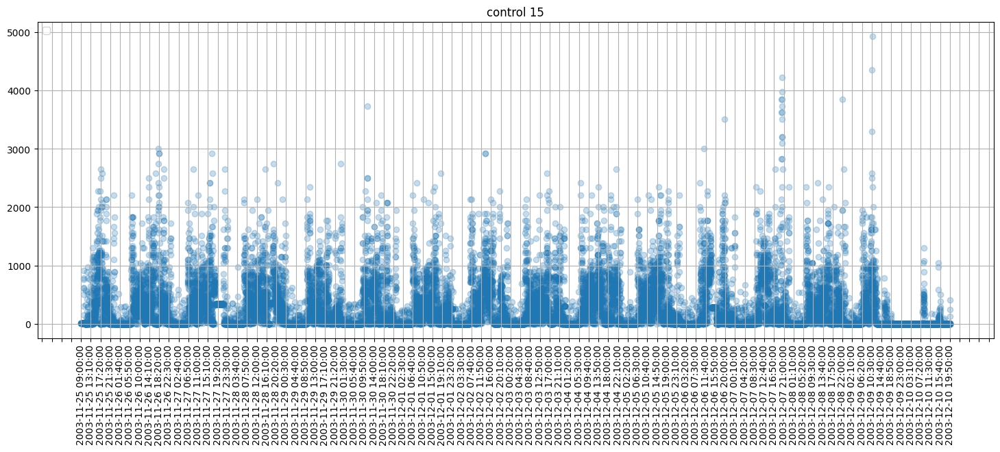

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


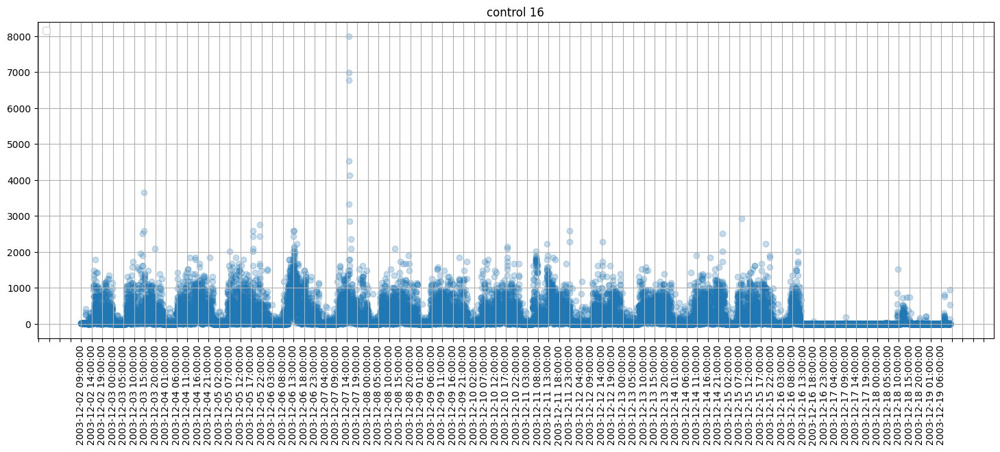

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


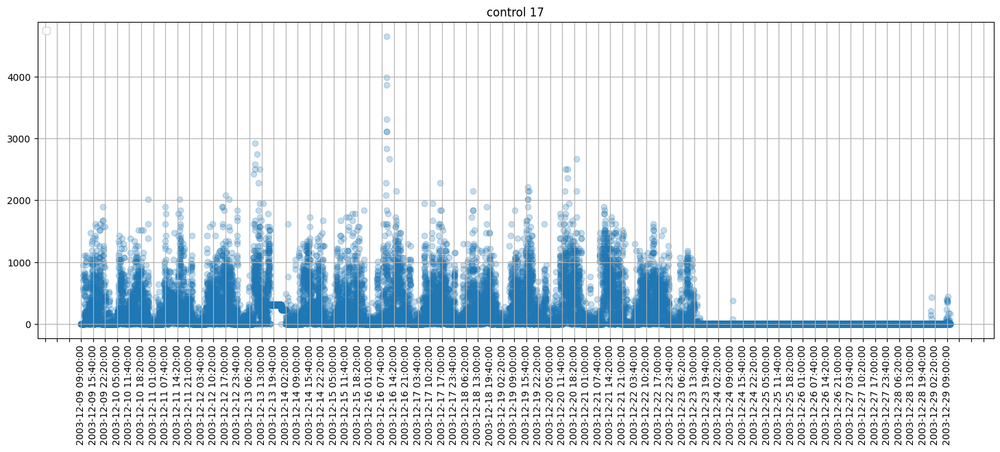

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


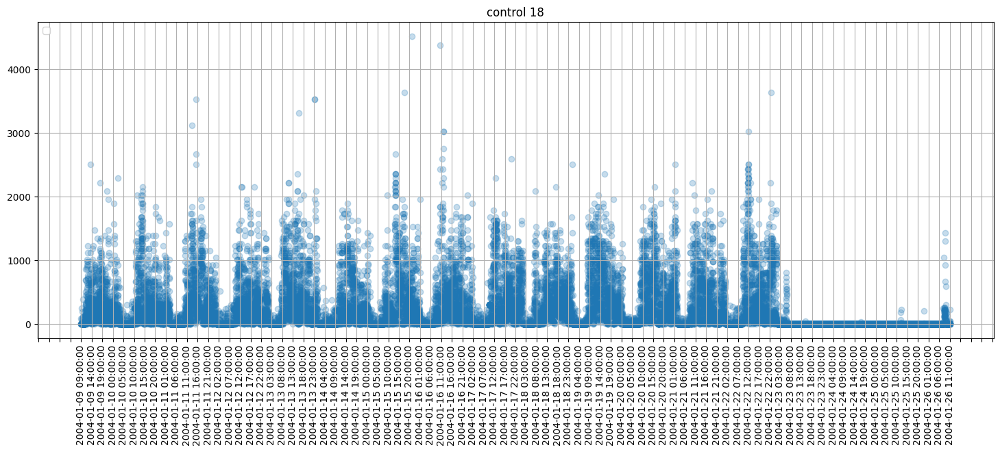

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


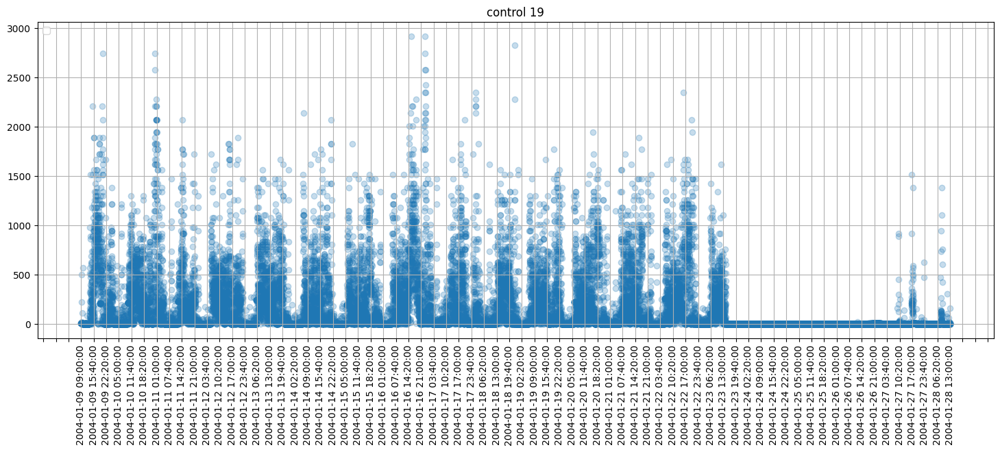

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


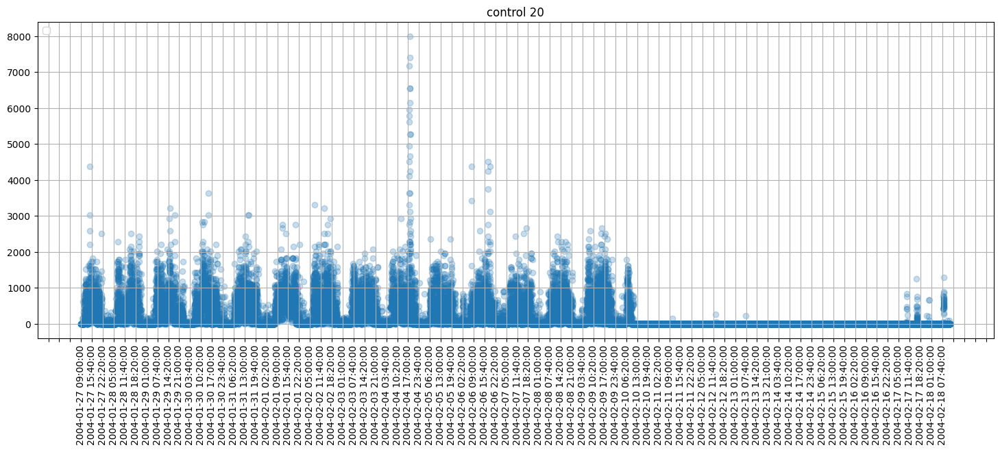

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


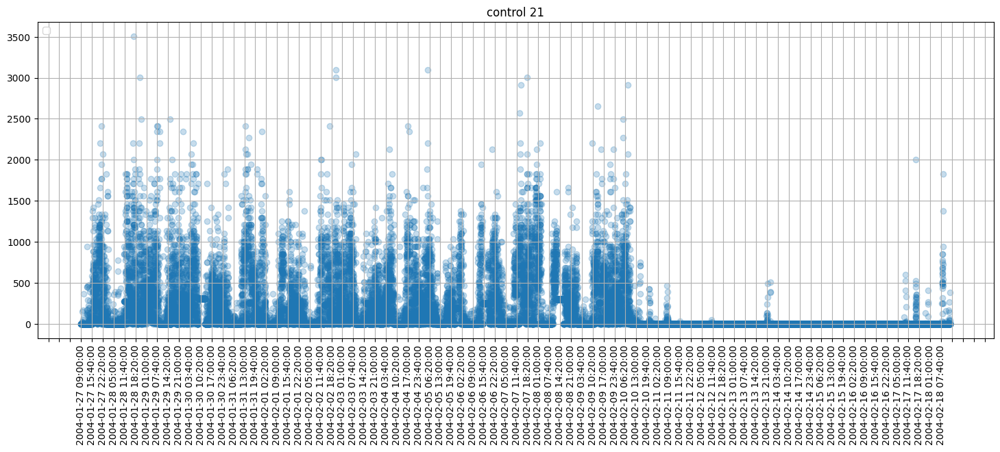

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


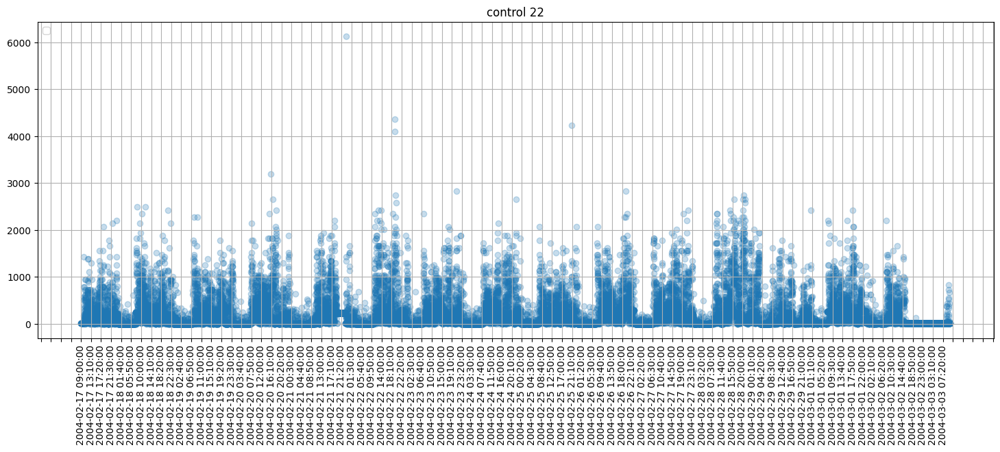

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


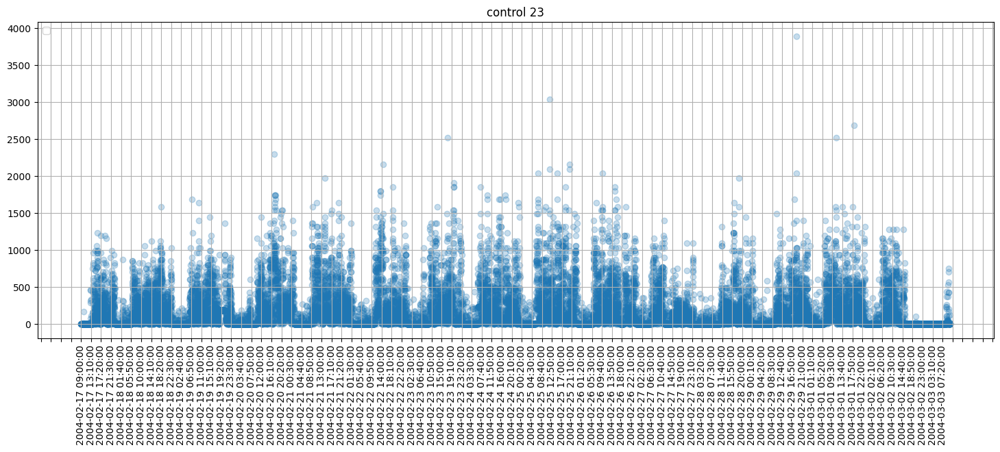

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


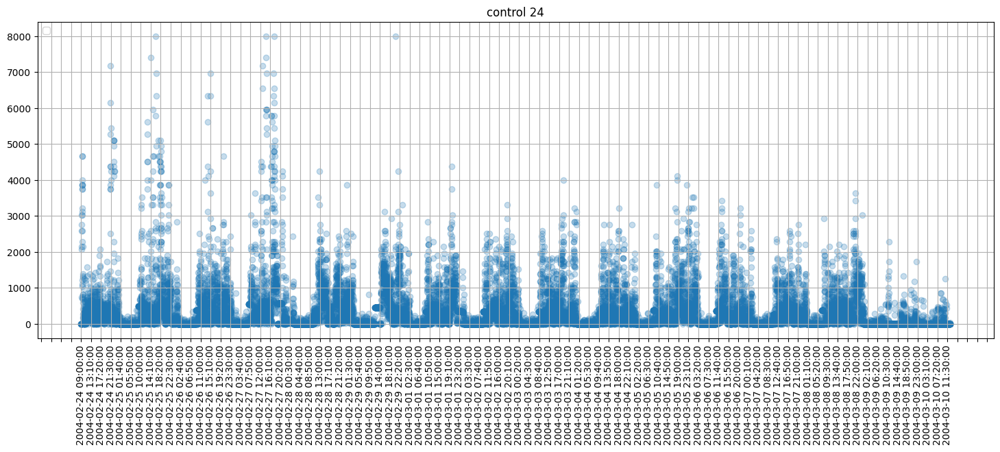

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


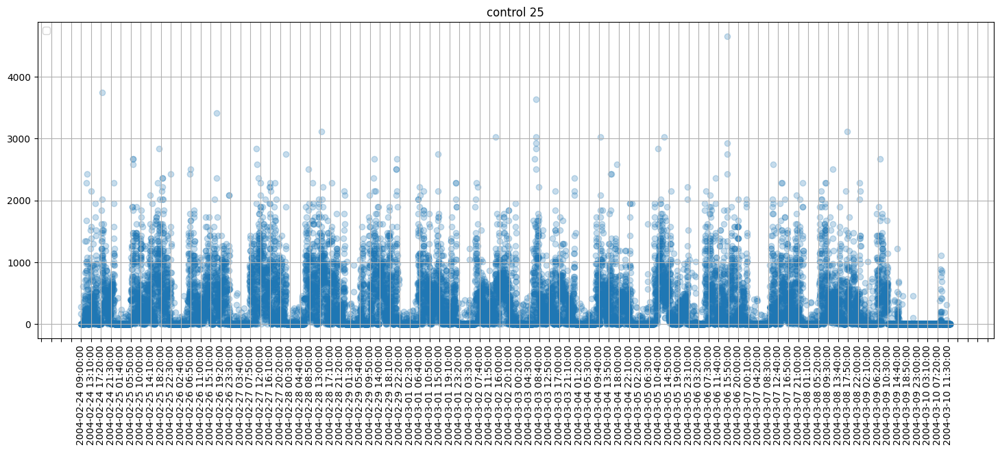

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


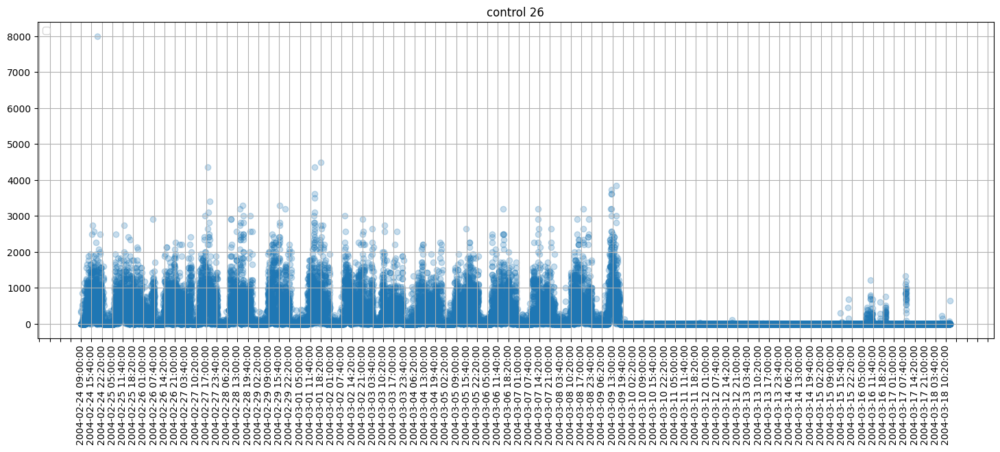

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


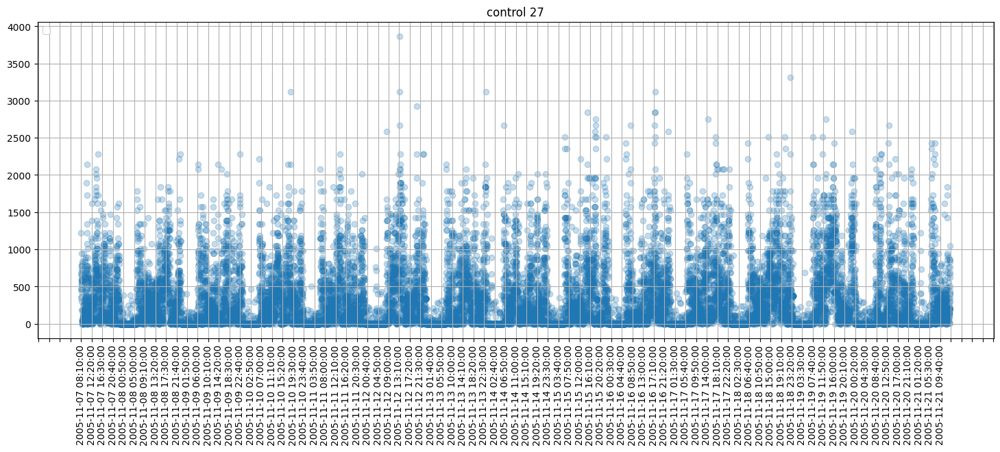

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


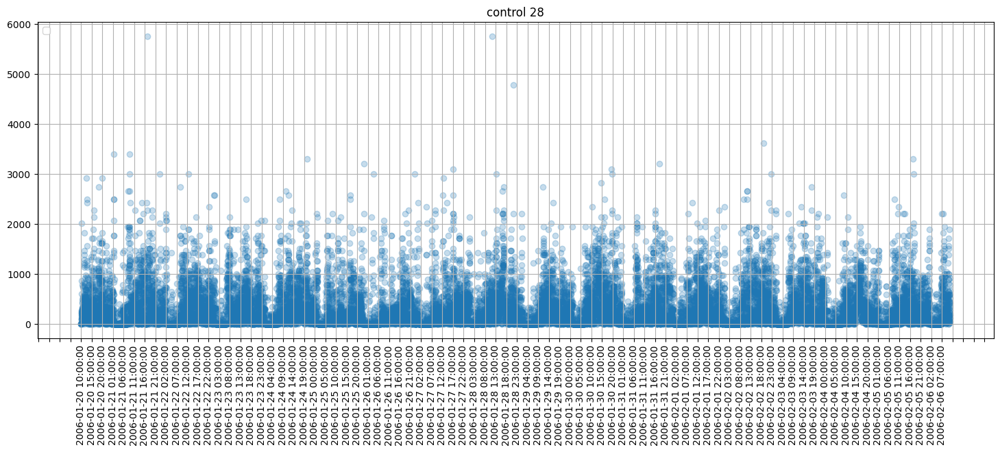

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


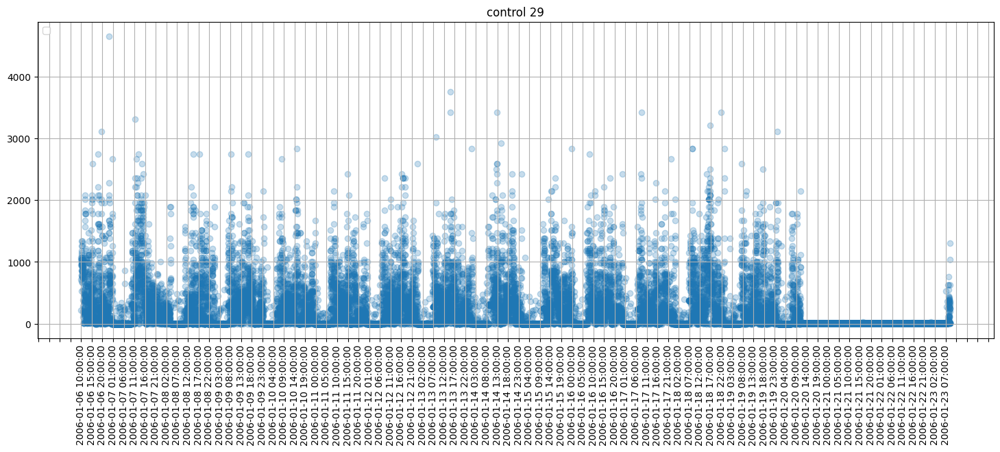

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


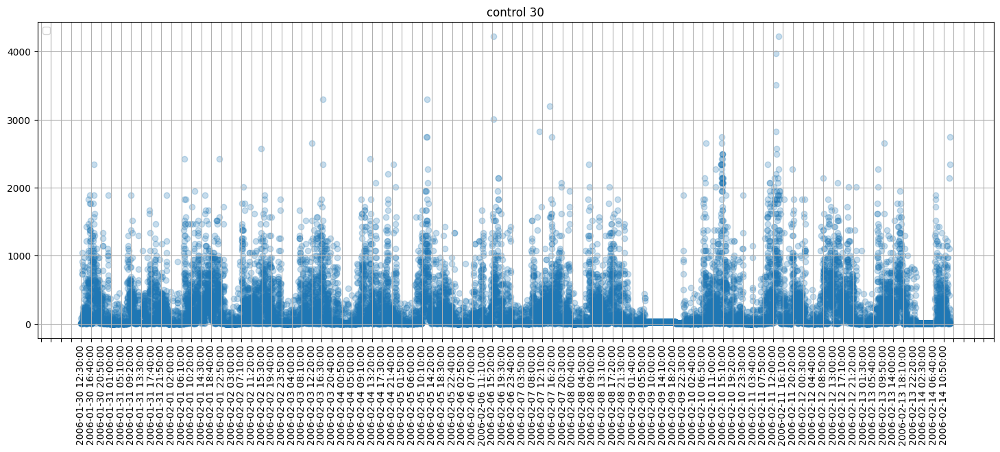

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


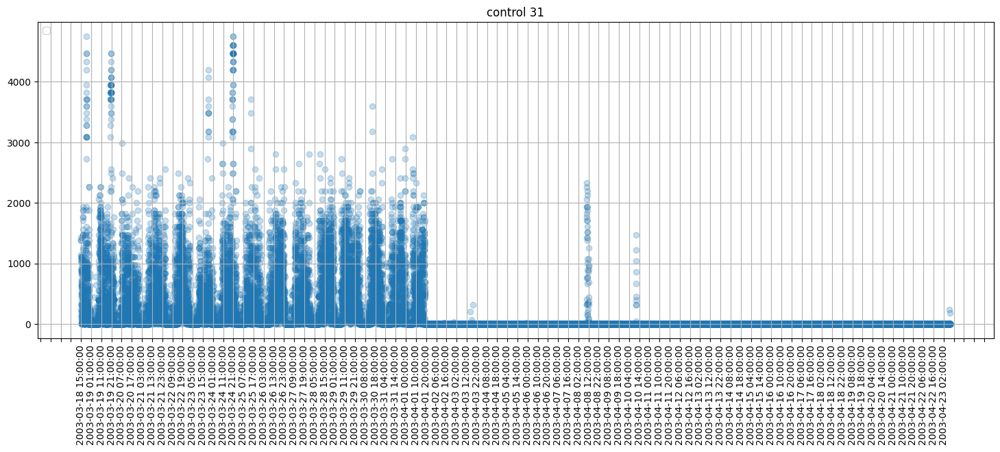

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


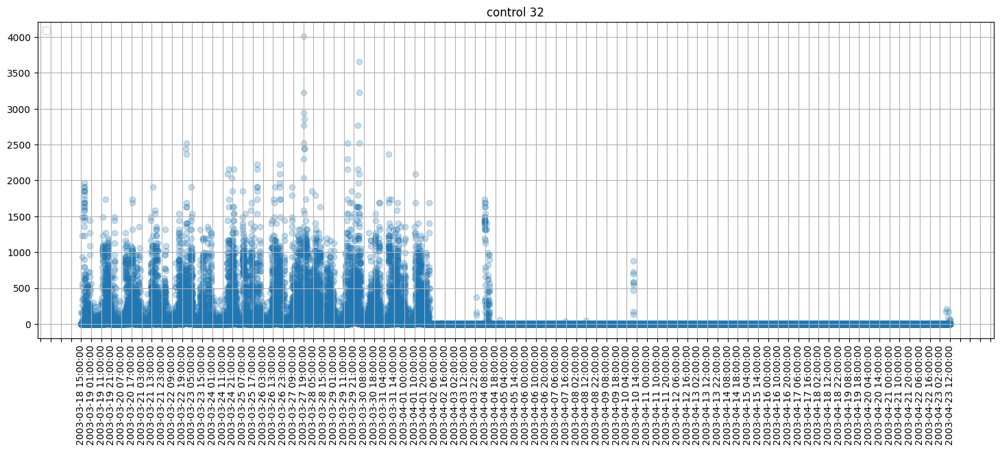

In [130]:
for i in range(1,33):
    control= pd.read_csv(data_path + f'control/control_{i}.csv')
    my_alpha=0.25
    fig, ax = plt.subplots(figsize=(18,6))
    ax.scatter(control.timestamp, control.activity , alpha=my_alpha)
    ax.xaxis.set_major_locator(plt.MaxNLocator(100)) 
    plt.title(f'control {i}')
    plt.xticks(rotation=90)
    plt.grid()
    ax.legend(loc='upper left')
    plt.show()


We've identified instances where individuals in both groups have multiple days without any meaningful actigraph recordings. This situation appears unrealistic, so we plan to filter out this nonsensical data. Our approach is to set a threshold at 10 units of average activity throughout the day. If a day's average activity falls below this threshold, we will exclude that day from our subsequent analysis. Why select a sensitive threhold of 10? as per the original paper, the accelerometer appears to be very sensitive i.e., has the ability to record movements down to as low as 0.05g. It indicates that the instrument can detect very subtle movements therefore zero unit activity for a prolonged period like 24 hours seems unreasonbale to me. Therefore this apptoach can help ensure that only meaningful data is included in analysis. 

In [ ]:
control_meanList =[]
control_stdList=[]
control_cvList=[]
control_days=[]

all_control_data = pd.DataFrame()

for i in range(1,33):
    control= pd.read_csv(data_path + f'control/control_{i}.csv')
    control['timestamp'] = pd.to_datetime(control['timestamp'])
    control['hour']=control['timestamp'].dt.strftime('%H')
    control_bydate = control.groupby(['date'], as_index=False).agg(
        n=pd.NamedAgg(column='activity', aggfunc='count'),
        mean_activity=pd.NamedAgg(column='activity', aggfunc='mean')
    )
#removing days with irrationally low average daily activity. 
    control_bydate= control_bydate[control_bydate.mean_activity>10]
    """
        Mixed effects modeling can handle Missing At Random (MAR) data, such as when the first and last days have missing data. 
        In this context, we know that the missing data on these days is due to individuals either wearing or removing their actigraph during those times, on account of completion of measurement for study. 
        However, this explanation doesn't apply to days in between when the actigraph is not recording data since we do not know why individuasls/actigraph stopped recording (MNAR)
    """
    control_bydate = control_bydate[(control_bydate.index==0) | (control_bydate.n==1440) | (control_bydate.index== len(control_bydate)-1)]
    mask = control['date'].isin(control_bydate['date'])
    control=control[mask]
    control['hour']=control['hour'].astype(str)
    control['date_hour']= control['date']+' '+control['hour']
    print(f'control {i}')
    #print(control)


    #extracting mean and std of daily means 
    daily_means = control_bydate.mean_activity.mean()
    daily_std = control_bydate.mean_activity.std()
    daily_cv = daily_std/daily_means
    print(daily_means, daily_std, daily_cv)

    control_meanList.append(daily_means)
    control_stdList.append(daily_std)
    control_cvList.append(daily_cv)
    control_days.append(len(control_bydate))

    control_byhour=control.groupby(['date_hour'], as_index=False).agg(
        n=pd.NamedAgg(column='activity', aggfunc='count'),
        mean_activity=pd.NamedAgg(column='activity', aggfunc='mean')
    )


    control_byhour['hour'] =control_byhour['date_hour'].str[-2:]
    control_byhour['date'] =control_byhour['date_hour'].str[:-2]

    if i==1:
        all_control_data=control_byhour
    else:
        all_control_data = pd.concat([all_control_data, control_byhour], axis=0)
    
    print(all_control_data)
    
    
    pivot= control_byhour.pivot_table(index='date', columns='hour',values='mean_activity',fill_value=0)
    


    plt.figure(figsize=(5, 5))
    sns.heatmap(pivot, cmap='Reds', linewidths=0.5, linecolor='grey')
    plt.title('Mean Activity Heatmap')
    plt.xlabel('Hour')
    plt.ylabel('Date')
    plt.show()




In [329]:
mean_control=all_control_data.mean_activity.mean()
std_control=all_control_data.mean_activity.std()

In [331]:
max((all_control_data.mean_activity - mean_control)/std_control)

13.54032562256371

In [332]:
min((all_control_data.mean_activity - mean_control)/std_control)

-0.957061901013496

control 1
204.5947440087146 90.152720099063 0.440640450153612


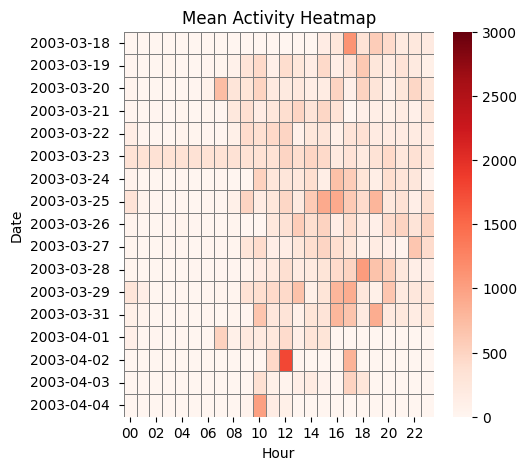

control 2
390.6049481617417 155.15734991788182 0.3972232063318211


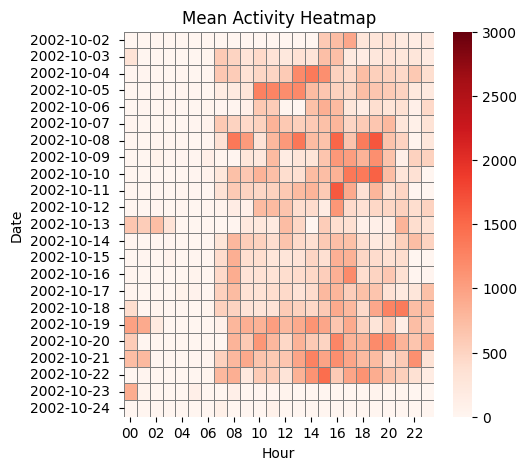

control 3
249.64126984126986 52.55853240538888 0.21053623240583308


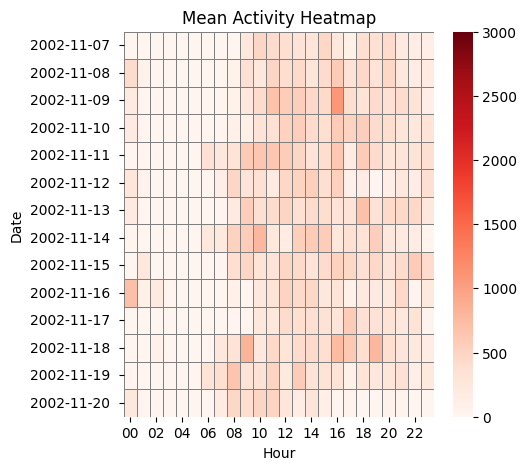

control 4
207.34075520833335 101.48235107724166 0.48944719515115825


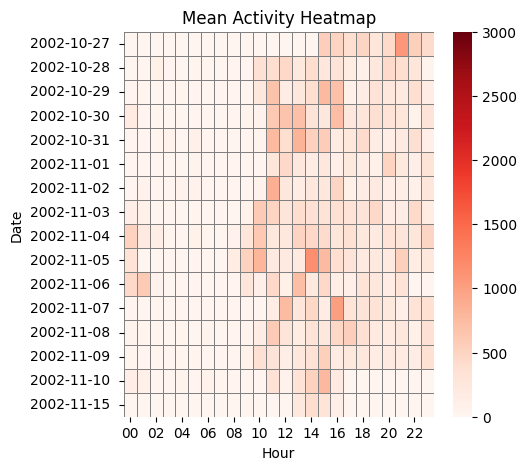

control 5
255.73461934156376 134.799683119062 0.5271076847793575


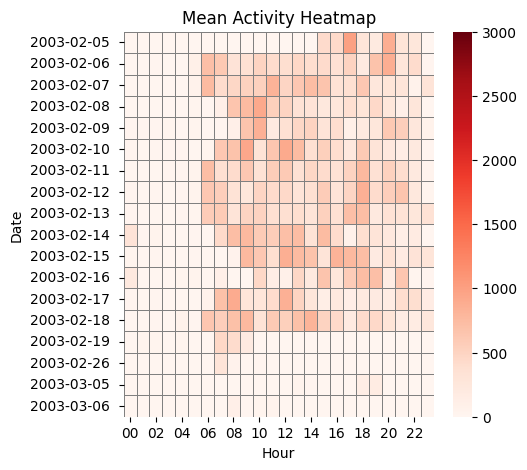

control 6
283.2560699588478 122.26168655061392 0.43162953778316715


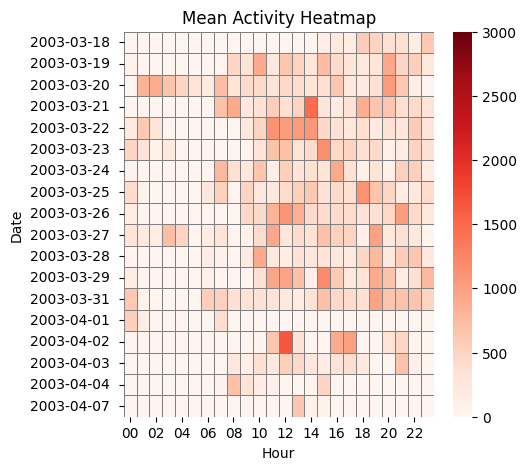

control 7
386.1467129629629 158.40897545913265 0.4102300243439503


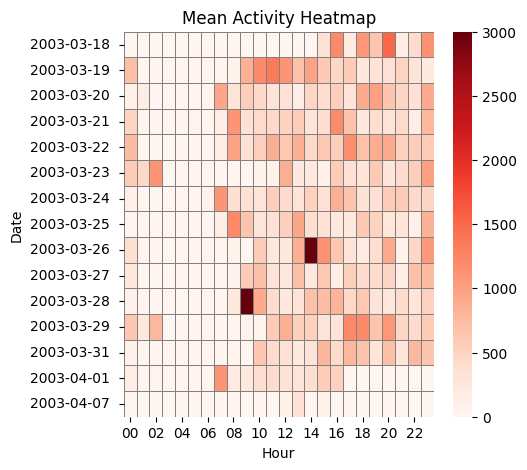

control 8
369.1949739583333 128.71897826894198 0.34864769931420836


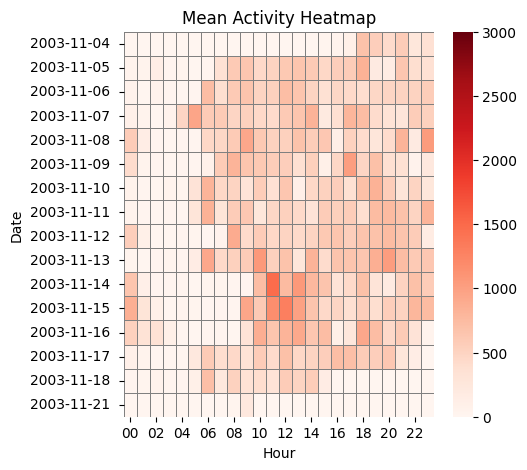

control 9
141.17037037037036 47.24162554990351 0.33464264084568024


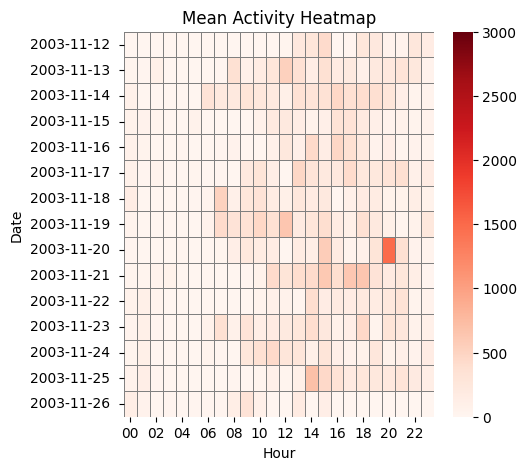

control 10
286.8015740740741 81.49577273558441 0.28415385445038027


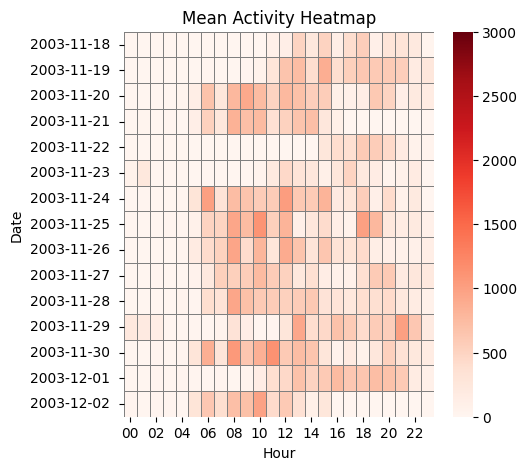

control 11
190.18353703703704 55.88752653553774 0.2938610113484954


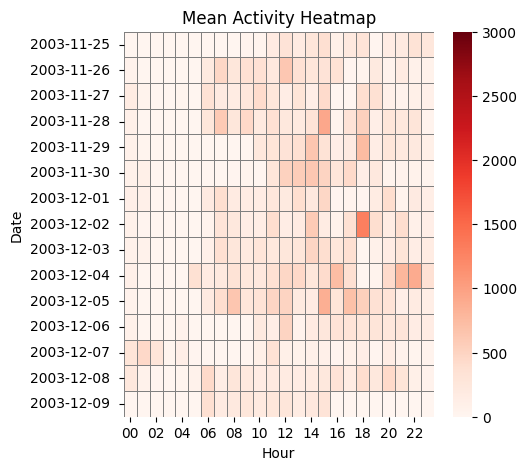

control 12
143.77953993055556 49.598455253238555 0.34496184420394055


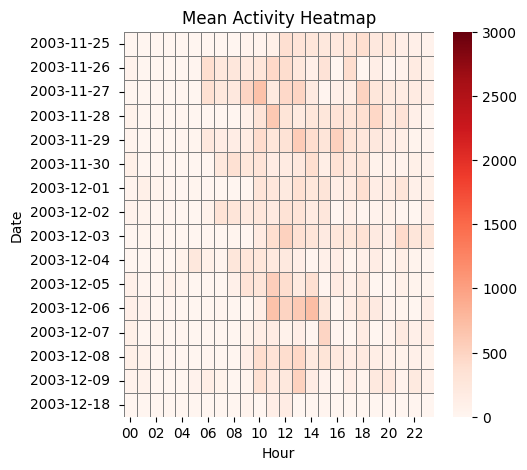

control 13
167.60180066050543 72.38246284828489 0.43187163003637985


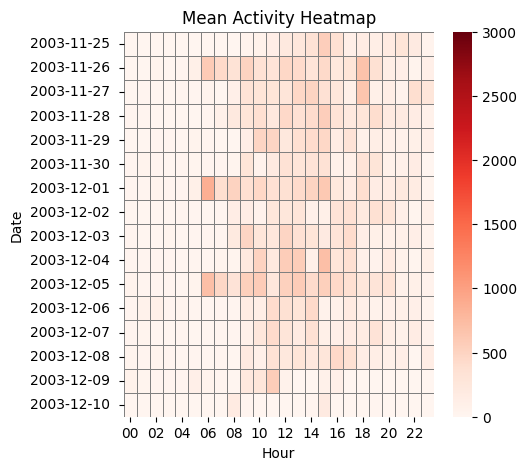

control 14
340.5419924662334 131.84265084342547 0.3871553398998169


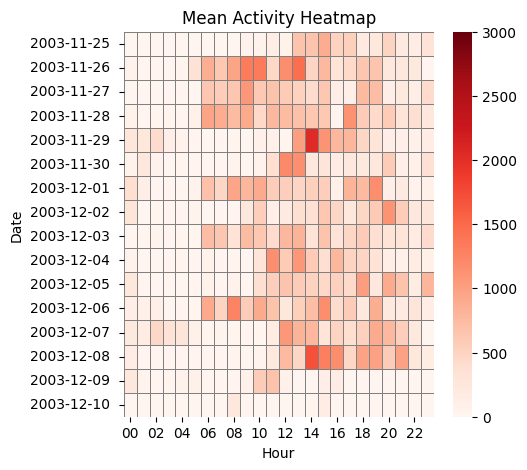

control 15
276.53937437222913 83.6260215404132 0.30240186132717006


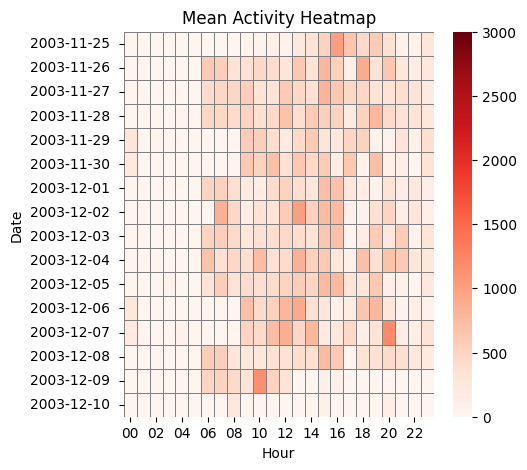

control 16
223.3359809027778 76.43915900252665 0.3422608336262754


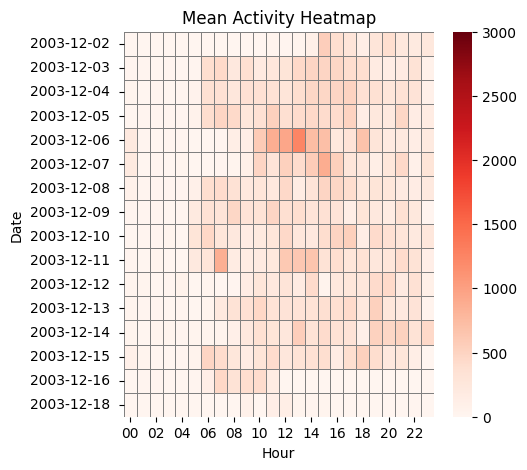

control 17
242.5123888888889 59.04908496641053 0.24348894189263404


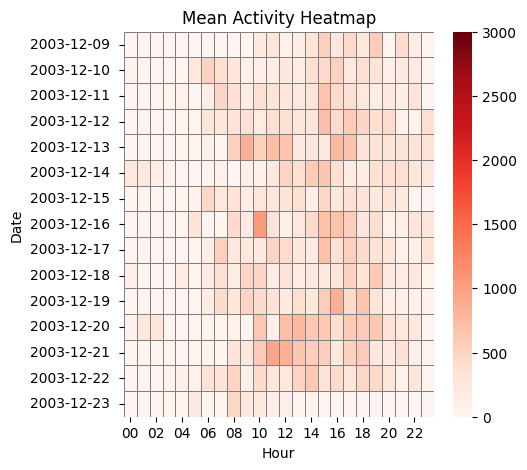

control 18
281.38470370370374 85.51238070136729 0.30389846916274194


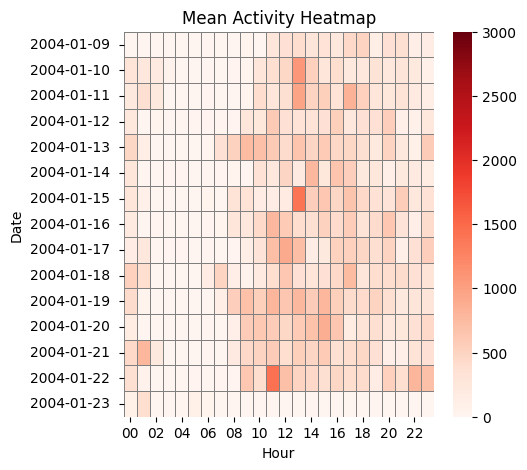

control 19
210.28086805555554 77.21910001028172 0.3672188569712423


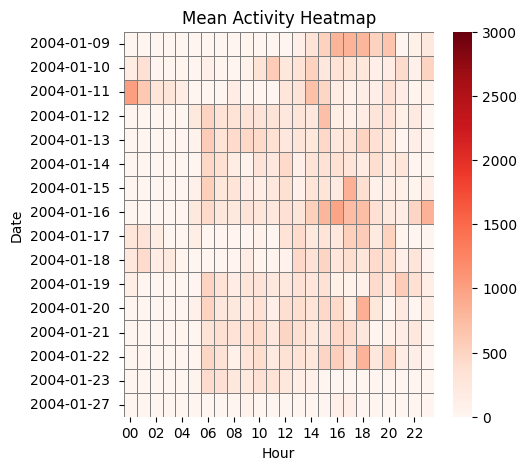

control 20
325.67359375 118.57870913642158 0.3641029282449203


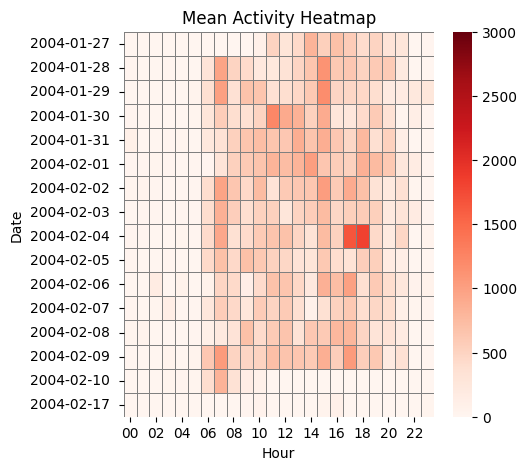

control 21
259.6540648148148 52.920986911883055 0.20381343519357686


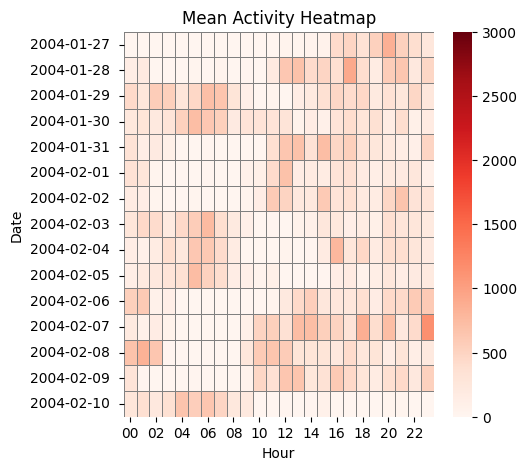

control 22
237.47491855759023 81.40666348365221 0.34280110075671094


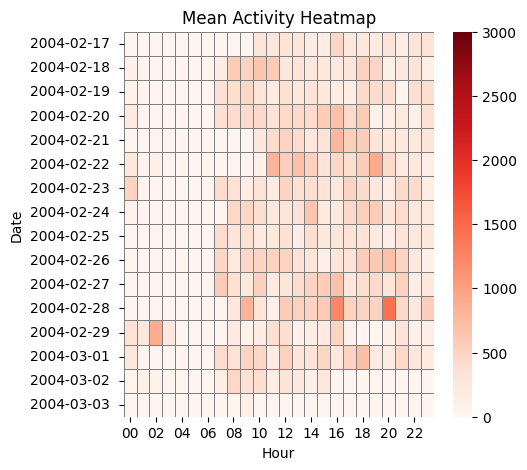

control 23
182.67355919207853 66.41988635495952 0.3635987969398461


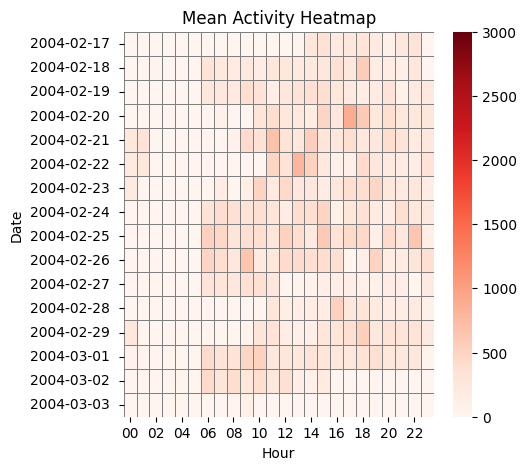

control 24
345.84165062354566 143.75431666513998 0.41566513578093844


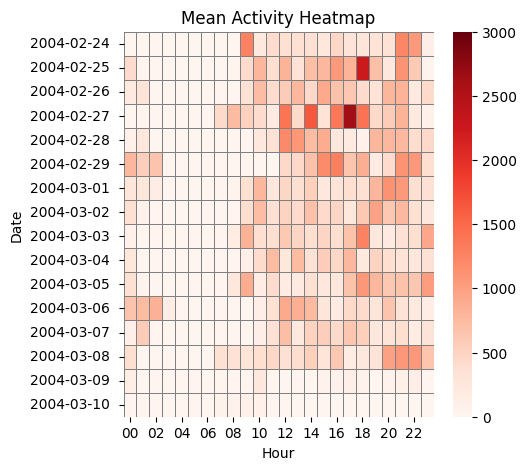

control 25
287.3137236376796 98.3041628541567 0.3421492075266281


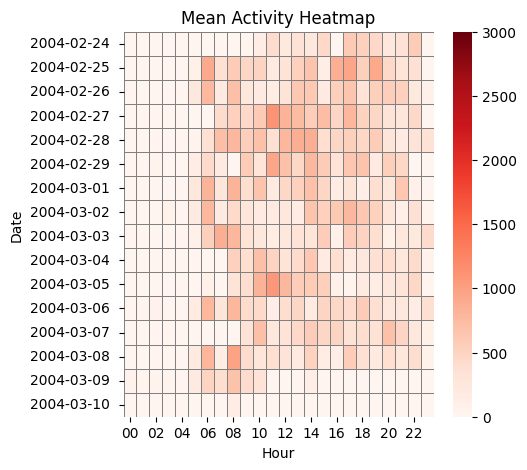

control 26
327.14053921568626 131.46846589768825 0.4018715204568703


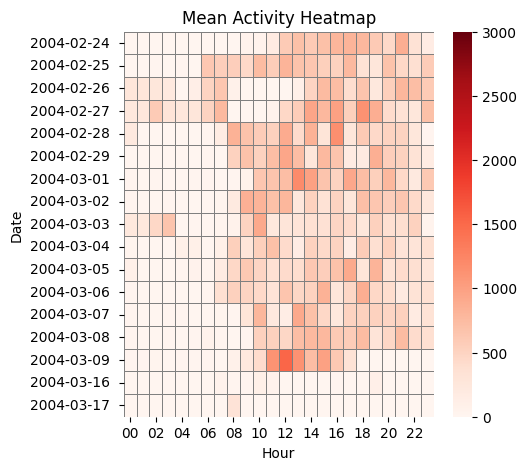

control 27
312.5035005824181 50.1608545799262 0.16051293661171975


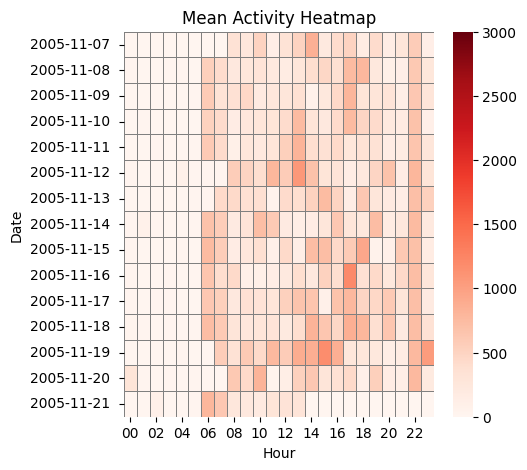

control 28
293.7711954768357 46.97813855337677 0.15991403948615196


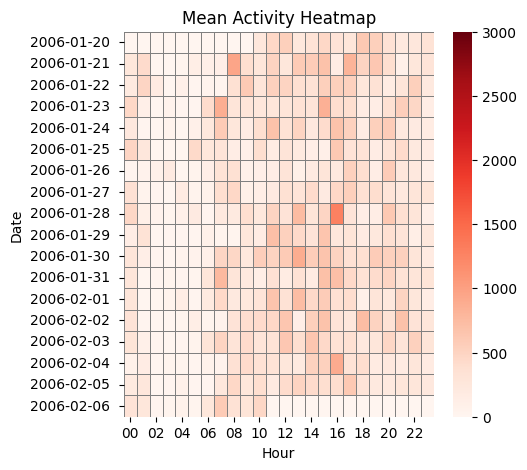

control 29
280.53187830687824 82.7685659320677 0.29504157043259754


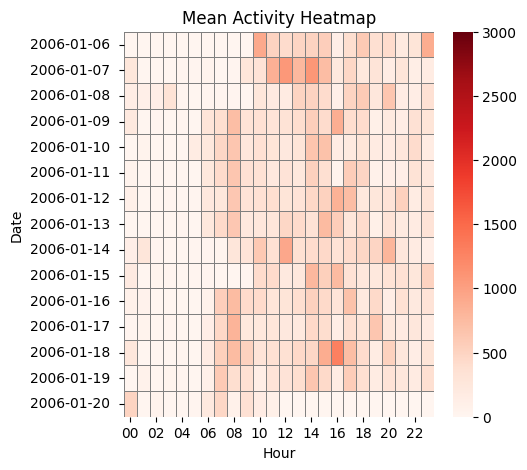

control 30
220.74739380109625 70.96899083945966 0.3214941278237969


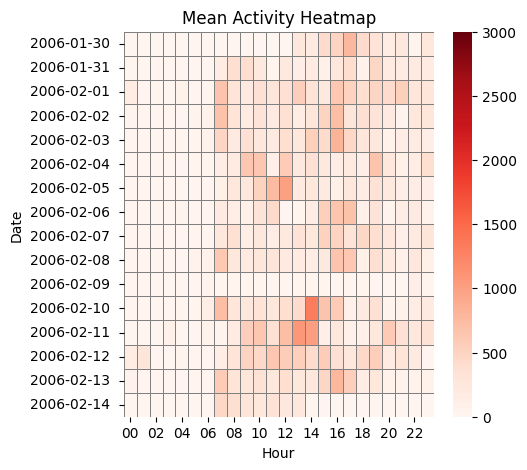

control 31
345.6777469135803 125.17389607881158 0.3621115249576802


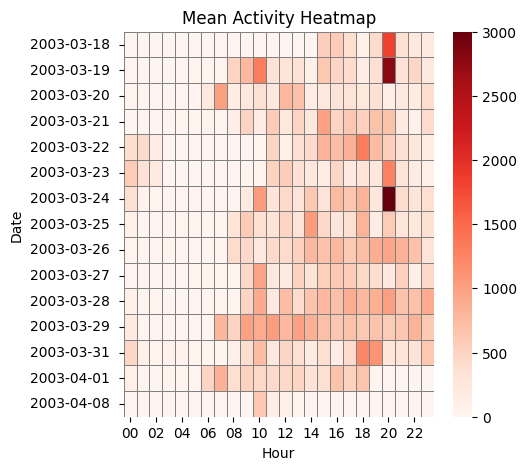

control 32
157.07702160493827 46.61145718496012 0.2967426852680706


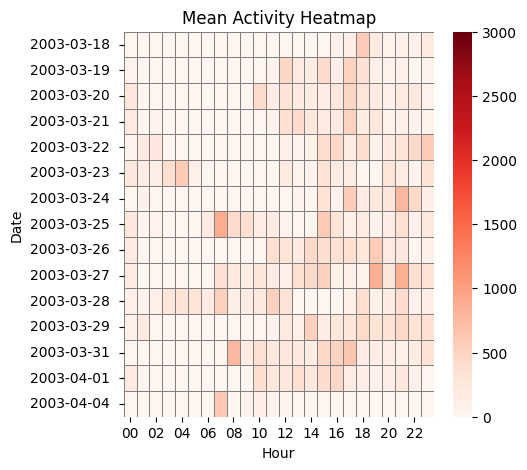

In [343]:
control_meanList =[]
control_stdList=[]
control_cvList=[]
control_days=[]


for i in range(1,33):
    control= pd.read_csv(data_path + f'control/control_{i}.csv')
    control['timestamp'] = pd.to_datetime(control['timestamp'])
    control['hour']=control['timestamp'].dt.strftime('%H')
    control_bydate = control.groupby(['date'], as_index=False).agg(
        n=pd.NamedAgg(column='activity', aggfunc='count'),
        mean_activity=pd.NamedAgg(column='activity', aggfunc='mean')
    )
#removing days with irrationally low average daily activity. 
    control_bydate= control_bydate[control_bydate.mean_activity>10]
    """
        Mixed effects modeling can handle Missing At Random (MAR) data, such as when the first and last days have missing data. 
        In this context, we know that the missing data on these days is due to individuals either wearing or removing their actigraph during those times, on account of completion of measurement for study. 
        However, this explanation doesn't apply to days in between when the actigraph is not recording data since we do not know why individuasls/actigraph stopped recording (MNAR)
    """
    control_bydate = control_bydate[(control_bydate.index==0) | (control_bydate.n==1440) | (control_bydate.index== len(control_bydate)-1)]
    mask = control['date'].isin(control_bydate['date'])
    control=control[mask]
    control['hour']=control['hour'].astype(str)
    control['date_hour']= control['date']+' '+control['hour']
    print(f'control {i}')
    #print(control)


    #extracting mean and std of daily means 
    daily_means = control_bydate.mean_activity.mean()
    daily_std = control_bydate.mean_activity.std()
    daily_cv = daily_std/daily_means
    print(daily_means, daily_std, daily_cv)

    control_meanList.append(daily_means)
    control_stdList.append(daily_std)
    control_cvList.append(daily_cv)
    control_days.append(len(control_bydate))

    control_byhour=control.groupby(['date_hour'], as_index=False).agg(
        n=pd.NamedAgg(column='activity', aggfunc='count'),
        mean_activity=pd.NamedAgg(column='activity', aggfunc='mean')
    )


    control_byhour['hour'] =control_byhour['date_hour'].str[-2:]
    control_byhour['date'] =control_byhour['date_hour'].str[:-2]

    
    pivot= control_byhour.pivot_table(index='date', columns='hour',values='mean_activity',fill_value=0)
    
    plt.figure(figsize=(5, 5))
    sns.heatmap(pivot, cmap='Reds', vmin=0, vmax=3000,linewidths=0.5, linecolor='grey')
    plt.title('Mean Activity Heatmap')
    plt.xlabel('Hour')
    plt.ylabel('Date')
    plt.show()
    







control 1
204.5947440087146 90.152720099063 0.440640450153612


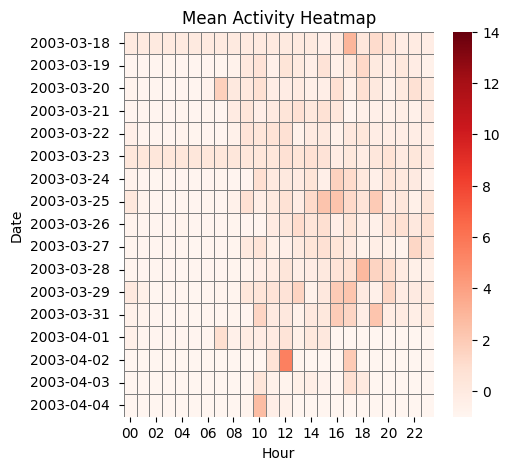

control 2
390.6049481617417 155.15734991788182 0.3972232063318211


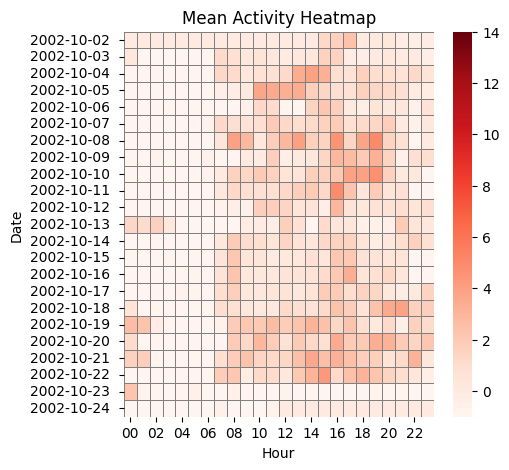

control 3
249.64126984126986 52.55853240538888 0.21053623240583308


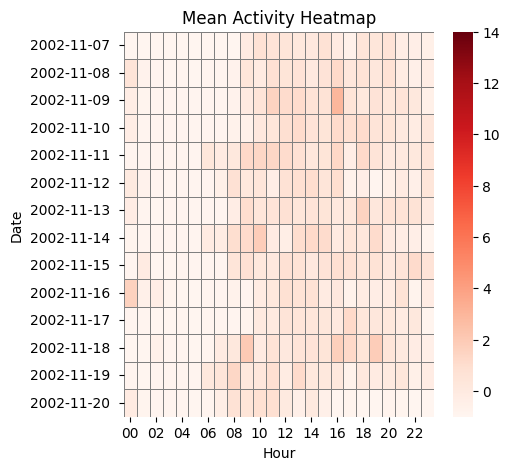

control 4
207.34075520833335 101.48235107724166 0.48944719515115825


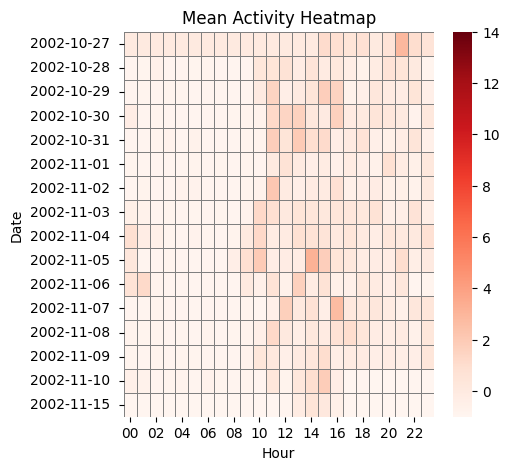

control 5
255.73461934156376 134.799683119062 0.5271076847793575


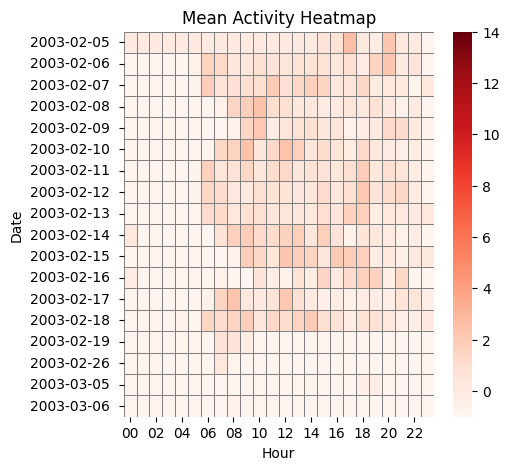

control 6
283.2560699588478 122.26168655061392 0.43162953778316715


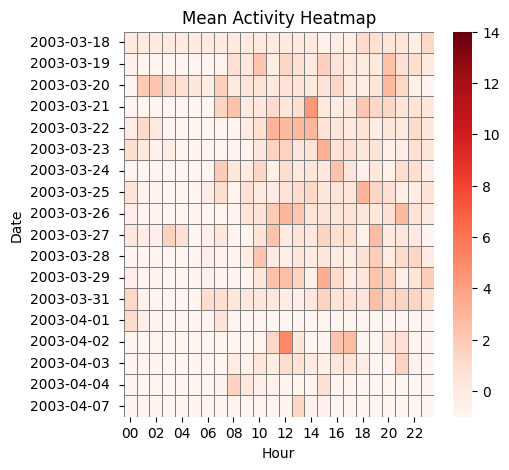

control 7
386.1467129629629 158.40897545913265 0.4102300243439503


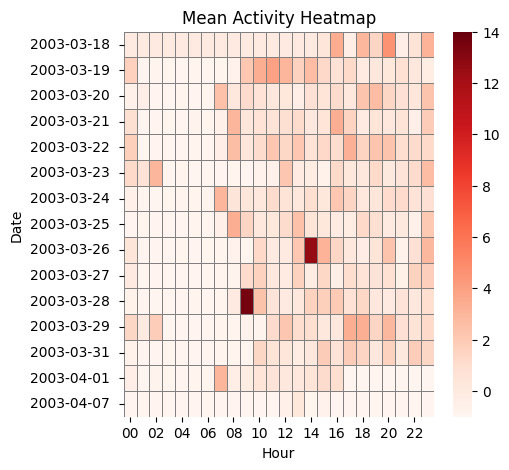

control 8
369.1949739583333 128.71897826894198 0.34864769931420836


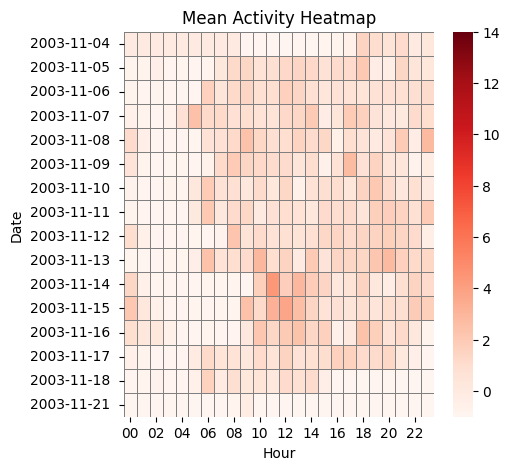

control 9
141.17037037037036 47.24162554990351 0.33464264084568024


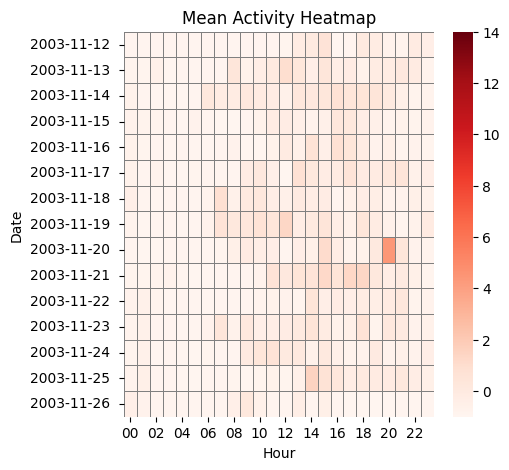

control 10
286.8015740740741 81.49577273558441 0.28415385445038027


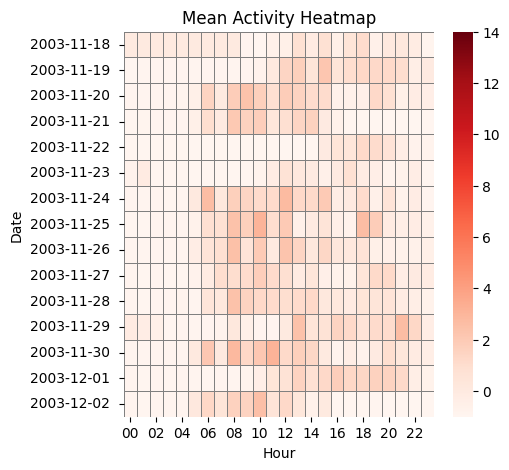

control 11
190.18353703703704 55.88752653553774 0.2938610113484954


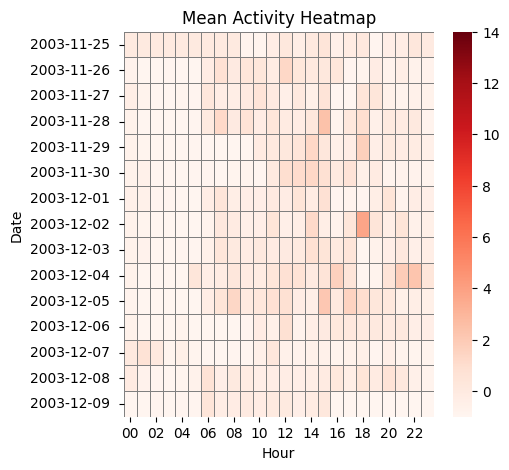

control 12
143.77953993055556 49.598455253238555 0.34496184420394055


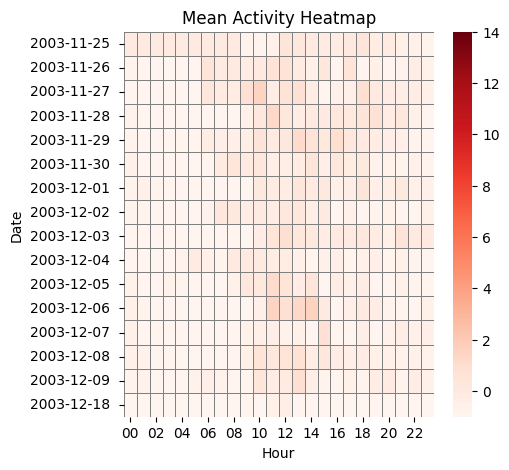

control 13
167.60180066050543 72.38246284828489 0.43187163003637985


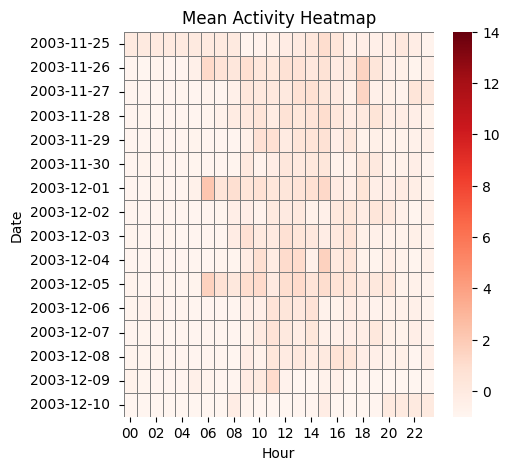

control 14
340.5419924662334 131.84265084342547 0.3871553398998169


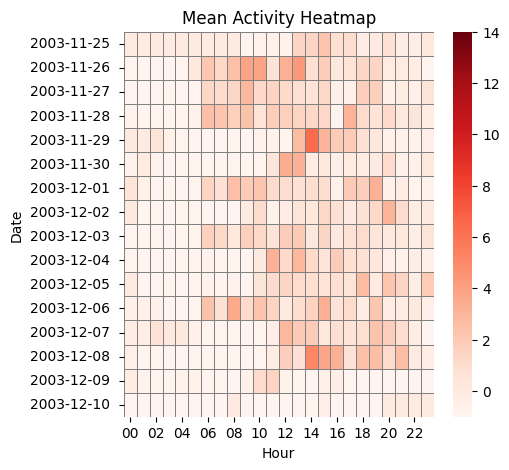

control 15
276.53937437222913 83.6260215404132 0.30240186132717006


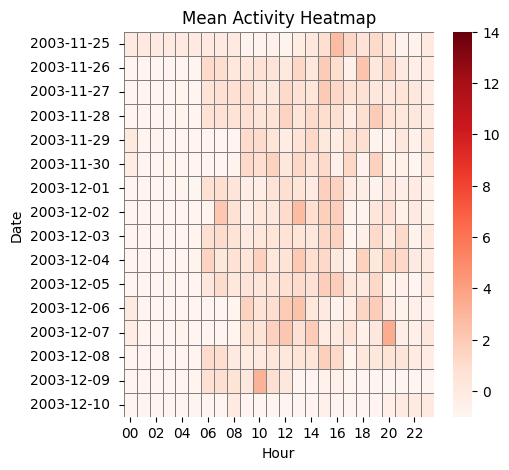

control 16
223.3359809027778 76.43915900252665 0.3422608336262754


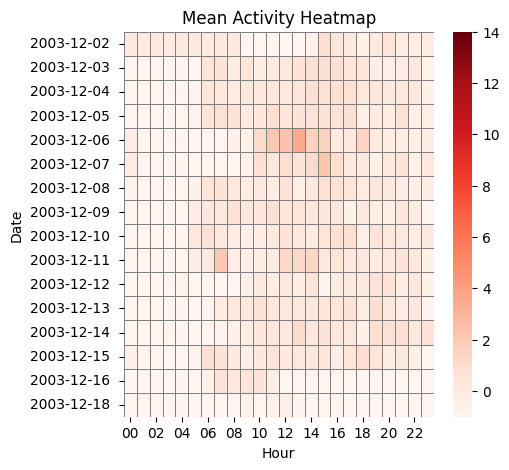

control 17
242.5123888888889 59.04908496641053 0.24348894189263404


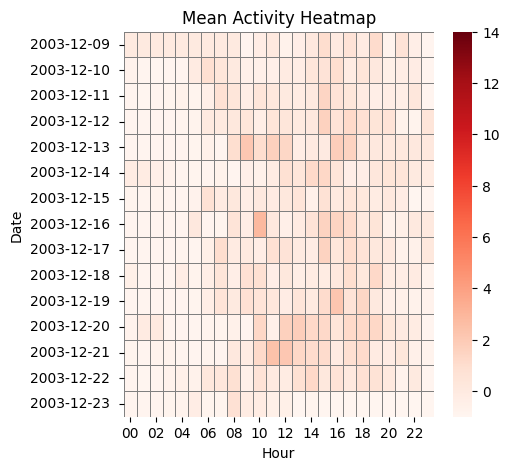

control 18
281.38470370370374 85.51238070136729 0.30389846916274194


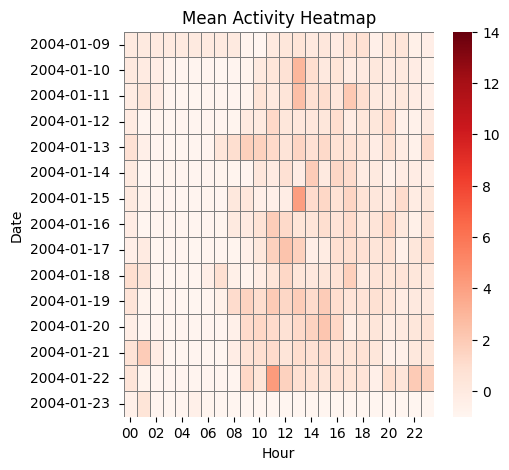

control 19
210.28086805555554 77.21910001028172 0.3672188569712423


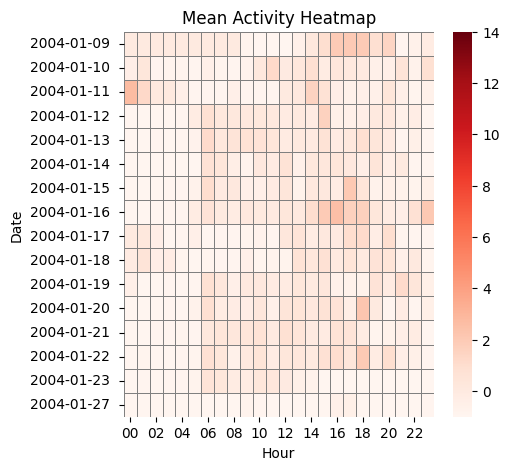

control 20
325.67359375 118.57870913642158 0.3641029282449203


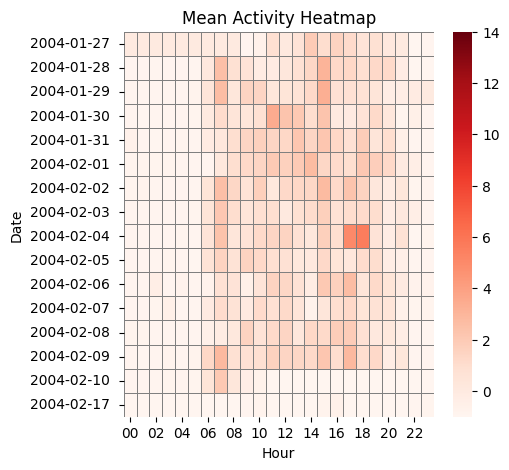

control 21
259.6540648148148 52.920986911883055 0.20381343519357686


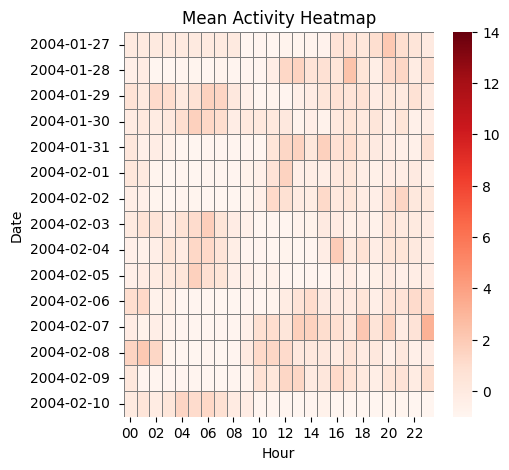

control 22
237.47491855759023 81.40666348365221 0.34280110075671094


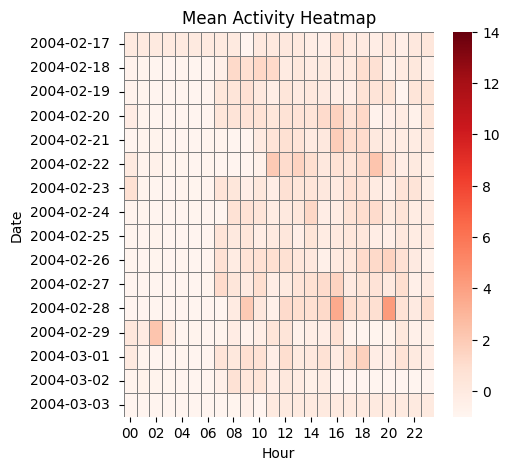

control 23
182.67355919207853 66.41988635495952 0.3635987969398461


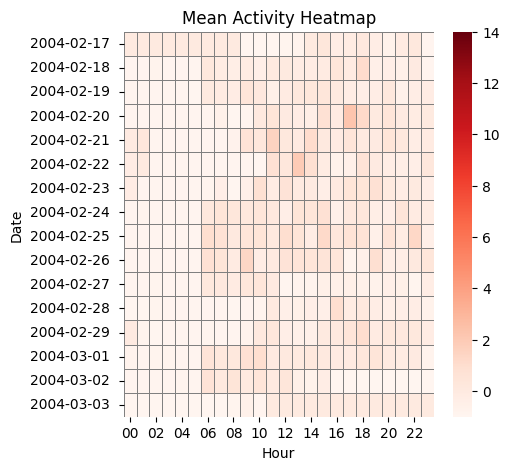

control 24
345.84165062354566 143.75431666513998 0.41566513578093844


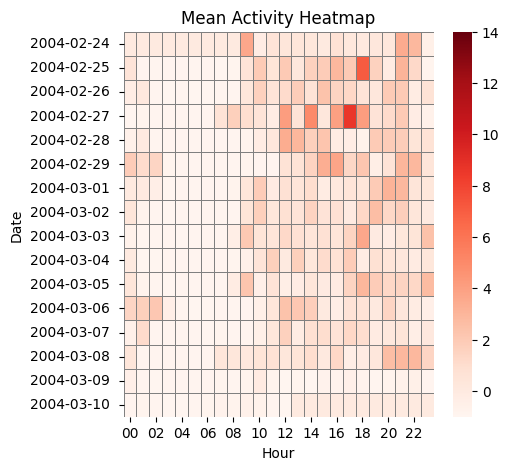

control 25
287.3137236376796 98.3041628541567 0.3421492075266281


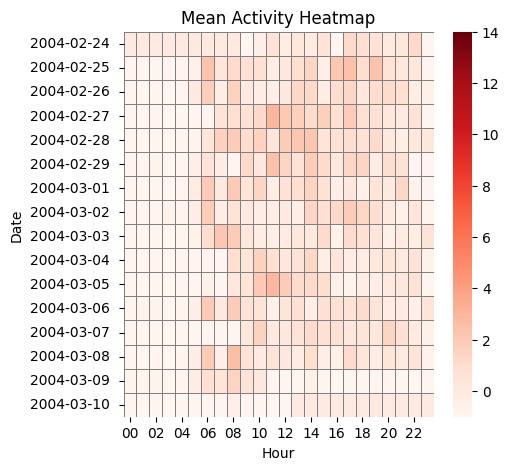

control 26
327.14053921568626 131.46846589768825 0.4018715204568703


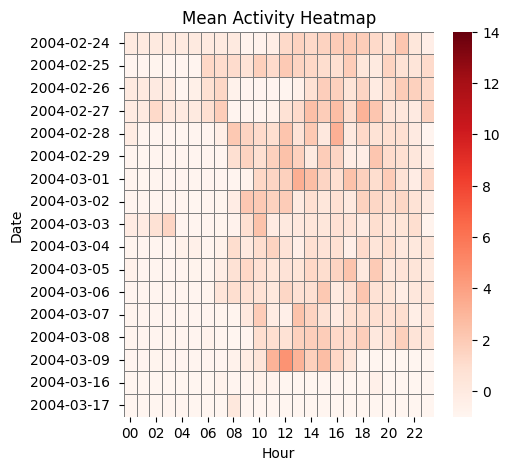

control 27
312.5035005824181 50.1608545799262 0.16051293661171975


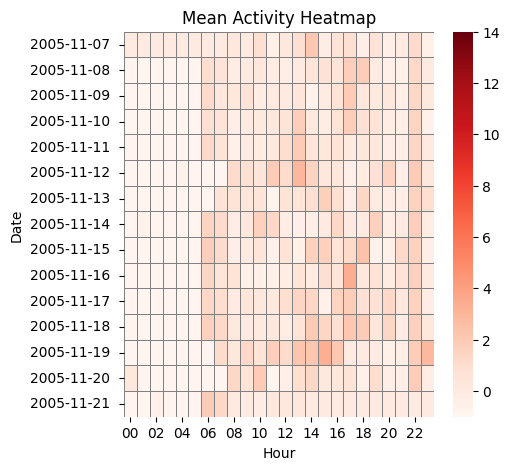

control 28
293.7711954768357 46.97813855337677 0.15991403948615196


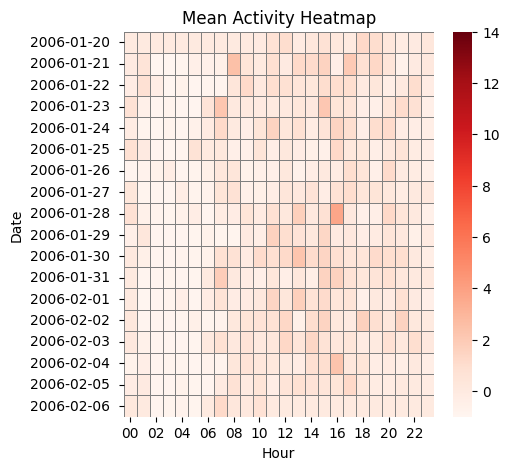

control 29
280.53187830687824 82.7685659320677 0.29504157043259754


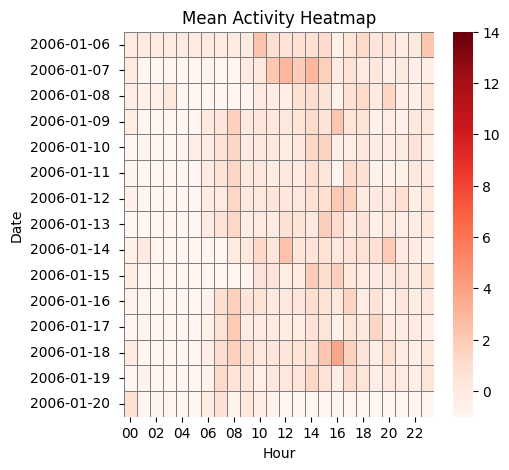

control 30
220.74739380109625 70.96899083945966 0.3214941278237969


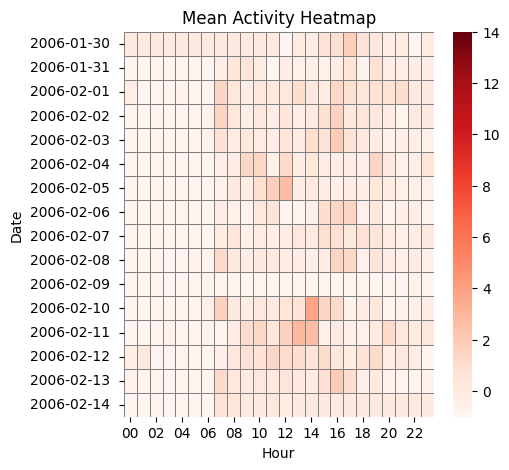

control 31
345.6777469135803 125.17389607881158 0.3621115249576802


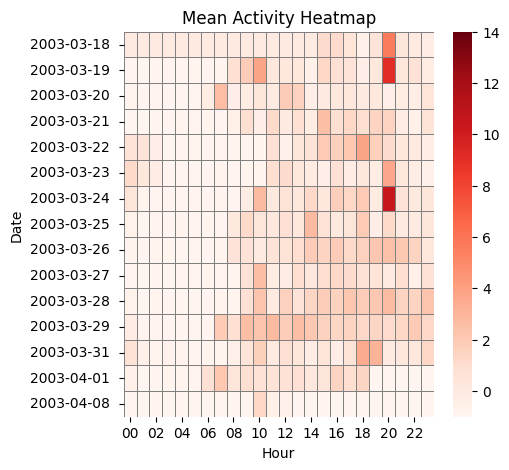

control 32
157.07702160493827 46.61145718496012 0.2967426852680706


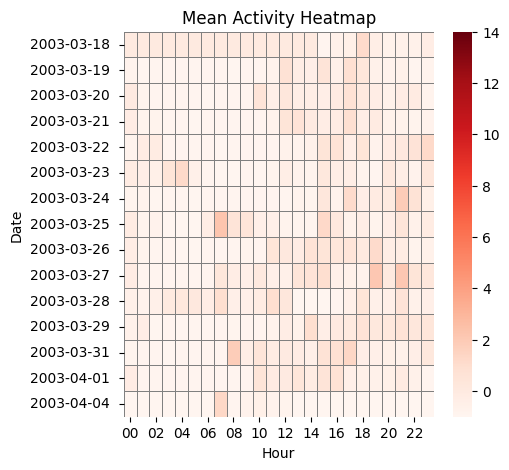

In [342]:
control_meanList =[]
control_stdList=[]
control_cvList=[]
control_days=[]


for i in range(1,33):
    control= pd.read_csv(data_path + f'control/control_{i}.csv')
    control['timestamp'] = pd.to_datetime(control['timestamp'])
    control['hour']=control['timestamp'].dt.strftime('%H')
    control_bydate = control.groupby(['date'], as_index=False).agg(
        n=pd.NamedAgg(column='activity', aggfunc='count'),
        mean_activity=pd.NamedAgg(column='activity', aggfunc='mean')
    )
#removing days with irrationally low average daily activity. 
    control_bydate= control_bydate[control_bydate.mean_activity>10]
    """
        Mixed effects modeling can handle Missing At Random (MAR) data, such as when the first and last days have missing data. 
        In this context, we know that the missing data on these days is due to individuals either wearing or removing their actigraph during those times, on account of completion of measurement for study. 
        However, this explanation doesn't apply to days in between when the actigraph is not recording data since we do not know why individuasls/actigraph stopped recording (MNAR)
    """
    control_bydate = control_bydate[(control_bydate.index==0) | (control_bydate.n==1440) | (control_bydate.index== len(control_bydate)-1)]
    mask = control['date'].isin(control_bydate['date'])
    control=control[mask]
    control['hour']=control['hour'].astype(str)
    control['date_hour']= control['date']+' '+control['hour']
    print(f'control {i}')
    #print(control)


    #extracting mean and std of daily means 
    daily_means = control_bydate.mean_activity.mean()
    daily_std = control_bydate.mean_activity.std()
    daily_cv = daily_std/daily_means
    print(daily_means, daily_std, daily_cv)

    control_meanList.append(daily_means)
    control_stdList.append(daily_std)
    control_cvList.append(daily_cv)
    control_days.append(len(control_bydate))

    control_byhour=control.groupby(['date_hour'], as_index=False).agg(
        n=pd.NamedAgg(column='activity', aggfunc='count'),
        mean_activity=pd.NamedAgg(column='activity', aggfunc='mean')
    )


    control_byhour['hour'] =control_byhour['date_hour'].str[-2:]
    control_byhour['date'] =control_byhour['date_hour'].str[:-2]

    
    # Z-score normalization
    control_byhour['normalized_mean_activity'] = (
    control_byhour['mean_activity'] - mean_control) / std_control
    pivot= control_byhour.pivot_table(index='date', columns='hour',values='normalized_mean_activity',fill_value=0)
    
    plt.figure(figsize=(5, 5))
    sns.heatmap(pivot, cmap='Reds', vmin=-1, vmax=14,linewidths=0.5, linecolor='grey')
    plt.title('Mean Activity Heatmap')
    plt.xlabel('Hour')
    plt.ylabel('Date')
    plt.show()
    







In [ ]:
condition_meanList =[]
condition_stdList=[]
condition_cvList=[]
condition_days=[]

all_condition_data=pd.DataFrame()

for i in range(1,24):
    control= pd.read_csv(data_path + f'condition/condition_{i}.csv')
    control['timestamp'] = pd.to_datetime(control['timestamp'])
    control['hour']=control['timestamp'].dt.strftime('%H')
    control_bydate = control.groupby(['date'], as_index=False).agg(
        n=pd.NamedAgg(column='activity', aggfunc='count'),
        mean_activity=pd.NamedAgg(column='activity', aggfunc='mean')
    )
#removing days with irrationally low average daily activity. 
    control_bydate= control_bydate[control_bydate.mean_activity>10]
    """
        Mixed effects modeling can handle Missing At Random (MAR) data, such as when the first and last days have missing data. 
        In this context, we know that the missing data on these days is due to individuals either wearing or removing their actigraph during those times, on account of completion of measurement for study. 
        However, this explanation doesn't apply to days in between when the actigraph is not recording data since we do not know why individuasls/actigraph stopped recording (MNAR)
    """
    control_bydate = control_bydate[(control_bydate.index==0) | (control_bydate.n==1440) | (control_bydate.index== len(control_bydate)-1)]
    mask = control['date'].isin(control_bydate['date'])
    control=control[mask]
    control['hour']=control['hour'].astype(str)
    control['date_hour']= control['date']+' '+control['hour']
    print(f'condition {i}')
    #print(control_bydate)

    #extracting mean and std of daily means 
    daily_means = control_bydate.mean_activity.mean()
    daily_std = control_bydate.mean_activity.std()
    daily_cv = daily_std/daily_means
    print(daily_means, daily_std, daily_cv)

    condition_meanList.append(daily_means)
    condition_stdList.append(daily_std)
    condition_cvList.append(daily_cv)
    condition_days.append(len(control_bydate))



    control_byhour=control.groupby(['date_hour'], as_index=False).agg(
        n=pd.NamedAgg(column='activity', aggfunc='count'),
        mean_activity=pd.NamedAgg(column='activity', aggfunc='mean')
    )

    control_byhour['hour'] =control_byhour['date_hour'].str[-2:]
    control_byhour['date'] =control_byhour['date_hour'].str[:-2]

    if i==1:
        all_condition_data=control_byhour
    else:
        all_condition_data = pd.concat([all_condition_data, control_byhour], axis=0)
    
    print(all_condition_data)
    




In [336]:
condition_mean=all_condition_data.mean_activity.mean()
condition_std=all_condition_data.mean_activity.std()

In [337]:
max((all_condition_data.mean_activity-condition_mean)/condition_std)


8.98288965970256

In [338]:
min((all_condition_data.mean_activity-condition_mean)/condition_std)

-0.8048426934806786

condition 1
153.57118055555557 57.47270455421182 0.374241471259776


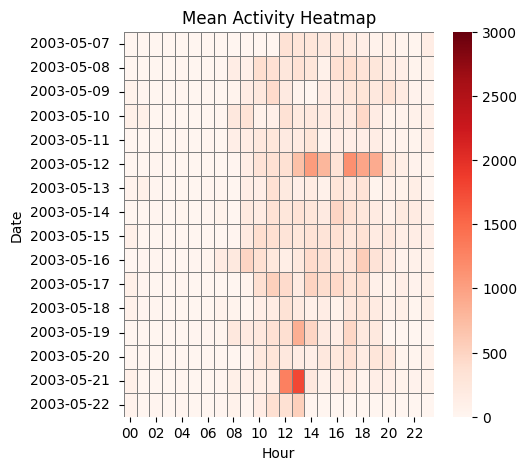

condition 2
204.39920138888888 84.56476906835505 0.41372357863308157


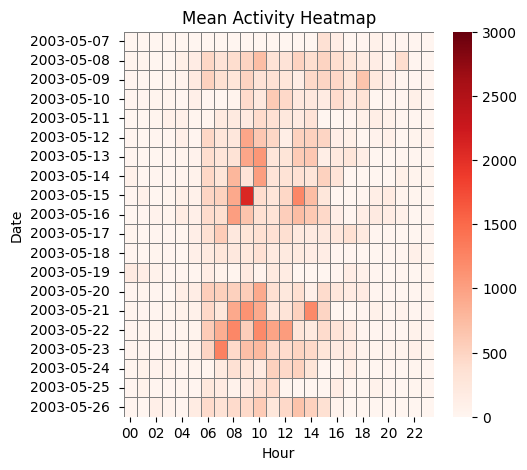

condition 3
251.41300838021564 99.49827357689105 0.3957562666225223


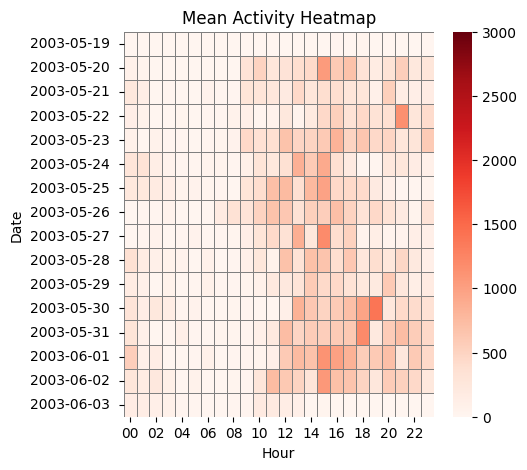

condition 4
264.0550610287602 169.74623820251188 0.6428441005492547


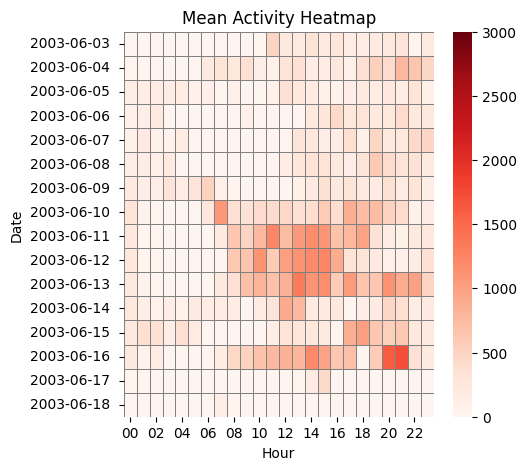

condition 5
160.29643624190035 58.416831655959754 0.36443000871088616


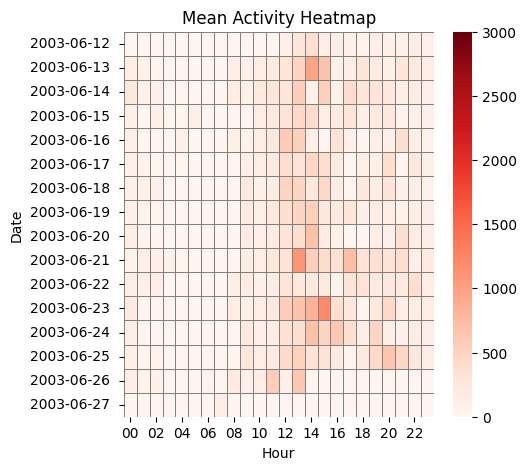

condition 6
207.52944444444444 62.011047118894446 0.2988060189959926


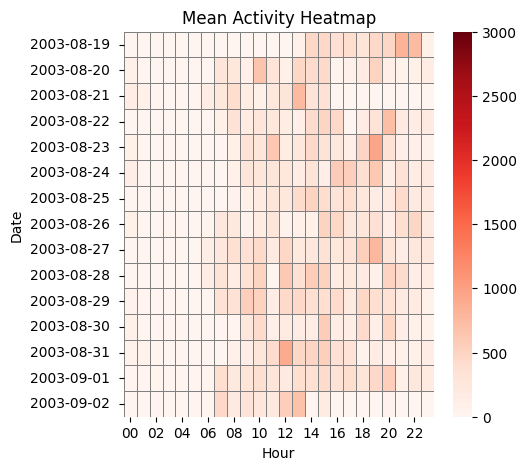

condition 7
292.454797335601 143.41498916225706 0.49038343863336903


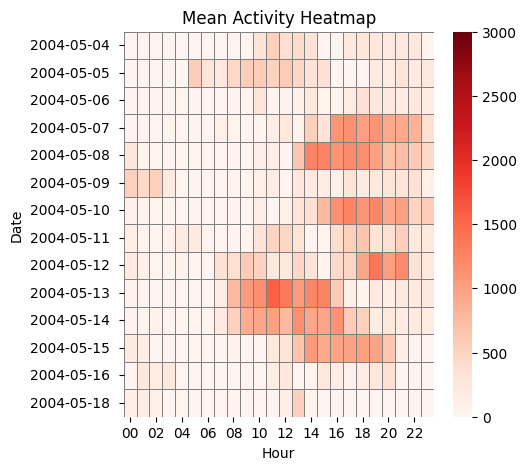

condition 8
210.95121527777778 97.76845890398845 0.4634647815384625


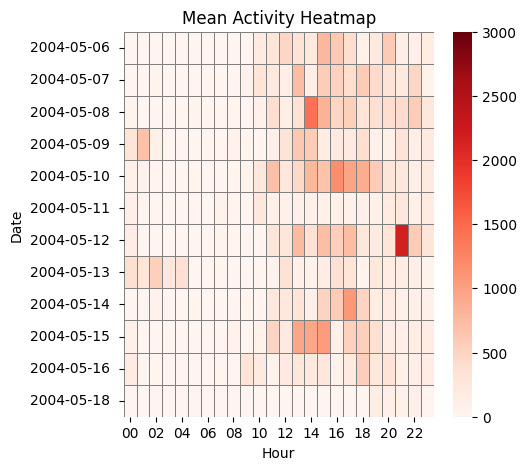

condition 9
181.74485212851235 45.43002258754523 0.2499659388174666


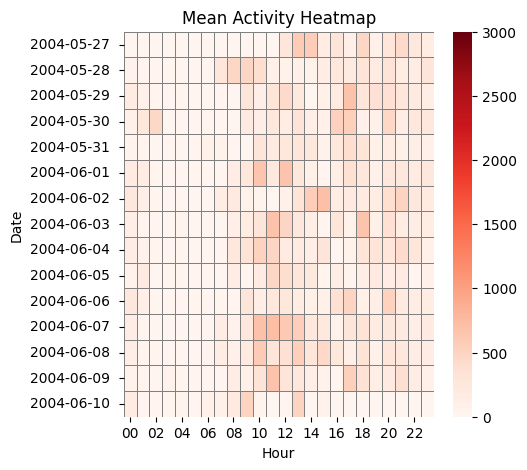

condition 10
278.4107417929293 105.53696606870106 0.3790693038244739


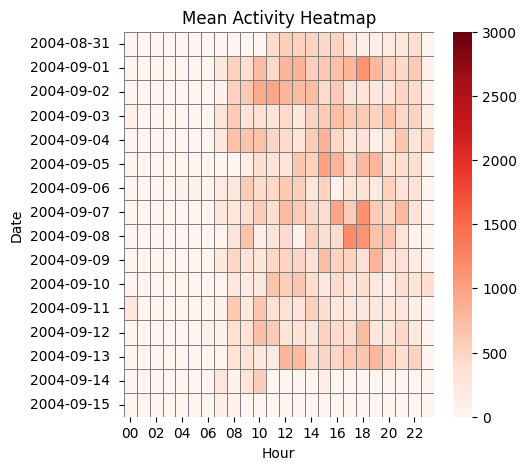

condition 11
126.38927582306133 67.14355833000587 0.5312441098563101


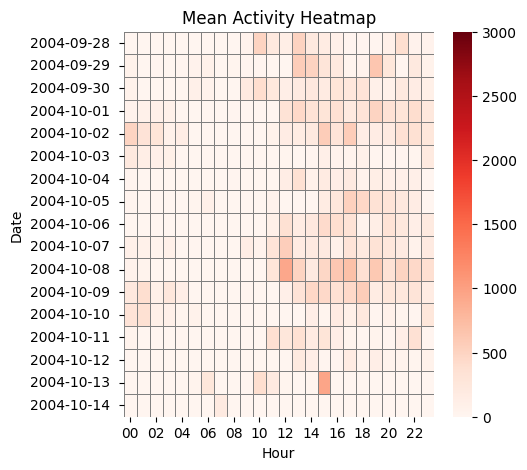

condition 12
164.67208994708997 77.66515078053429 0.47163517998398224


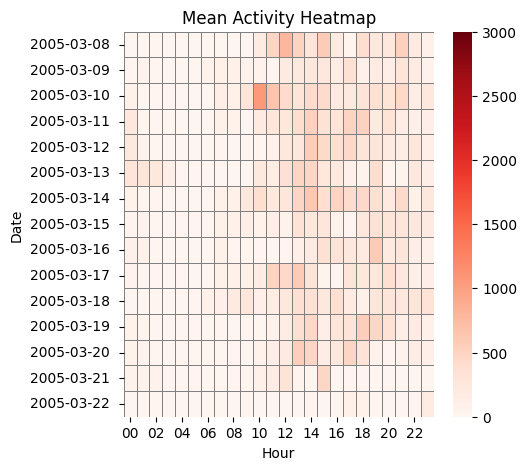

condition 13
257.03157986111114 70.01554823688971 0.2724005675673126


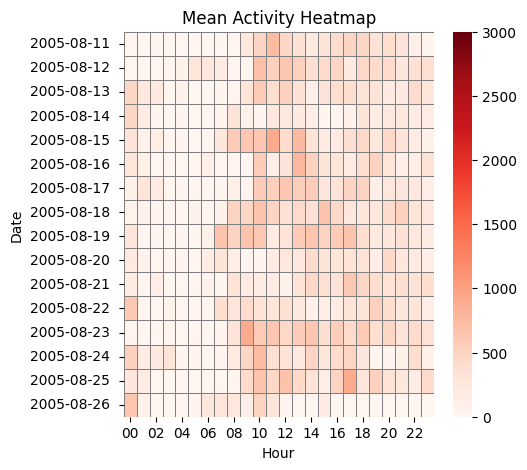

condition 14
79.69122427983538 32.82039266334811 0.4118445030797801


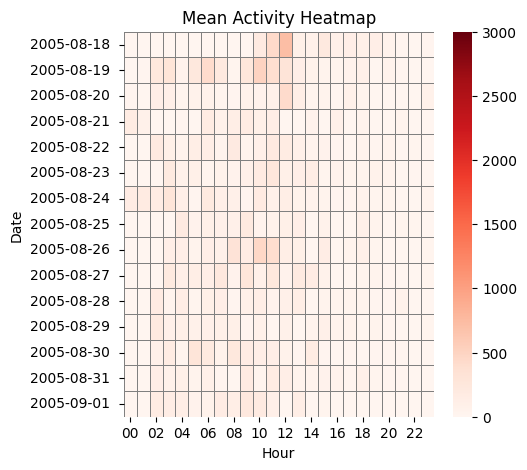

condition 15
115.88603835978837 62.20940343166353 0.5368153430055449


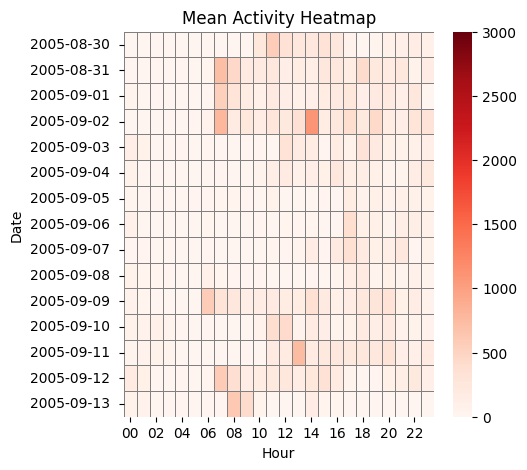

condition 16
231.41498538011695 79.54320924327605 0.3437254035758324


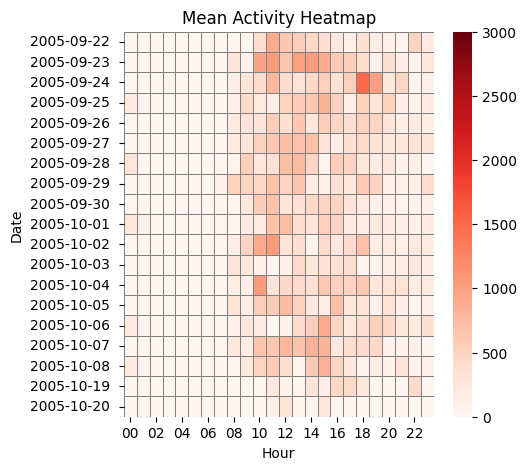

condition 17
83.88986642376167 18.170832371138548 0.21660342477302702


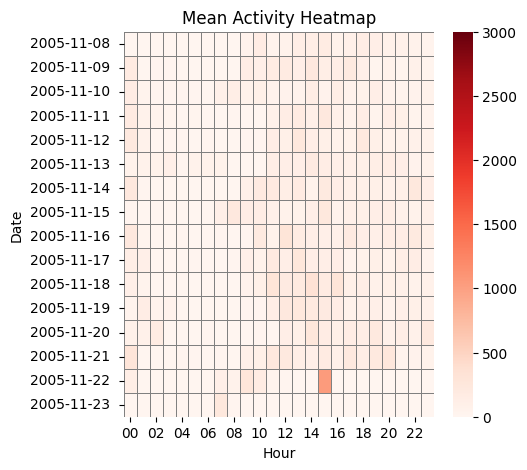

condition 18
69.79829791703118 18.706268990368663 0.2680046584030558


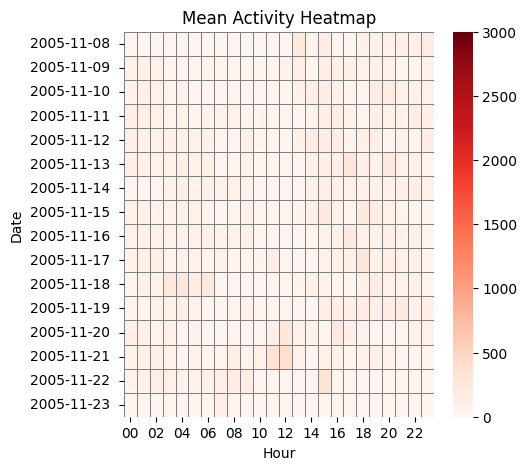

condition 19
161.6688425925926 69.76502045317771 0.4315304008762306


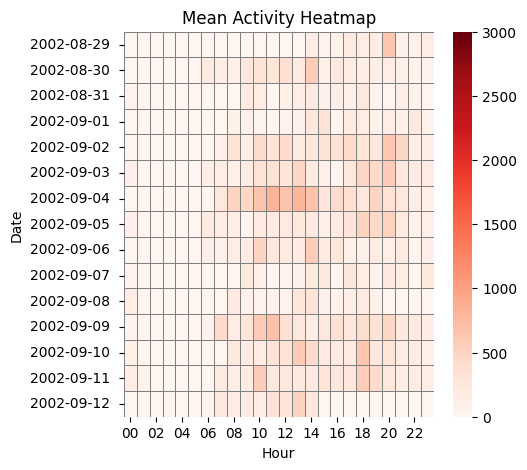

condition 20
69.48783518518518 23.377406776184483 0.3364244506089974


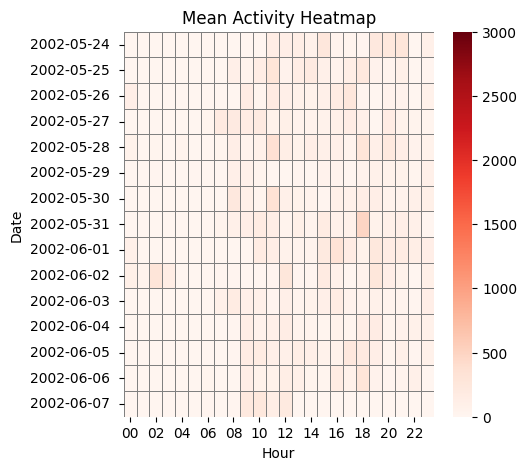

condition 21
80.34618077706429 20.860040415914124 0.25962703160457945


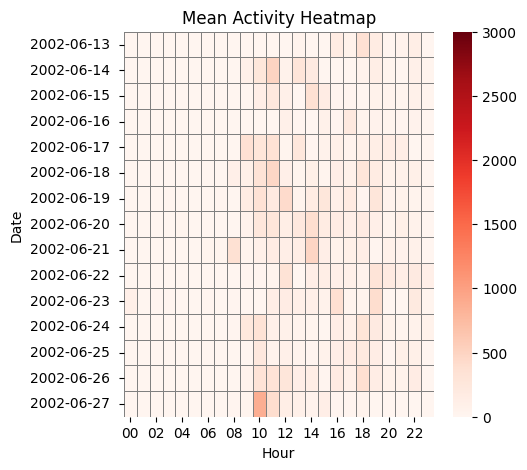

condition 22
161.58069405833902 43.171804506657715 0.2671841754255026


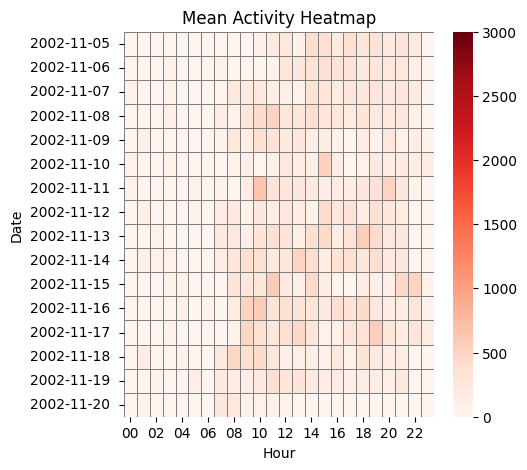

condition 23
261.01777146464644 84.48967655978542 0.3236931956230004


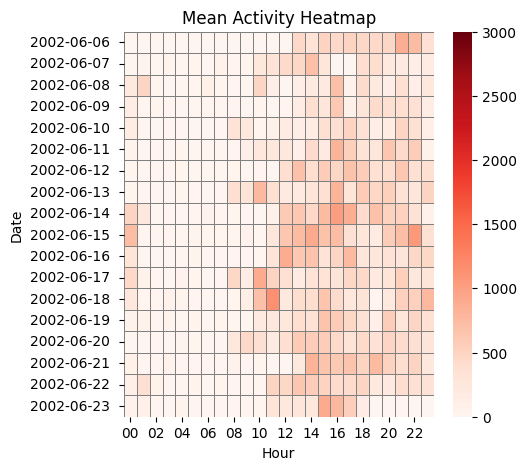

In [344]:
condition_meanList =[]
condition_stdList=[]
condition_cvList=[]
condition_days=[]

all_condition_data=pd.DataFrame()

for i in range(1,24):
    control= pd.read_csv(data_path + f'condition/condition_{i}.csv')
    control['timestamp'] = pd.to_datetime(control['timestamp'])
    control['hour']=control['timestamp'].dt.strftime('%H')
    control_bydate = control.groupby(['date'], as_index=False).agg(
        n=pd.NamedAgg(column='activity', aggfunc='count'),
        mean_activity=pd.NamedAgg(column='activity', aggfunc='mean')
    )
#removing days with irrationally low average daily activity. 
    control_bydate= control_bydate[control_bydate.mean_activity>10]
    """
        Mixed effects modeling can handle Missing At Random (MAR) data, such as when the first and last days have missing data. 
        In this context, we know that the missing data on these days is due to individuals either wearing or removing their actigraph during those times, on account of completion of measurement for study. 
        However, this explanation doesn't apply to days in between when the actigraph is not recording data since we do not know why individuasls/actigraph stopped recording (MNAR)
    """
    control_bydate = control_bydate[(control_bydate.index==0) | (control_bydate.n==1440) | (control_bydate.index== len(control_bydate)-1)]
    mask = control['date'].isin(control_bydate['date'])
    control=control[mask]
    control['hour']=control['hour'].astype(str)
    control['date_hour']= control['date']+' '+control['hour']
    print(f'condition {i}')
    #print(control_bydate)

    #extracting mean and std of daily means 
    daily_means = control_bydate.mean_activity.mean()
    daily_std = control_bydate.mean_activity.std()
    daily_cv = daily_std/daily_means
    print(daily_means, daily_std, daily_cv)

    condition_meanList.append(daily_means)
    condition_stdList.append(daily_std)
    condition_cvList.append(daily_cv)
    condition_days.append(len(control_bydate))



    control_byhour=control.groupby(['date_hour'], as_index=False).agg(
        n=pd.NamedAgg(column='activity', aggfunc='count'),
        mean_activity=pd.NamedAgg(column='activity', aggfunc='mean')
    )

    control_byhour['hour'] =control_byhour['date_hour'].str[-2:]
    control_byhour['date'] =control_byhour['date_hour'].str[:-2]

    if i==1:
        all_condition_data=control_byhour
    else:
        all_condition_data = pd.concat([all_condition_data, control_byhour], axis=0)
    
    

    pivot= control_byhour.pivot_table(index='date', columns='hour',values='mean_activity',fill_value=0)


    #print(control_byhour)

    plt.figure(figsize=(5, 5))
    sns.heatmap(pivot, cmap='Reds', vmin=0, vmax=3000,linewidths=0.5, linecolor='grey')
    plt.title('Mean Activity Heatmap')
    plt.xlabel('Hour')
    plt.ylabel('Date')
    plt.show()




In [345]:
control

,timestamp,date,activity,hour,date_hour
0,2002-06-06 13:00:00,2002-06-06,161,13,2002-06-06 13
1,2002-06-06 13:01:00,2002-06-06,80,13,2002-06-06 13
2,2002-06-06 13:02:00,2002-06-06,175,13,2002-06-06 13
3,2002-06-06 13:03:00,2002-06-06,728,13,2002-06-06 13
4,2002-06-06 13:04:00,2002-06-06,911,13,2002-06-06 13
...,...,...,...,...,...
25135,2002-06-23 23:55:00,2002-06-23,0,23,2002-06-23 23
25136,2002-06-23 23:56:00,2002-06-23,0,23,2002-06-23 23
25137,2002-06-23 23:57:00,2002-06-23,0,23,2002-06-23 23
25138,2002-06-23 23:58:00,2002-06-23,0,23,2002-06-23 23


condition 1
153.57118055555557 57.47270455421182 0.374241471259776


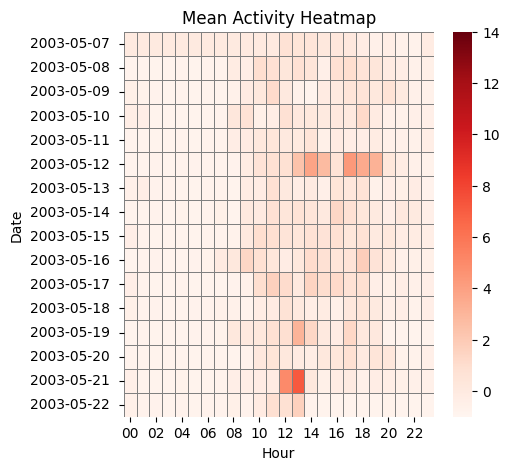

condition 2
204.39920138888888 84.56476906835505 0.41372357863308157


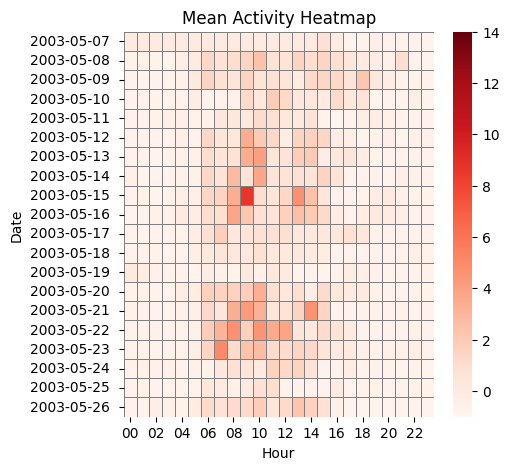

condition 3
251.41300838021564 99.49827357689105 0.3957562666225223


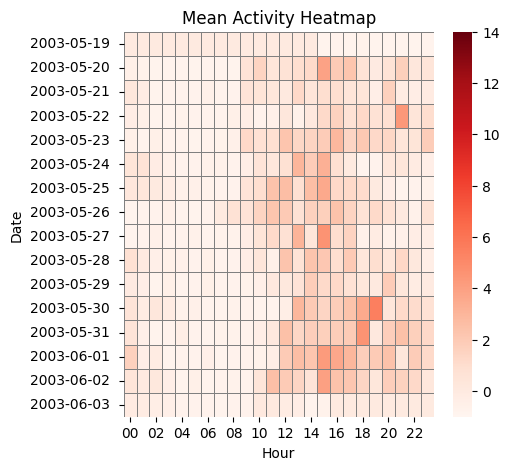

condition 4
264.0550610287602 169.74623820251188 0.6428441005492547


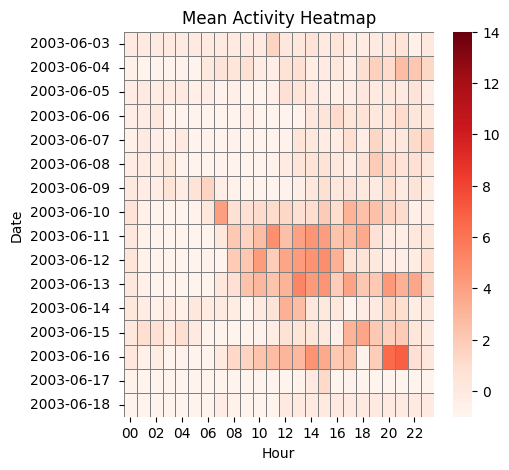

condition 5
160.29643624190035 58.416831655959754 0.36443000871088616


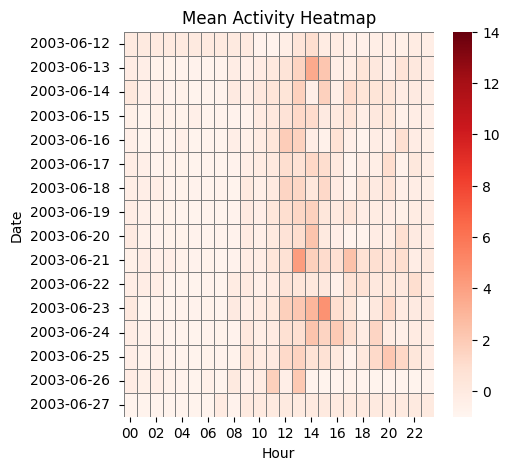

condition 6
207.52944444444444 62.011047118894446 0.2988060189959926


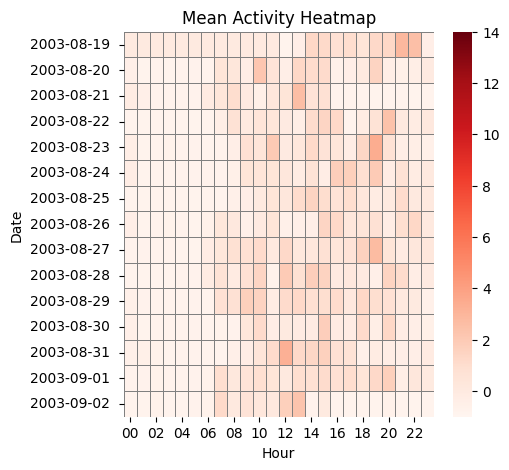

condition 7
292.454797335601 143.41498916225706 0.49038343863336903


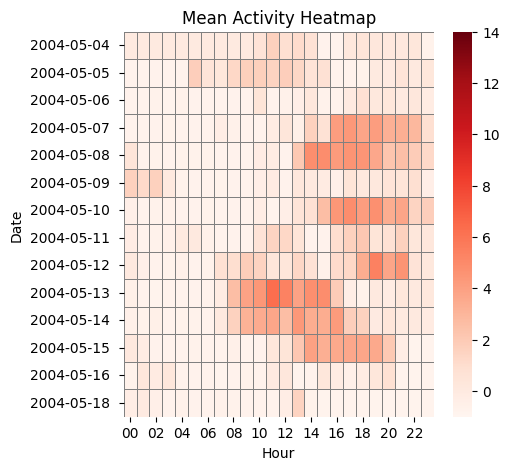

condition 8
210.95121527777778 97.76845890398845 0.4634647815384625


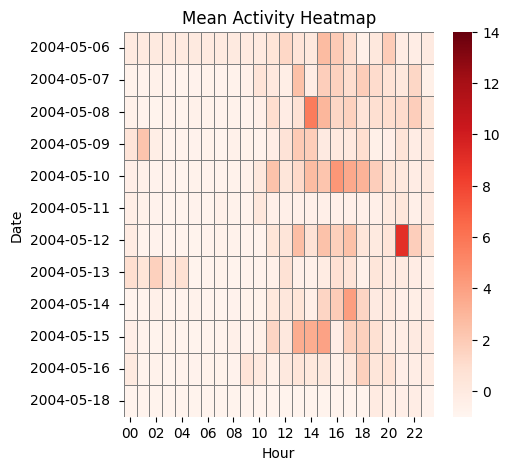

condition 9
181.74485212851235 45.43002258754523 0.2499659388174666


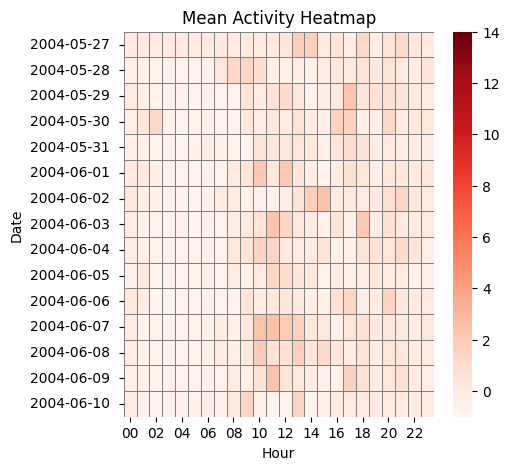

condition 10
278.4107417929293 105.53696606870106 0.3790693038244739


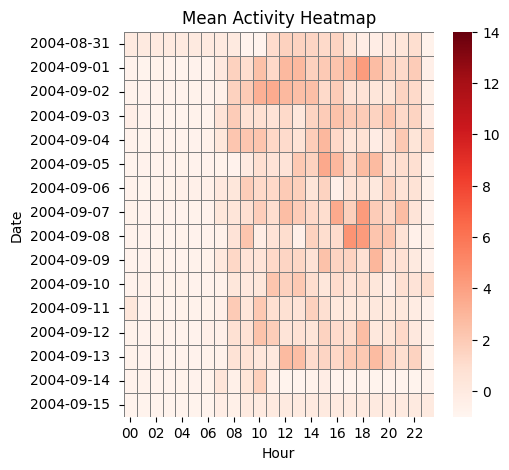

condition 11
126.38927582306133 67.14355833000587 0.5312441098563101


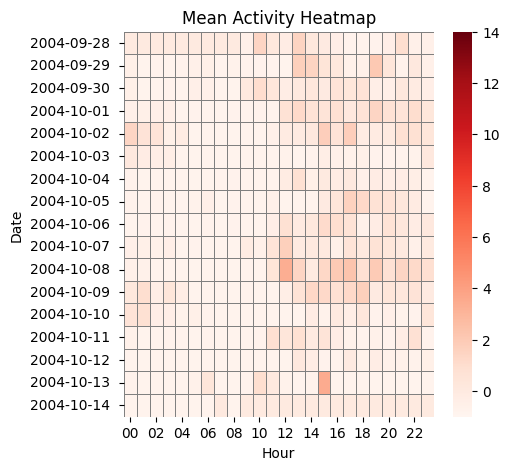

condition 12
164.67208994708997 77.66515078053429 0.47163517998398224


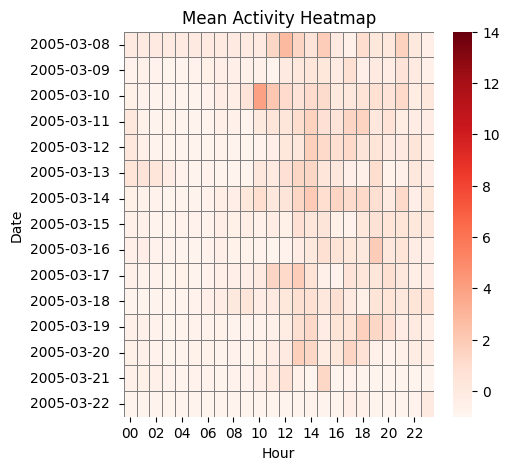

condition 13
257.03157986111114 70.01554823688971 0.2724005675673126


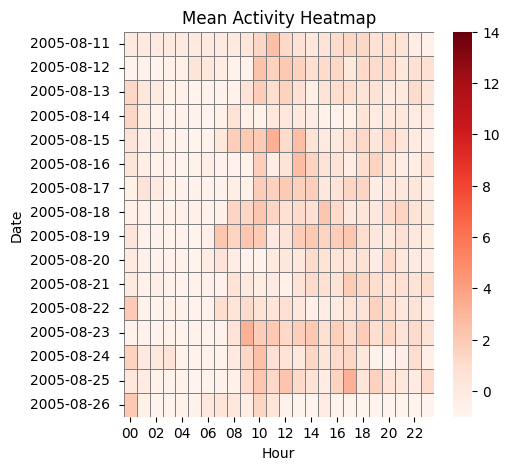

condition 14
79.69122427983538 32.82039266334811 0.4118445030797801


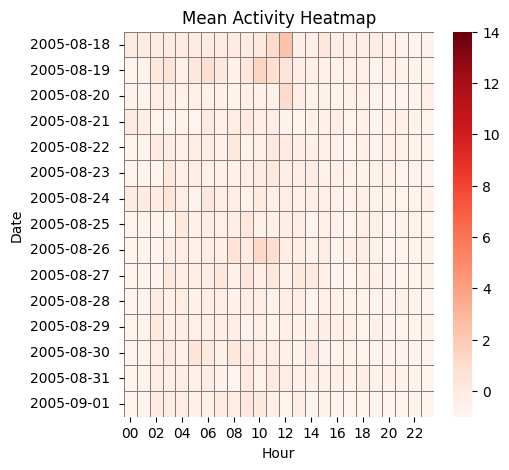

condition 15
115.88603835978837 62.20940343166353 0.5368153430055449


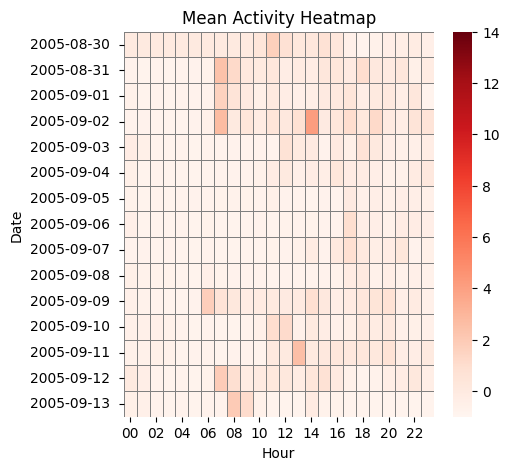

condition 16
231.41498538011695 79.54320924327605 0.3437254035758324


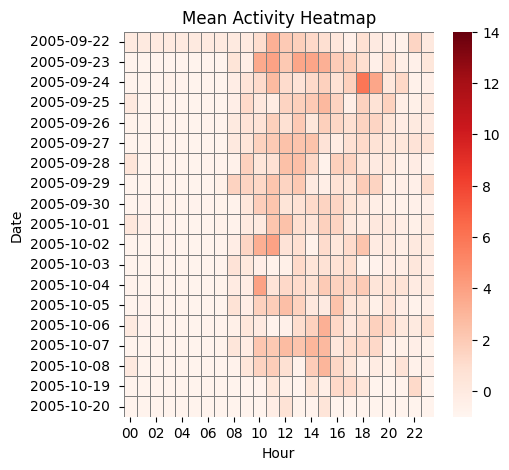

condition 17
83.88986642376167 18.170832371138548 0.21660342477302702


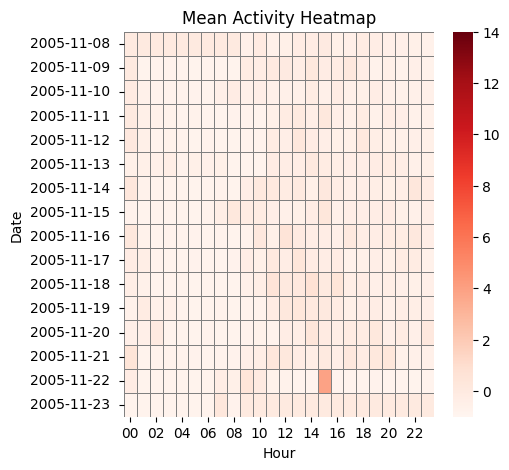

condition 18
69.79829791703118 18.706268990368663 0.2680046584030558


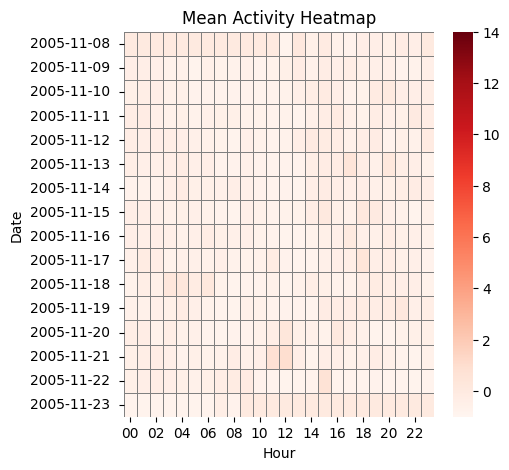

condition 19
161.6688425925926 69.76502045317771 0.4315304008762306


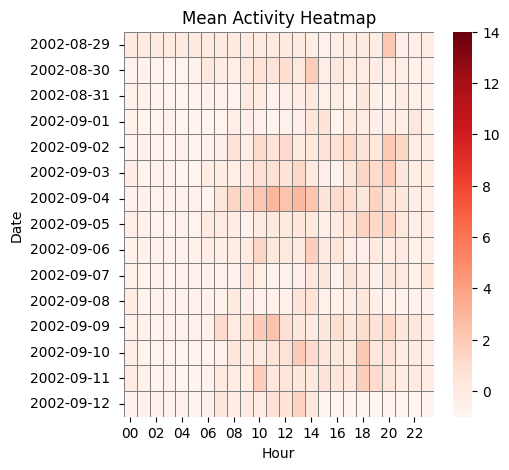

condition 20
69.48783518518518 23.377406776184483 0.3364244506089974


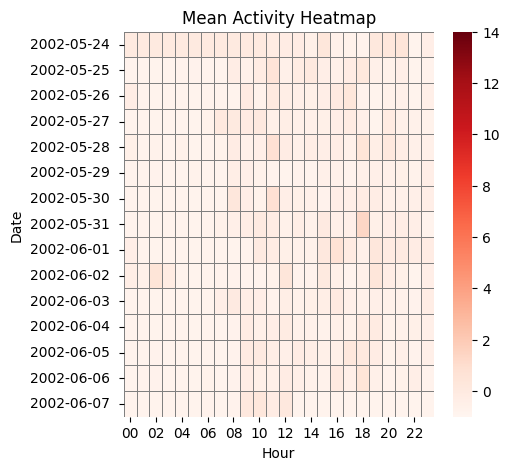

condition 21
80.34618077706429 20.860040415914124 0.25962703160457945


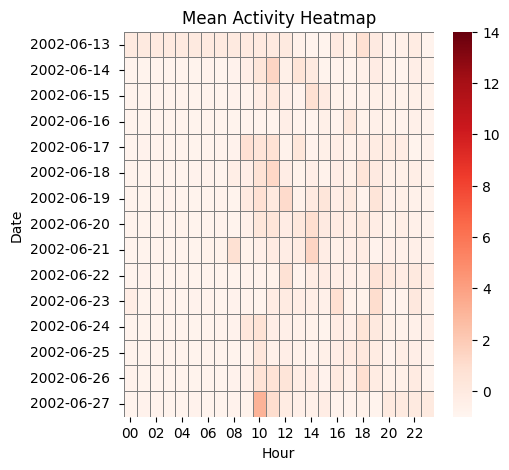

condition 22
161.58069405833902 43.171804506657715 0.2671841754255026


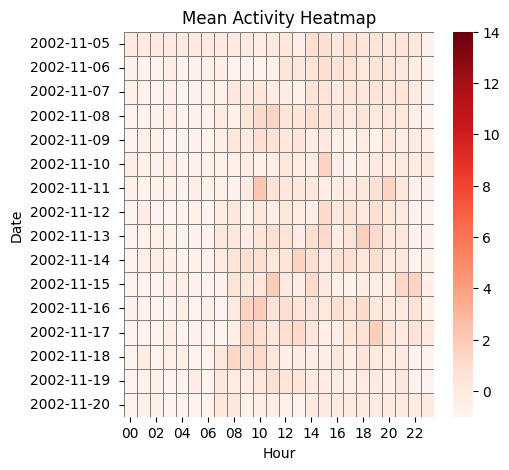

condition 23
261.01777146464644 84.48967655978542 0.3236931956230004


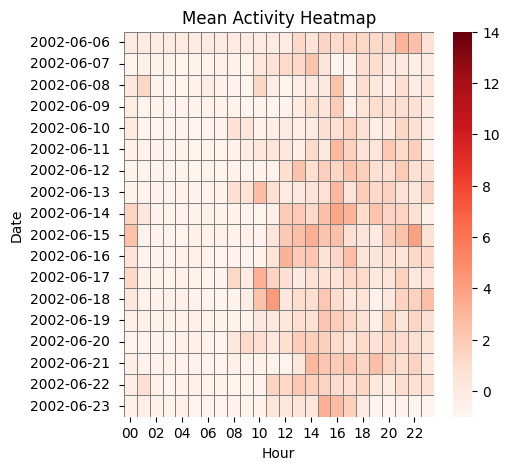

In [340]:
condition_meanList =[]
condition_stdList=[]
condition_cvList=[]
condition_days=[]

all_condition_data=pd.DataFrame()

for i in range(1,24):
    control= pd.read_csv(data_path + f'condition/condition_{i}.csv')
    control['timestamp'] = pd.to_datetime(control['timestamp'])
    control['hour']=control['timestamp'].dt.strftime('%H')
    control_bydate = control.groupby(['date'], as_index=False).agg(
        n=pd.NamedAgg(column='activity', aggfunc='count'),
        mean_activity=pd.NamedAgg(column='activity', aggfunc='mean')
    )
#removing days with irrationally low average daily activity. 
    control_bydate= control_bydate[control_bydate.mean_activity>10]
    """
        Mixed effects modeling can handle Missing At Random (MAR) data, such as when the first and last days have missing data. 
        In this context, we know that the missing data on these days is due to individuals either wearing or removing their actigraph during those times, on account of completion of measurement for study. 
        However, this explanation doesn't apply to days in between when the actigraph is not recording data since we do not know why individuasls/actigraph stopped recording (MNAR)
    """
    control_bydate = control_bydate[(control_bydate.index==0) | (control_bydate.n==1440) | (control_bydate.index== len(control_bydate)-1)]
    mask = control['date'].isin(control_bydate['date'])
    control=control[mask]
    control['hour']=control['hour'].astype(str)
    control['date_hour']= control['date']+' '+control['hour']
    print(f'condition {i}')
    #print(control_bydate)

    #extracting mean and std of daily means 
    daily_means = control_bydate.mean_activity.mean()
    daily_std = control_bydate.mean_activity.std()
    daily_cv = daily_std/daily_means
    print(daily_means, daily_std, daily_cv)

    condition_meanList.append(daily_means)
    condition_stdList.append(daily_std)
    condition_cvList.append(daily_cv)
    condition_days.append(len(control_bydate))



    control_byhour=control.groupby(['date_hour'], as_index=False).agg(
        n=pd.NamedAgg(column='activity', aggfunc='count'),
        mean_activity=pd.NamedAgg(column='activity', aggfunc='mean')
    )

    control_byhour['hour'] =control_byhour['date_hour'].str[-2:]
    control_byhour['date'] =control_byhour['date_hour'].str[:-2]

    if i==1:
        all_condition_data=control_byhour
    else:
        all_condition_data = pd.concat([all_condition_data, control_byhour], axis=0)
    
    
    # Z-score normalization
    control_byhour['normalized_mean_activity'] = (
    control_byhour['mean_activity'] - condition_mean) / condition_std
    pivot= control_byhour.pivot_table(index='date', columns='hour',values='normalized_mean_activity',fill_value=0)


    #print(control_byhour)

    plt.figure(figsize=(5, 5))
    sns.heatmap(pivot, cmap='Reds', vmin=-1, vmax=14,linewidths=0.5, linecolor='grey')
    plt.title('Mean Activity Heatmap')
    plt.xlabel('Hour')
    plt.ylabel('Date')
    plt.show()




Analyzing the heatmaps reveals common patterns such as reduced activity during late night and early morning hours for both the condition and control groups. Additionally, there is generally higher actigraph activity observed in the control group compared to the condition group, with a few exceptions.

In [298]:
control_stats = pd.DataFrame(zip(score_control.number, control_meanList, control_stdList, control_cvList, control_days), columns=['number', 'mean_meanActivity', 'std_meanActivity', 'coeff_of_var_meanActivity', 'days'])

In [299]:
control_stats.describe()

,mean_meanActivity,std_meanActivity,coeff_of_var_meanActivity,days
count,32.000000,32.000000,32.000000,32.00000
mean,263.335219,89.979675,0.341287,16.06250
std,69.875658,34.827473,0.085802,1.58496
min,141.170370,46.611457,0.159914,14.00000
25%,209.545840,58.258695,0.296317,15.00000
50%,268.096720,82.132169,0.343881,16.00000
75%,315.796024,122.989739,0.398385,16.00000
max,390.604948,158.408975,0.527108,23.00000


In [300]:
condition_stats = pd.DataFrame(zip(score_condition.number, condition_meanList, condition_stdList, condition_cvList, condition_days), columns=['number', 'mean_meanActivity', 'std_meanActivity', 'coeff_of_var_meanActivity', 'days'])

In [301]:
condition_stats.describe()

,mean_meanActivity,std_meanActivity,coeff_of_var_meanActivity,days
count,23.000000,23.000000,23.000000,23.000000
mean,176.856549,69.208635,0.380149,15.826087
std,72.077272,38.040645,0.108157,1.613922
min,69.487835,18.170832,0.216603,12.000000
25%,121.137657,44.300914,0.285603,15.000000
50%,164.672090,67.143558,0.374241,16.000000
75%,241.413997,84.527223,0.447498,16.000000
max,292.454797,169.746238,0.642844,20.000000


In [302]:
condition_stats['Group'] = 'Condition'
control_stats['Group'] = 'Control'
combined_stats = pd.concat([condition_stats, control_stats])

We notice a discrepancy in the average activity levels recorded by actigraphs between the condition and control groups, amounting to approximately 86.48 units. Despite the standard deviation, which indicates the absolute variation in data, showing notable differences between the two groups, the relative variability in relation to their means is fairly similiar, with only about a 10% difference. Additionally, both groups have a similar duration of data collection, averaging around 16 days for the control group and 15.82 days for the condition group.

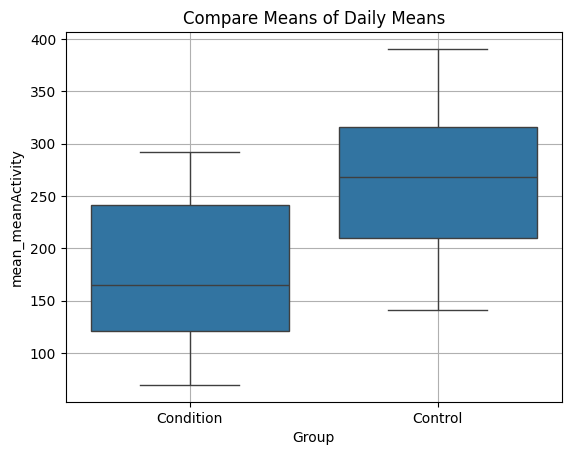

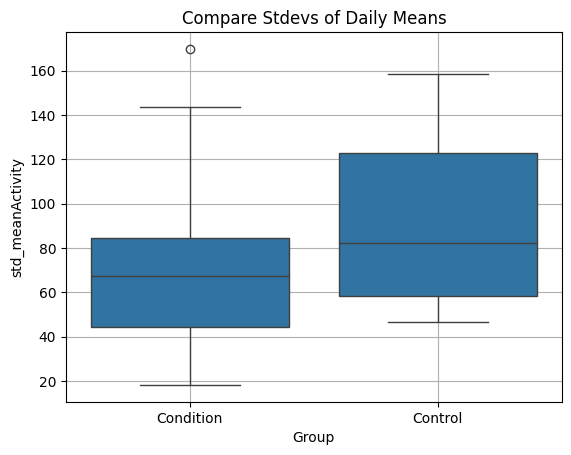

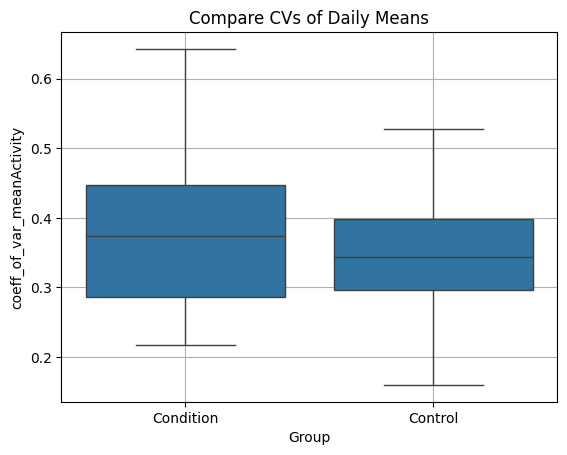

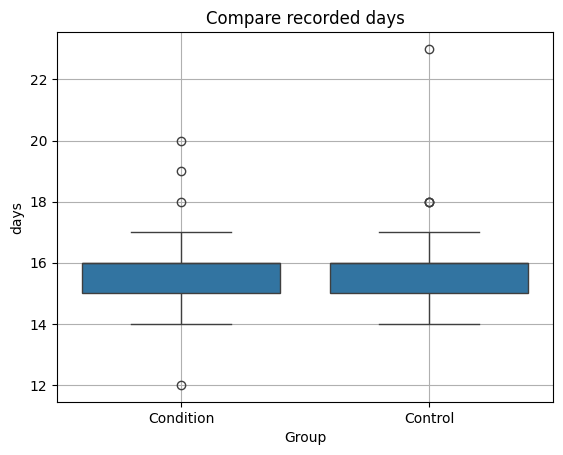

In [303]:
# compare means of daily means for the two groups
sns.boxplot(data=combined_stats, x='Group', y='mean_meanActivity')
plt.title('Compare Means of Daily Means')
plt.grid()
plt.show()

# compare stdevs of daily means
sns.boxplot(data=combined_stats, x='Group', y='std_meanActivity')
plt.title('Compare Stdevs of Daily Means')
plt.grid()
plt.show()

# compare CVs of daily means
sns.boxplot(data=combined_stats, x='Group', y='coeff_of_var_meanActivity')
plt.title('Compare CVs of Daily Means')
plt.grid()
plt.show()


# compare means of nnumber od recorded for the two groups
sns.boxplot(data=combined_stats, x='Group', y='days')
plt.title('Compare recorded days')
plt.grid()
plt.show()
